# **PREDICCIÓN DE CONVERSIÓN EN CAMPAÑAS DE MARKETING DIGITAL CON MACHINE LEARNING**
## **INTRODUCCIÓN DEL PROYECTO**

### **Tema del Proyecto:**  
El proyecto busca resolver un problema crucial en marketing digital: identificar qué usuarios tienen mayor probabilidad de conversión en campañas publicitarias. Utilizaremos un enfoque de Machine Learning para analizar un dataset que incluye 8000 registros y 20 variables relacionadas con clientes, campañas y comportamiento digital. Este modelo ayudará a optimizar decisiones estratégicas y mejorar el retorno de inversión.

---

### **Dataset:**  
[Predict Conversion in Digital Marketing](https://www.kaggle.com/datasets/rabieelkharoua/predict-conversion-in-digital-marketing-dataset/data)  
- **Registros:** 8000 (sin valores nulos).  
- **Columnas:** 20.  

---

#### **Variables principales:** 

**Demográficas:**  
- `Age`: Edad del cliente, una variable numérica que puede influir en los patrones de compra y conversión.  
- `Gender`: Género del cliente (`Male`, `Female`), relevante para segmentación de campañas.  
- `Income`: Ingresos anuales del cliente, en $, indicando su capacidad adquisitiva y preferencia por ciertos productos o servicios.  

**Campañas publicitarias:**  
- `CampaignChannel`: Canal de distribución de la campaña (`Social Media`, `Email`, `PPC`, `Referral`, `SEO`), proporcionando información sobre dónde se alcanzaron los clientes.  
- `CampaignType`: Tipo de campaña (`Awareness`, `Retention`, `Conversion`, `Consideration`), reflejando el propósito estratégico de la acción publicitaria.  
- `AdSpend`: Cantidad de dinero $ gastada en publicidad para cada cliente (valor continuo).  

**Interacciones digitales:**  
- `ClickThroughRate`: Porcentaje de clics que los clientes realizaron sobre los anuncios mostrados, un indicador de interés.  
- `ConversionRate`: Porcentaje de usuarios que completaron una acción específica tras interactuar con los anuncios.  
- `WebsiteVisits`: Número de visitas al sitio web, representando el nivel de interés generado.  
- `PagesPerVisit`: Número promedio de páginas vistas por visita al sitio, reflejando el grado de compromiso del usuario.  
- `TimeOnSite`: Tiempo promedio (en minutos) que los usuarios permanecieron en el sitio web, un indicador del interés y la exploración de contenido.  
- `SocialShares`: Cantidad de veces que los usuarios compartieron contenido de la campaña en redes sociales, indicando viralidad e impacto orgánico.  
- `EmailOpens`: Número de correos electrónicos abiertos por los usuarios, mostrando efectividad de las campañas de email marketing.  
- `EmailClicks`: Número de clics realizados dentro de correos electrónicos, reflejando el nivel de interés en los enlaces promocionados.  

**Historial del cliente:**  
- `PreviousPurchases`: Número de compras anteriores realizadas por el cliente, útil para identificar patrones de lealtad.  
- `LoyaltyPoints`: Puntos acumulados en programas de fidelización, un reflejo del compromiso del cliente con la marca.  

**Plataformas y herramientas:**  
- `AdvertisingPlatform`: Valor único en todo el dataset (`IsConfid`), descartado por falta de variabilidad.  
- `AdvertisingTool`: Valor único en todo el dataset (`ToolConfid`), descartado por falta de información relevante.  

**Target:**  
- **`Conversion`:** Variable objetivo binaria (Entendida como: realiza (1) o no (0) la acción deseada por la campaña de marketing):  
  - `1`: El cliente realizó la conversión.  
  - `0`: El cliente no realizó la conversión.  

---

#### **Datos clave del dataset:**  
- **ConversionRate promedio:** Aproximadamente el 10%, lo que destaca la necesidad de segmentar audiencias y optimizar campañas para mejorar esta métrica.  

---

### **Objetivo:**  
Desarrollar un modelo de clasificación binaria para predecir la probabilidad de conversión de cada cliente. Este modelo permitirá optimizar recursos publicitarios y diseñar estrategias más efectivas, priorizando canales y audiencias de mayor impacto.

---

### **Metodología:**  
1. **Exploración inicial de datos (EDA):**  
   - Limpieza de valores irrelevantes (`AdvertisingPlatform`, `AdvertisingTool`).  
   - Identificación de tendencias clave en las tasas de conversión y comportamientos digitales.  

2. **Prueba de Modelos:**  
   - Algoritmos como Random Forest, XGBoost y regresión logística serán evaluados.  
   - Métricas clave: Recall, ROC-AUC, F1-Score y precisión.  

3. **Optimización:**  
   - Feature engineering para transformar y generar variables adicionales.  
   - Selección del modelo final con el mejor balance entre precisión y sensibilidad.  

---

### **Impacto esperado:**  
- **Ahorro en costos:** Priorizar clientes con mayor probabilidad de conversión reducirá el gasto en campañas ineficientes.  
- **Mejora del ROI:** Identificar los canales y campañas más efectivos permitirá maximizar la rentabilidad de las inversiones.  
- **Toma de decisiones basada en datos:** El modelo guiará estrategias comerciales y publicitarias más informadas.

---

### **Siguientes pasos:**  
- Completar el análisis exploratorio y visualización de datos.  
- Entrenar y evaluar modelos para seleccionar el más robusto.  
- Presentar resultados y recomendaciones en términos de impacto comercial y viabilidad técnica.  


## **Install**

In [124]:
#!pip install imbalanced-learn
#!pip install shap

## **Imports**

In [125]:
# === Librerías estándar ===
import re  # Trabajo con expresiones regulares
import math  # Funciones matemáticas
import warnings  # Manejo de advertencias

# === Manipulación y análisis de datos ===
import pandas as pd  # Manejo y análisis de datos estructurados
import numpy as np  # Operaciones numéricas y manejo de arrays

# === Visualización ===
import matplotlib.pyplot as plt  # Creación de gráficos básicos
from mpl_toolkits.mplot3d import Axes3D  # Gráficos 3D
import seaborn as sns  # Gráficos estadísticos y estilos
sns.set_style('whitegrid')  # Estilo de gráficos para seaborn

# === Selección de modelos y preprocesamiento ===
from sklearn.model_selection import (
    train_test_split,  # División de datos en conjuntos de entrenamiento y prueba
    GridSearchCV,  # Búsqueda de hiperparámetros con validación cruzada
    StratifiedKFold,  # Validación cruzada estratificada
    RandomizedSearchCV  # Búsqueda de hiperparámetros aleatoria
)
from sklearn.preprocessing import StandardScaler, LabelEncoder  # Preprocesamiento
from sklearn.pipeline import Pipeline  # Construcción de pipelines para preprocesamiento y modelado

# === Manejo de desbalanceo de clases ===
from imblearn.combine import SMOTETomek  # SMOTE + Tomek Links para balanceo de datos
from imblearn.over_sampling import SMOTE  # SMOTE para sobremuestreo

# === Modelos de Machine Learning ===
from sklearn.ensemble import (
    RandomForestClassifier,  # Clasificador Random Forest
    GradientBoostingClassifier,  # Clasificador Gradient Boosting
    StackingClassifier,  # Clasificador basado en apilamiento
    RandomForestRegressor,  # Regresor Random Forest
    GradientBoostingRegressor  # Regresor Gradient Boosting
)
from xgboost import XGBClassifier, XGBRegressor  # Clasificador y regresor XGBoost

# === Métricas y evaluación ===
from sklearn.metrics import (
    classification_report,  # Reporte de métricas para clasificación
    confusion_matrix,  # Matriz de confusión
    ConfusionMatrixDisplay,  # Visualización de matriz de confusión
    roc_auc_score,  # Métrica AUC-ROC
    roc_curve,  # Curva ROC
    f1_score,  # F1-Score
    recall_score,  # Recall (Sensibilidad)
    precision_score,  # Precisión
    mean_absolute_error,  # MAE (Error absoluto medio) para regresión
    mean_squared_error  # MSE (Error cuadrático medio) para regresión
)

# === Clustering ===
from sklearn.cluster import KMeans  # Algoritmo de clustering K-Means
from sklearn.metrics import (
    silhouette_samples,  # Evaluación de silueta para cada punto
    silhouette_score  # Puntuación general de silueta para el modelo
)

# === Reducción de dimensionalidad ===
from sklearn.decomposition import PCA  # Análisis de componentes principales (PCA)

# === Utilidades ===
from sklearn.utils.class_weight import compute_class_weight  # Cálculo de pesos para clases desbalanceadas
import joblib  # Guardar y cargar modelos entrenados

## **Configuraciones**

In [126]:
# Mostrar todas las columnas de un DataFrame
pd.set_option('display.max_columns', None)

# Ignorar FutureWarnings
warnings.simplefilter(action='ignore', category=FutureWarning)

## **Carga de datos y primeras exploraciones**

In [127]:
# Cargar los datos
df = pd.read_csv('data/digital_marketing_campaign_dataset.csv')

In [128]:
# Exportar el DataFrame a un archivo Excel
#df.to_excel('digital_marketing_campaign_dataset.xlsx', index=False)

In [129]:
df.head(100)

,CustomerID,Age,Gender,Income,CampaignChannel,CampaignType,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,PagesPerVisit,TimeOnSite,SocialShares,EmailOpens,EmailClicks,PreviousPurchases,LoyaltyPoints,AdvertisingPlatform,AdvertisingTool,Conversion
0,8000,56,Female,136912,Social Media,Awareness,6497.870068,0.043919,0.088031,0,2.399017,7.396803,19,6,9,4,688,IsConfid,ToolConfid,1
1,8001,69,Male,41760,Email,Retention,3898.668606,0.155725,0.182725,42,2.917138,5.352549,5,2,7,2,3459,IsConfid,ToolConfid,1
2,8002,46,Female,88456,PPC,Awareness,1546.429596,0.277490,0.076423,2,8.223619,13.794901,0,11,2,8,2337,IsConfid,ToolConfid,1
3,8003,32,Female,44085,PPC,Conversion,539.525936,0.137611,0.088004,47,4.540939,14.688363,89,2,2,0,2463,IsConfid,ToolConfid,1
4,8004,60,Female,83964,PPC,Conversion,1678.043573,0.252851,0.109940,0,2.046847,13.993370,6,6,6,8,4345,IsConfid,ToolConfid,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,8095,42,Female,134479,PPC,Conversion,1772.907833,0.098736,0.152312,40,4.783479,5.087264,76,18,5,8,72,IsConfid,ToolConfid,1
96,8096,62,Female,77429,Referral,Awareness,7909.335039,0.055027,0.160091,0,4.022981,5.796379,52,11,0,3,3482,IsConfid,ToolConfid,1
97,8097,58,Male,23134,SEO,Retention,5091.776674,0.190800,0.030221,24,9.938338,1.303695,13,8,7,4,205,IsConfid,ToolConfid,1
98,8098,46,Female,130995,PPC,Conversion,5175.874779,0.180008,0.100499,15,7.901173,11.429444,9,5,0,4,2595,IsConfid,ToolConfid,1


In [130]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   CustomerID           8000 non-null   int64  
 1   Age                  8000 non-null   int64  
 2   Gender               8000 non-null   object 
 3   Income               8000 non-null   int64  
 4   CampaignChannel      8000 non-null   object 
 5   CampaignType         8000 non-null   object 
 6   AdSpend              8000 non-null   float64
 7   ClickThroughRate     8000 non-null   float64
 8   ConversionRate       8000 non-null   float64
 9   WebsiteVisits        8000 non-null   int64  
 10  PagesPerVisit        8000 non-null   float64
 11  TimeOnSite           8000 non-null   float64
 12  SocialShares         8000 non-null   int64  
 13  EmailOpens           8000 non-null   int64  
 14  EmailClicks          8000 non-null   int64  
 15  PreviousPurchases    8000 non-null   i

In [131]:
df.describe()

,CustomerID,Age,Income,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,PagesPerVisit,TimeOnSite,SocialShares,EmailOpens,EmailClicks,PreviousPurchases,LoyaltyPoints,Conversion
count,8000.00000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000
mean,11999.50000,43.625500,84664.196750,5000.944830,0.154829,0.104389,24.751625,5.549299,7.727718,49.799750,9.476875,4.467375,4.485500,2490.268500,0.876500
std,2309.54541,14.902785,37580.387945,2838.038153,0.084007,0.054878,14.312269,2.607358,4.228218,28.901165,5.711111,2.856564,2.888093,1429.527162,0.329031
min,8000.00000,18.000000,20014.000000,100.054813,0.010005,0.010018,0.000000,1.000428,0.501669,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,9999.75000,31.000000,51744.500000,2523.221165,0.082635,0.056410,13.000000,3.302479,4.068340,25.000000,5.000000,2.000000,2.000000,1254.750000,1.000000
50%,11999.50000,43.000000,84926.500000,5013.440044,0.154505,0.104046,25.000000,5.534257,7.682956,50.000000,9.000000,4.000000,4.000000,2497.000000,1.000000
75%,13999.25000,56.000000,116815.750000,7407.989369,0.228207,0.152077,37.000000,7.835756,11.481468,75.000000,14.000000,7.000000,7.000000,3702.250000,1.000000
max,15999.00000,69.000000,149986.000000,9997.914781,0.299968,0.199995,49.000000,9.999055,14.995311,99.000000,19.000000,9.000000,9.000000,4999.000000,1.000000


In [132]:
# Iterar por cada columna y obtener los valores únicos
unique_values = {col: df[col].unique() for col in df.columns}

# Mostrar los valores únicos de cada columna
for column, values in unique_values.items():
    print(f"Columna: {column}")
    print(f"Valores únicos: {values}")
    print("-" * 50)

Columna: CustomerID
Valores únicos: [ 8000  8001  8002 ... 15997 15998 15999]
--------------------------------------------------
Columna: Age
Valores únicos: [56 69 46 32 60 25 38 36 40 28 41 53 57 20 39 19 61 47 55 50 29 42 66 44
 59 45 33 64 68 54 24 26 35 21 31 67 43 37 52 34 23 51 27 48 65 62 58 18
 22 30 49 63]
--------------------------------------------------
Columna: Gender
Valores únicos: ['Female' 'Male']
--------------------------------------------------
Columna: Income
Valores únicos: [136912  41760  88456 ...  24849 125471 107862]
--------------------------------------------------
Columna: CampaignChannel
Valores únicos: ['Social Media' 'Email' 'PPC' 'Referral' 'SEO']
--------------------------------------------------
Columna: CampaignType
Valores únicos: ['Awareness' 'Retention' 'Conversion' 'Consideration']
--------------------------------------------------
Columna: AdSpend
Valores únicos: [6497.87006842 3898.66860568 1546.4295958  ... 4609.53463542 9476.10635405
 7743.6

In [133]:
df.nunique()

CustomerID             8000
Age                      52
Gender                    2
Income                 7789
CampaignChannel           5
CampaignType              4
AdSpend                8000
ClickThroughRate       8000
ConversionRate         8000
WebsiteVisits            50
PagesPerVisit          8000
TimeOnSite             8000
SocialShares            100
EmailOpens               20
EmailClicks              10
PreviousPurchases        10
LoyaltyPoints          3983
AdvertisingPlatform       1
AdvertisingTool           1
Conversion                2
dtype: int64

In [134]:
# Iterar por cada columna y mostrar los value_counts
for col in df.columns:
    print(f"Columna: {col}")
    print(df[col].value_counts())
    print("-" * 50)

Columna: CustomerID
CustomerID
15983    1
15982    1
15981    1
15980    1
15979    1
        ..
8004     1
8003     1
8002     1
8001     1
8000     1
Name: count, Length: 8000, dtype: int64
--------------------------------------------------
Columna: Age
Age
64    187
62    182
66    178
43    178
34    177
49    173
45    173
52    172
40    170
42    167
39    165
46    165
25    162
38    162
21    160
54    160
30    157
57    157
32    157
37    156
68    155
51    155
35    155
23    154
36    153
28    153
41    151
20    151
47    150
61    150
19    150
50    149
53    149
18    148
33    148
31    148
29    148
56    147
69    147
59    146
58    144
55    143
26    143
63    140
60    139
22    139
67    137
65    137
27    136
24    129
44    128
48    120
Name: count, dtype: int64
--------------------------------------------------
Columna: Gender
Gender
Female    4839
Male      3161
Name: count, dtype: int64
--------------------------------------------------
Columna: Inco

## **Limpieza de datos**

In [135]:
# Eliminar columnas irrelevantes
df = df.drop(columns=['AdvertisingPlatform', 'AdvertisingTool'])

In [136]:
# Identificar duplicados
duplicados = df.duplicated()
print(f"Número de filas duplicadas: {duplicados.sum()}")

# Mostrar filas duplicadas
if duplicados.sum() > 0:
    print("Filas duplicadas:")
    print(df[duplicados])

# Eliminar duplicados si SE encuentran
df = df.drop_duplicates()

# Verificar que se eliminaron los duplicados
print(f"Número de filas después de eliminar duplicados: {df.shape[0]}")

Número de filas duplicadas: 0
Número de filas después de eliminar duplicados: 8000


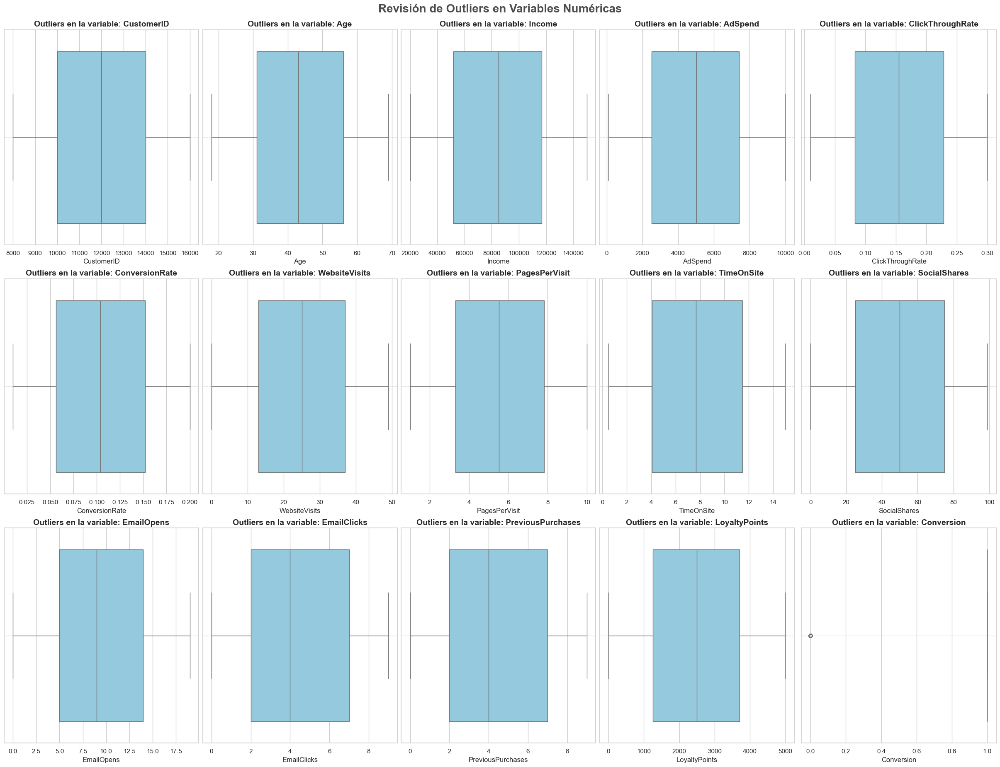

In [137]:
# Filtrar las variables numéricas
variables_numericas = df.select_dtypes(include=['int64', 'float64']).columns

# Número de columnas por fila
columns_per_row = 5

# Número total de variables numéricas
total_variables = len(variables_numericas)

# Número de filas necesarias
rows = math.ceil(total_variables / columns_per_row)

# Crear subplots
fig, axes = plt.subplots(rows, columns_per_row, figsize=(24, rows * 6), constrained_layout=True)
axes = axes.flatten()

# Crear boxplots
for i, var in enumerate(variables_numericas):
    sns.boxplot(data=df, x=var, ax=axes[i], color="skyblue")
    axes[i].set_title(f"Outliers en la variable: {var}", fontsize=14, fontweight='bold')
    axes[i].set_xlabel(var, fontsize=12)
    axes[i].grid(axis='y', linestyle='--', alpha=0.7)

# Ajustar los ejes vacíos
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Título general
fig.suptitle('Revisión de Outliers en Variables Numéricas', fontsize=20, fontweight='bold', color="#4c4c4c", y=1.02)

plt.show()

## **EDA**

### **Distribución de variables**

C:\Users\mikel\AppData\Local\Temp\ipykernel_16516\3551082037.py:31: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax, palette=palette)
C:\Users\mikel\AppData\Local\Temp\ipykernel_16516\3551082037.py:31: UserWarning: The palette list has more values (10) than needed (5), which may not be intended.
  sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax, palette=palette)
C:\Users\mikel\AppData\Local\Temp\ipykernel_16516\3551082037.py:31: UserWarning: The palette list has more values (10) than needed (4), which may not be intended.
  sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax, palette=palette)


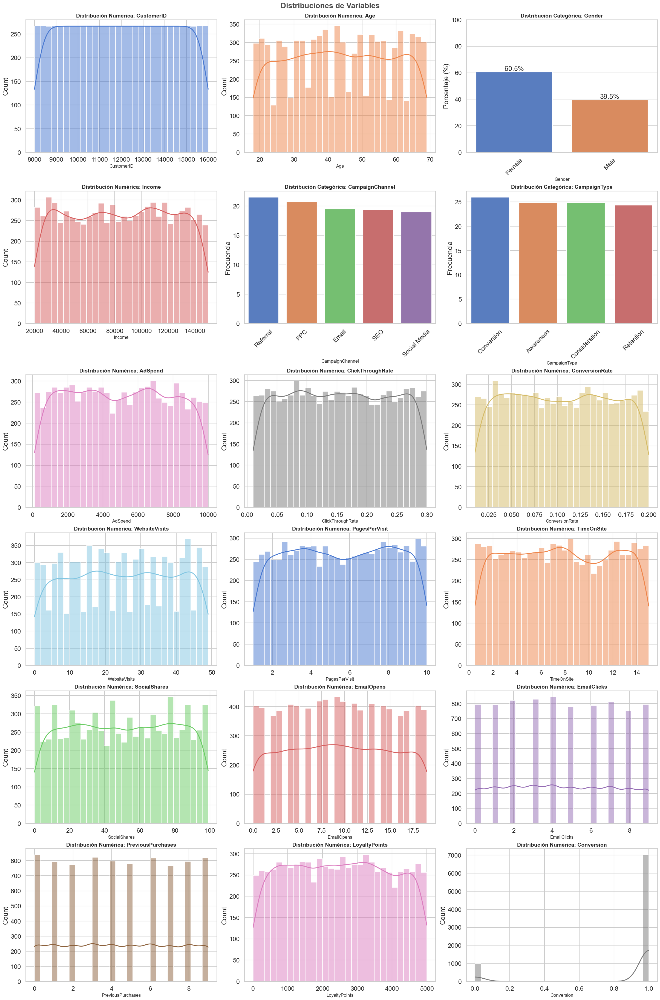

In [138]:
# Configuración general
sns.set_theme(style="whitegrid")
sns.set_context("talk")

# Número de columnas por fila
columns_per_row = 3

# Número total de columnas
total_columns = len(df.columns)

# Número de filas necesarias
rows = math.ceil(total_columns / columns_per_row)

# Crear subplots
fig, axes = plt.subplots(rows, columns_per_row, figsize=(24, rows * 6), constrained_layout=True)
axes = axes.flatten()

# Colores personalizados
palette = sns.color_palette("muted")

# Visualizar cada columna
for i, column in enumerate(df.columns):
    ax = axes[i]
    if df[column].dtype in ['int64', 'float64']:
        # Variables numéricas
        sns.histplot(df[column], kde=True, bins=30, ax=ax, color=palette[i % len(palette)])
        ax.set_title(f'Distribución Numérica: {column}', fontsize=14, fontweight='bold')
    elif df[column].dtype == 'object' or df[column].dtype == 'bool':
        # Variables categóricas
        value_counts = df[column].value_counts(normalize=True) * 100  # Porcentajes
        sns.barplot(x=value_counts.index, y=value_counts.values, ax=ax, palette=palette)
        ax.set_title(f'Distribución Categórica: {column}', fontsize=14, fontweight='bold')
        ax.set_ylabel('Porcentaje (%)' if column == "Gender" else 'Frecuencia')
        ax.set_ylim(0, 100 if column == "Gender" else None)
        
        # Agregar etiquetas de porcentaje solo para 'Gender'
        if column == "Gender":
            for container in ax.containers:
                ax.bar_label(container, fmt='%.1f%%')
        
        ax.tick_params(axis='x', rotation=45)
    ax.set_xlabel(column, fontsize=12)

# Ajustar los ejes vacíos
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Título general
fig.suptitle('Distribuciones de Variables', fontsize=20, fontweight='bold', color="#4c4c4c", y=1.01)

plt.show()

### **Pairplot**

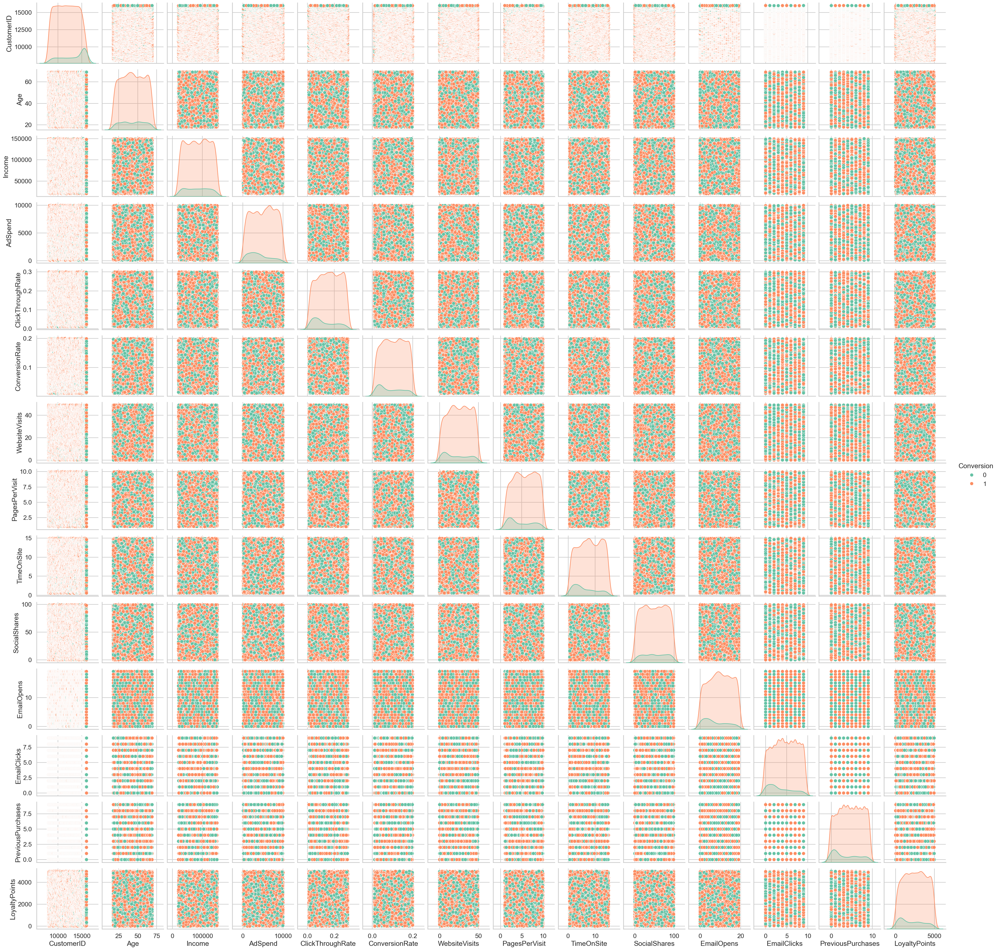

In [139]:
# Crear el pairplot
sns.pairplot(
    df, 
    hue="Conversion",  # Diferenciar por la variable objetivo
    #diag_kind="kde",   # Gráficos de densidad en la diagonal
    palette="Set2",    # Paleta de colores
    #corner=True        # Mostrar sólo la mitad inferior
)

# Mostrar el gráfico
plt.show()

### **Matriz de correlación variables númericas**

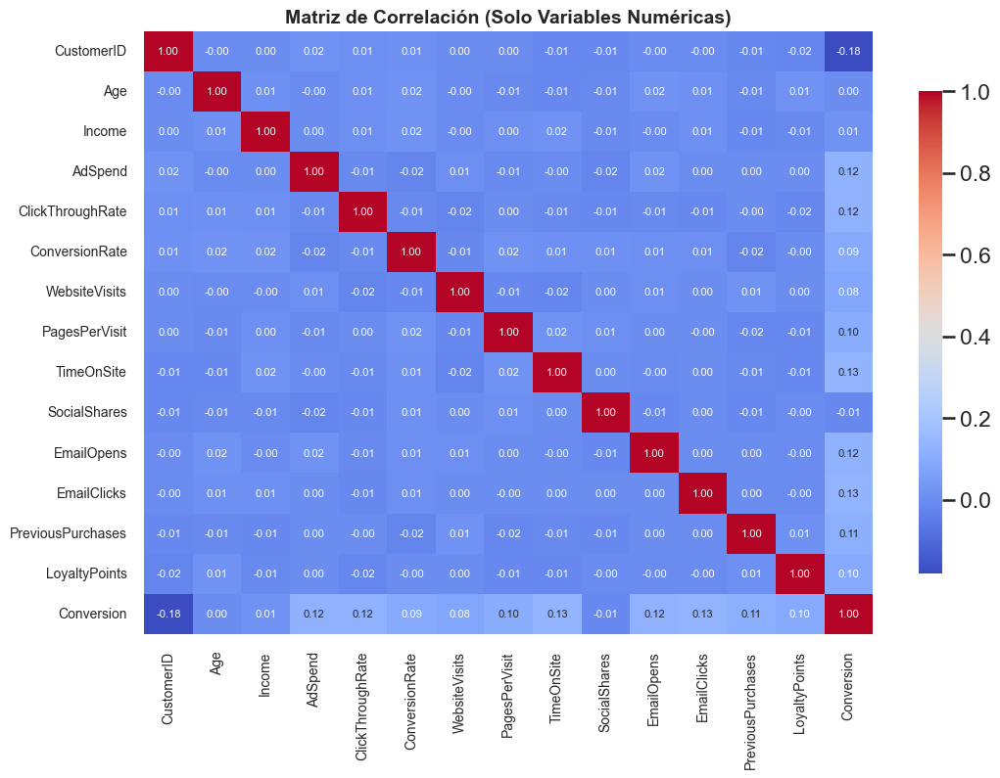

In [140]:
# Seleccionar solo columnas numéricas
numerical_df = df.select_dtypes(include=['int64', 'float64'])

# Calcular la matriz de correlación
correlation_matrix = numerical_df.corr()

# Mapa de calor con texto y números más pequeños
plt.figure(figsize=(12, 8))
sns.heatmap(
    correlation_matrix,
    annot=True,
    fmt='.2f',
    cmap='coolwarm',
    annot_kws={"size": 8},  # Tamaño del texto en los números
    cbar_kws={"shrink": 0.8}  # Reducir la barra de color
)
plt.title('Matriz de Correlación (Solo Variables Numéricas)', fontsize=14, weight='bold')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.show()

### **Relación variables categóricas**

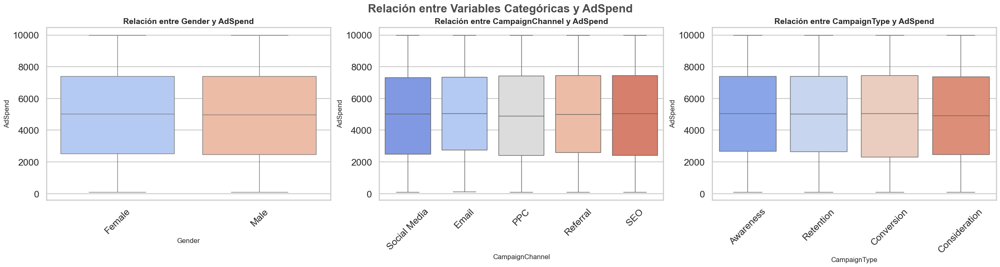

In [141]:
# Variables categóricas a explorar
categorical_vars = ['Gender', 'CampaignChannel', 'CampaignType']

# Variable numérica a analizar
numeric_var = 'AdSpend'

# Número de gráficos por fila
columns_per_row = 3

# Número total de variables categóricas
total_variables = len(categorical_vars)

# Número de filas necesarias
rows = math.ceil(total_variables / columns_per_row)

# Crear subplots
fig, axes = plt.subplots(rows, columns_per_row, figsize=(24, rows * 6), constrained_layout=True)
axes = axes.flatten()

# Generar boxplots
for i, cat_var in enumerate(categorical_vars):
    sns.boxplot(data=df, x=cat_var, y=numeric_var, ax=axes[i], palette='coolwarm')
    axes[i].set_title(f'Relación entre {cat_var} y {numeric_var}', fontsize=14, fontweight='bold')
    axes[i].set_xlabel(cat_var, fontsize=12)
    axes[i].set_ylabel(numeric_var, fontsize=12)
    axes[i].tick_params(axis='x', rotation=45)

# Eliminar ejes vacíos si los hay
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Título general
fig.suptitle('Relación entre Variables Categóricas y AdSpend', fontsize=20, fontweight='bold', color='#4c4c4c', y=1.05)

plt.show()

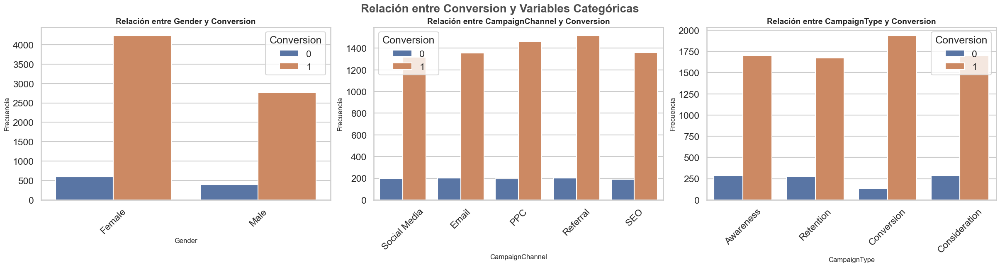

In [142]:
# Variables categóricas a explorar
categorical_vars = ['Gender', 'CampaignChannel', 'CampaignType']

# Número de gráficos por fila
columns_per_row = 3

# Número total de variables categóricas
total_variables = len(categorical_vars)

# Número de filas necesarias
rows = math.ceil(total_variables / columns_per_row)

# Crear subplots
fig, axes = plt.subplots(rows, columns_per_row, figsize=(24, rows * 6), constrained_layout=True)
axes = axes.flatten()

# Generar countplots
for i, cat_var in enumerate(categorical_vars):
    sns.countplot(data=df, x=cat_var, hue='Conversion', ax=axes[i])
    axes[i].set_title(f'Relación entre {cat_var} y Conversion', fontsize=14, fontweight='bold')
    axes[i].set_xlabel(cat_var, fontsize=12)
    axes[i].set_ylabel('Frecuencia', fontsize=12)
    axes[i].tick_params(axis='x', rotation=45)

# Eliminar ejes vacíos si los hay
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Título general
fig.suptitle('Relación entre Conversion y Variables Categóricas', fontsize=20, fontweight='bold', color='#4c4c4c', y=1.05)

plt.show()

### **Codificación de variables categóricas**

In [143]:
# Columnas categóricas a codificar
categorical_columns = ['Gender', 'CampaignChannel', 'CampaignType']

# Aplicar One-Hot Encoding
df_encoded = pd.get_dummies(df, columns=categorical_columns, drop_first=False)

# Convertir todos los valores True/False a 1/0 en el DataFrame
df_encoded = df_encoded.applymap(lambda x: 1 if x is True else 0 if x is False else x)

In [144]:
# Verificar las nuevas columnas codificadas
df_encoded.head()

,CustomerID,Age,Income,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,PagesPerVisit,TimeOnSite,SocialShares,EmailOpens,EmailClicks,PreviousPurchases,LoyaltyPoints,Conversion,Gender_Female,Gender_Male,CampaignChannel_Email,CampaignChannel_PPC,CampaignChannel_Referral,CampaignChannel_SEO,CampaignChannel_Social Media,CampaignType_Awareness,CampaignType_Consideration,CampaignType_Conversion,CampaignType_Retention
0,8000,56,136912,6497.870068,0.043919,0.088031,0,2.399017,7.396803,19,6,9,4,688,1,1,0,0,0,0,0,1,1,0,0,0
1,8001,69,41760,3898.668606,0.155725,0.182725,42,2.917138,5.352549,5,2,7,2,3459,1,0,1,1,0,0,0,0,0,0,0,1
2,8002,46,88456,1546.429596,0.277490,0.076423,2,8.223619,13.794901,0,11,2,8,2337,1,1,0,0,1,0,0,0,1,0,0,0
3,8003,32,44085,539.525936,0.137611,0.088004,47,4.540939,14.688363,89,2,2,0,2463,1,1,0,0,1,0,0,0,0,0,1,0
4,8004,60,83964,1678.043573,0.252851,0.109940,0,2.046847,13.993370,6,6,6,8,4345,1,1,0,0,1,0,0,0,0,0,1,0


In [145]:
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 26 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   CustomerID                    8000 non-null   int64  
 1   Age                           8000 non-null   int64  
 2   Income                        8000 non-null   int64  
 3   AdSpend                       8000 non-null   float64
 4   ClickThroughRate              8000 non-null   float64
 5   ConversionRate                8000 non-null   float64
 6   WebsiteVisits                 8000 non-null   int64  
 7   PagesPerVisit                 8000 non-null   float64
 8   TimeOnSite                    8000 non-null   float64
 9   SocialShares                  8000 non-null   int64  
 10  EmailOpens                    8000 non-null   int64  
 11  EmailClicks                   8000 non-null   int64  
 12  PreviousPurchases             8000 non-null   int64  
 13  Loy

In [146]:
df_encoded.describe()

,CustomerID,Age,Income,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,PagesPerVisit,TimeOnSite,SocialShares,EmailOpens,EmailClicks,PreviousPurchases,LoyaltyPoints,Conversion,Gender_Female,Gender_Male,CampaignChannel_Email,CampaignChannel_PPC,CampaignChannel_Referral,CampaignChannel_SEO,CampaignChannel_Social Media,CampaignType_Awareness,CampaignType_Consideration,CampaignType_Conversion,CampaignType_Retention
count,8000.00000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.00000,8000.000000,8000.00000,8000.00000,8000.000000,8000.000000
mean,11999.50000,43.625500,84664.196750,5000.944830,0.154829,0.104389,24.751625,5.549299,7.727718,49.799750,9.476875,4.467375,4.485500,2490.268500,0.876500,0.604875,0.395125,0.194625,0.206875,0.214875,0.19375,0.189875,0.24850,0.24850,0.259625,0.243375
std,2309.54541,14.902785,37580.387945,2838.038153,0.084007,0.054878,14.312269,2.607358,4.228218,28.901165,5.711111,2.856564,2.888093,1429.527162,0.329031,0.488908,0.488908,0.395936,0.405090,0.410761,0.39526,0.392227,0.43217,0.43217,0.438456,0.429146
min,8000.00000,18.000000,20014.000000,100.054813,0.010005,0.010018,0.000000,1.000428,0.501669,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.00000,0.000000,0.000000
25%,9999.75000,31.000000,51744.500000,2523.221165,0.082635,0.056410,13.000000,3.302479,4.068340,25.000000,5.000000,2.000000,2.000000,1254.750000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.00000,0.000000,0.000000
50%,11999.50000,43.000000,84926.500000,5013.440044,0.154505,0.104046,25.000000,5.534257,7.682956,50.000000,9.000000,4.000000,4.000000,2497.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.00000,0.000000,0.000000
75%,13999.25000,56.000000,116815.750000,7407.989369,0.228207,0.152077,37.000000,7.835756,11.481468,75.000000,14.000000,7.000000,7.000000,3702.250000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.00000,1.000000,0.000000
max,15999.00000,69.000000,149986.000000,9997.914781,0.299968,0.199995,49.000000,9.999055,14.995311,99.000000,19.000000,9.000000,9.000000,4999.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.000000,1.00000,1.00000,1.000000,1.000000


### **Matriz de correlación con todas las variables codificadas**

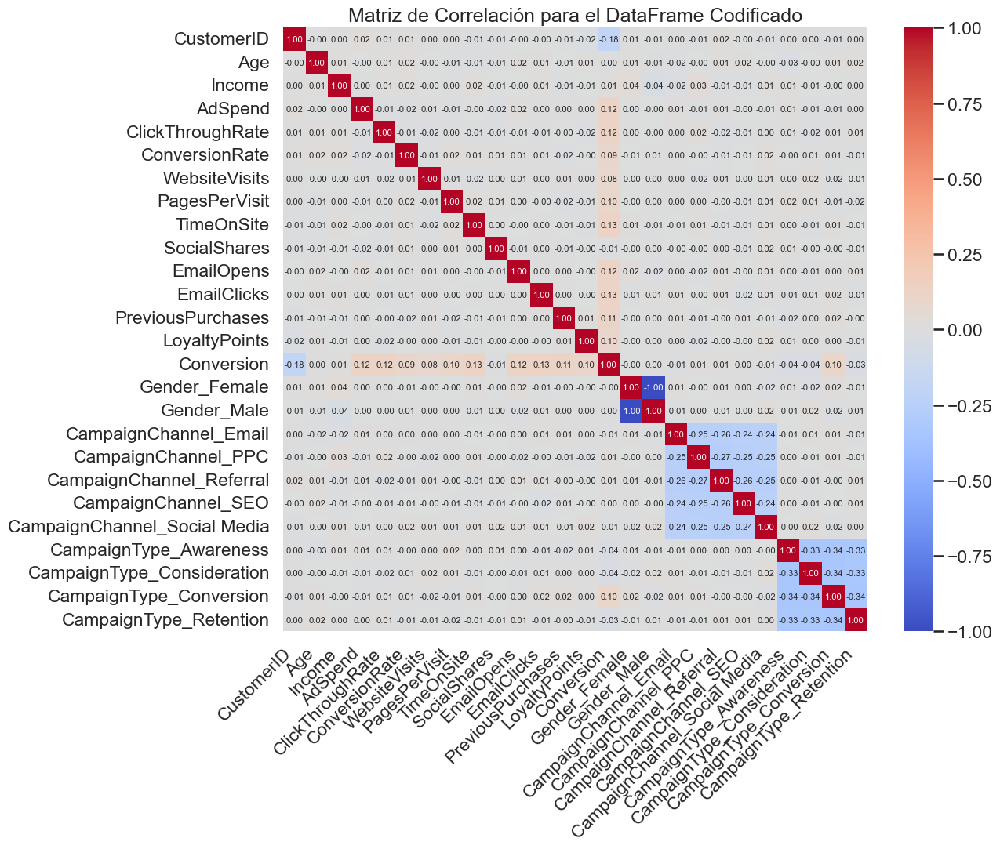

In [147]:
# Calcular la matriz de correlación
correlation_matrix = df_encoded.corr()

# Visualizar la matriz de correlación con números
plt.figure(figsize=(12, 10))
sns.heatmap(
    correlation_matrix,
    annot=True,
    cmap='coolwarm',
    fmt='.2f',
    annot_kws={"size": 8}
)

# Rotar las etiquetas del eje X 45 grados
plt.xticks(rotation=45, ha='right')  # ha='right' para alinearlas a la derecha
plt.title('Matriz de Correlación para el DataFrame Codificado')
plt.show()

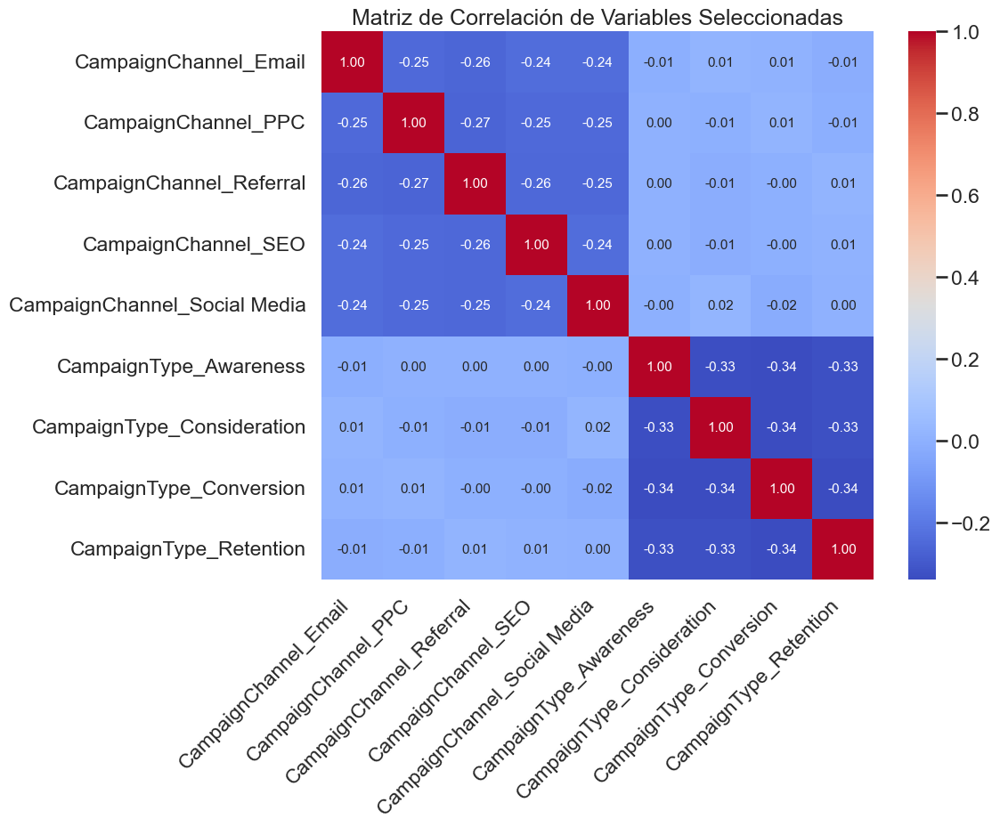

In [148]:
# Seleccionar las columnas específicas
selected_columns = [
    'CampaignChannel_Email', 'CampaignChannel_PPC', 'CampaignChannel_Referral',
    'CampaignChannel_SEO', 'CampaignChannel_Social Media',
    'CampaignType_Awareness', 'CampaignType_Consideration',
    'CampaignType_Conversion', 'CampaignType_Retention'
]

# Filtrar el DataFrame para incluir solo estas columnas
filtered_df = df_encoded[selected_columns]

# Calcular la matriz de correlación
correlation_matrix = filtered_df.corr()

# Visualizar la matriz de correlación
plt.figure(figsize=(10, 8))
sns.heatmap(
    correlation_matrix, 
    annot=True, 
    cmap='coolwarm', 
    fmt='.2f', 
    annot_kws={"size": 11}
)

# Rotar las etiquetas del eje X 45 grados
plt.xticks(rotation=45, ha='right')  # Girar etiquetas y alinearlas a la derecha
plt.title('Matriz de Correlación de Variables Seleccionadas')
plt.show()

C:\Users\mikel\AppData\Local\Temp\ipykernel_16516\951904113.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Conversion'] = df_encoded['Conversion']  # Añadir la variable objetivo


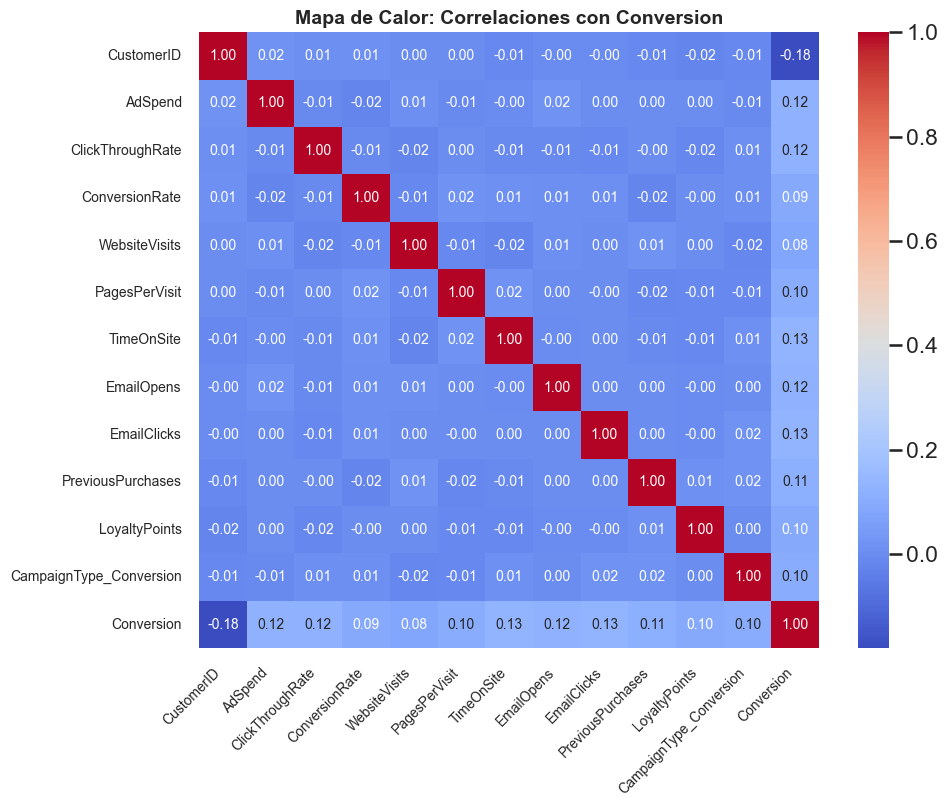

In [149]:
# Calcular la matriz de correlación
correlation_matrix = df_encoded.corr()

# Seleccionar las correlaciones con la variable objetivo 'Conversion'
correlations_with_target = correlation_matrix['Conversion'].drop('Conversion')

# Filtrar las variables con correlación > |0.1|
selected_features = correlations_with_target[abs(correlations_with_target) > 0.05].index

# Crear un DataFrame con las variables seleccionadas
df_filtered = df_encoded[selected_features]
df_filtered['Conversion'] = df_encoded['Conversion']  # Añadir la variable objetivo

# Crear el mapa de calor
plt.figure(figsize=(10, 8))
heatmap = sns.heatmap(
    df_filtered.corr(),
    annot=True,
    fmt=".2f",
    annot_kws={"size": 10},  # Reducir el tamaño de los números
    cmap="coolwarm",
    cbar=True
)

# Ajustar las etiquetas del eje X
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.yticks(fontsize=10)
plt.title("Mapa de Calor: Correlaciones con Conversion", fontsize=14, fontweight="bold")
plt.show()

### **Feature Importances**

C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\xgboost\core.py:158: UserWarning: [12:26:56] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0ed59c031377d09b8-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


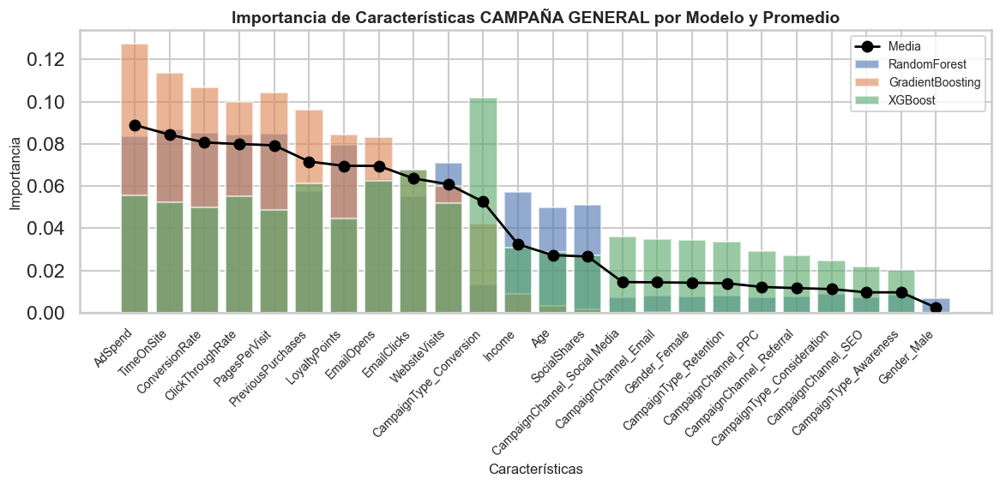

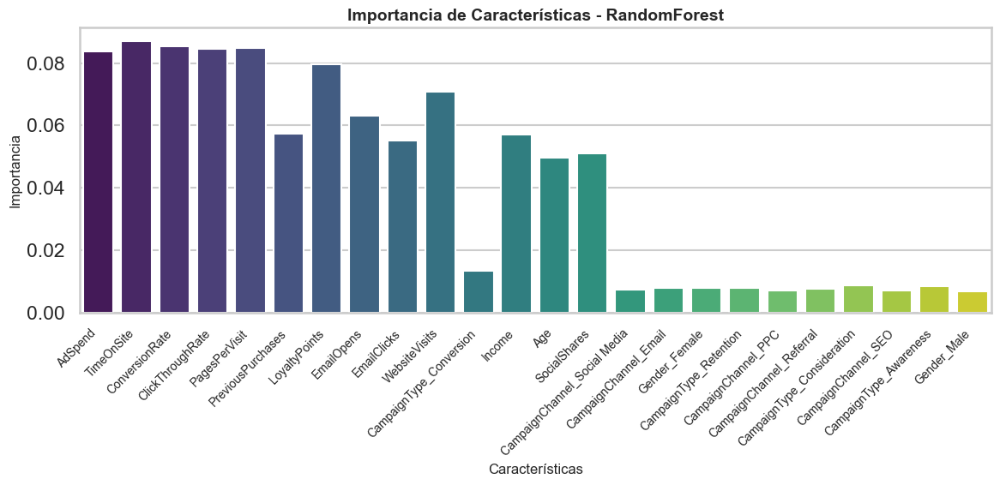

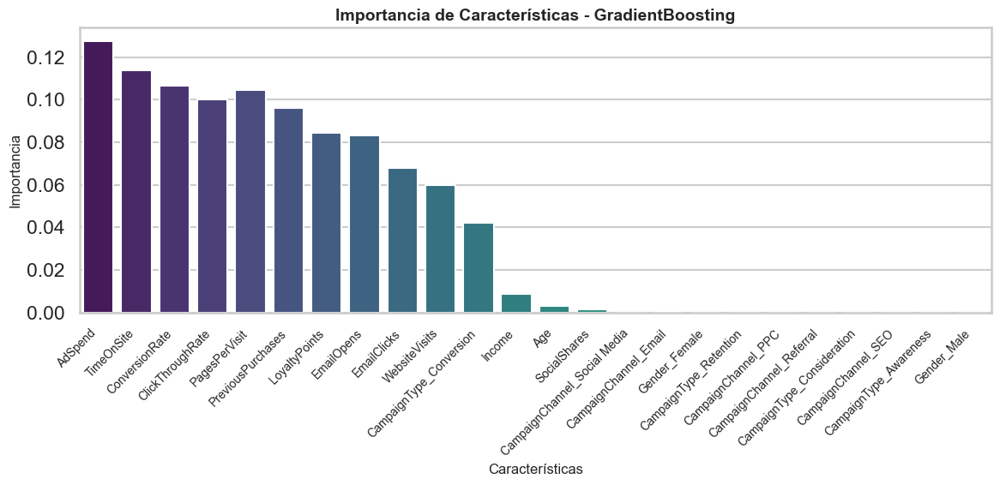

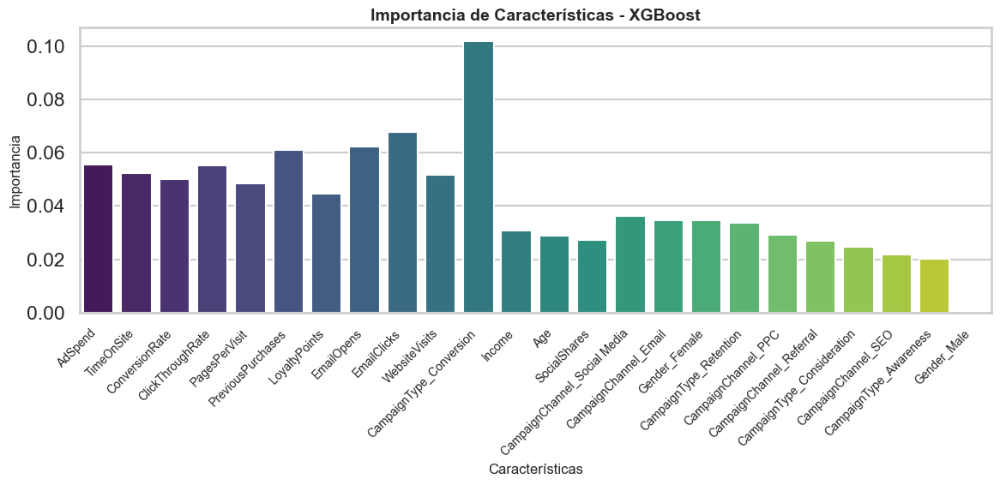

Tabla de Importancias:
                              RandomForest  GradientBoosting   XGBoost  \
AdSpend                           0.083679      1.274742e-01  0.055600   
TimeOnSite                        0.087030      1.137714e-01  0.052257   
ConversionRate                    0.085287      1.066993e-01  0.050030   
ClickThroughRate                  0.084508      9.995577e-02  0.055226   
PagesPerVisit                     0.084894      1.044235e-01  0.048621   
PreviousPurchases                 0.057507      9.621865e-02  0.061082   
LoyaltyPoints                     0.079578      8.458579e-02  0.044560   
EmailOpens                        0.063134      8.310349e-02  0.062417   
EmailClicks                       0.055275      6.786491e-02  0.067645   
WebsiteVisits                     0.070845      5.993758e-02  0.051717   
CampaignType_Conversion           0.013449      4.231524e-02  0.101807   
Income                            0.057237      8.944193e-03  0.030890   
Age            

In [150]:
# Variables predictoras y objetivo
X = df_encoded.drop(columns=['Conversion', 'CustomerID'])
y = df_encoded['Conversion']

# Modelos a usar
models = {
    "RandomForest": RandomForestClassifier(random_state=42),
    "GradientBoosting": GradientBoostingClassifier(random_state=42),
    "XGBoost": XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')
}

# Entrenar cada modelo y calcular importancia de características
importances_dict = {}
for model_name, model in models.items():
    model.fit(X, y)
    importances_dict[model_name] = model.feature_importances_

# Crear un DataFrame con las importancias
importances_df = pd.DataFrame(importances_dict, index=X.columns)

# Calcular la media de importancias
importances_df['Mean_Importance'] = importances_df.mean(axis=1)

# Ordenar por importancia media
importances_df = importances_df.sort_values(by='Mean_Importance', ascending=False)

# Gráfico combinado de importancias
plt.figure(figsize=(12, 6))

# Graficar las importancias de cada modelo
for model_name in models.keys():
    plt.bar(importances_df.index, importances_df[model_name], alpha=0.6, label=model_name)

# Graficar la media de importancias como una línea
plt.plot(importances_df['Mean_Importance'], color='black', marker='o', linestyle='-', linewidth=2, label='Media')

# Ajustar el gráfico combinado
plt.title('Importancia de Características CAMPAÑA GENERAL por Modelo y Promedio', fontsize=14, fontweight='bold')
plt.xlabel('Características', fontsize=12)
plt.ylabel('Importancia', fontsize=12)
plt.xticks(rotation=45, fontsize=10, ha='right')
plt.legend(loc='upper right', fontsize=10)
plt.tight_layout()
plt.show()

# Gráficos individuales por modelo
for model_name in models.keys():
    plt.figure(figsize=(12, 6))
    sns.barplot(
        x=importances_df.index,
        y=importances_df[model_name],
        palette="viridis",
    )
    plt.title(f'Importancia de Características - {model_name}', fontsize=14, fontweight='bold')
    plt.xlabel('Características', fontsize=12)
    plt.ylabel('Importancia', fontsize=12)
    plt.xticks(rotation=45, fontsize=10, ha='right')
    plt.tight_layout()
    plt.show()

# Mostrar la tabla de importancias
print("Tabla de Importancias:")
print(importances_df)

In [151]:
# Seleccionar características con importancia media > umbral (e.g., 0.05)
threshold = 0.02
selected_features = importances_df[importances_df['Mean_Importance'] > threshold].index

# Seleccionar características con importancia media > umbral
selected_features = importances_df[importances_df['Mean_Importance'] > threshold].index

# Seleccionar características descartadas con importancia media <= umbral
discarded_features = importances_df[importances_df['Mean_Importance'] <= threshold].index

# Mostrar las características seleccionadas y descartadas
print(f"Características seleccionadas:\n{selected_features}")
print(f"\nCaracterísticas descartadas:\n{discarded_features}")

Características seleccionadas:
Index(['AdSpend', 'TimeOnSite', 'ConversionRate', 'ClickThroughRate',
       'PagesPerVisit', 'PreviousPurchases', 'LoyaltyPoints', 'EmailOpens',
       'EmailClicks', 'WebsiteVisits', 'CampaignType_Conversion', 'Income',
       'Age', 'SocialShares'],
      dtype='object')

Características descartadas:
Index(['CampaignChannel_Social Media', 'CampaignChannel_Email',
       'Gender_Female', 'CampaignType_Retention', 'CampaignChannel_PPC',
       'CampaignChannel_Referral', 'CampaignType_Consideration',
       'CampaignChannel_SEO', 'CampaignType_Awareness', 'Gender_Male'],
      dtype='object')


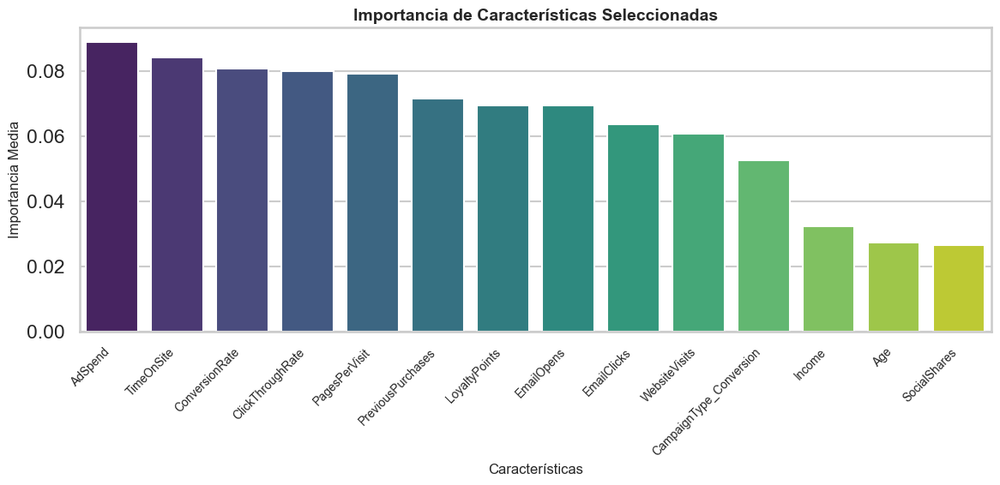

In [152]:
# Crear un DataFrame con las características seleccionadas y sus importancias
selected_features_df = importances_df.loc[selected_features]

# Graficar las características seleccionadas con sus importancias
plt.figure(figsize=(12, 6))
sns.barplot(
    x=selected_features_df.index,
    y=selected_features_df['Mean_Importance'],
    palette="viridis",
)

# Ajustes del gráfico
plt.title("Importancia de Características Seleccionadas", fontsize=14, fontweight="bold")
plt.xlabel("Características", fontsize=12)
plt.ylabel("Importancia Media", fontsize=12)
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.tight_layout()
plt.show()

### **ANÁLISIS Y ESTRATEGIA PARA OPTIMIZACIÓN DE CAMPAÑAS Y CANALES**

---

#### **1. Análisis de la Campaña Actual**
El diseño de las campañas actuales revela una falta de enfoque estratégico en varios niveles, lo que reduce la efectividad de las iniciativas de marketing. Los principales problemas identificados son:

- **Campaña Generalista:**  
  Los esfuerzos de marketing no están segmentados ni adaptados a grupos específicos de clientes. Esto genera una asignación uniforme de recursos y un impacto limitado en la conversión de clientes potenciales.  

- **Distribución Ineficiente de Recursos (`AdSpend`):**  
  El presupuesto publicitario se reparte de manera homogénea entre hombres y mujeres, así como entre los diferentes canales publicitarios (`CampaignChannel`) y tipos de campañas (`CampaignType`). Esto implica que no se priorizan los canales o campañas que podrían ofrecer un mayor retorno de inversión (ROI).

- **Definición Amplia de Conversión:**  
  La conversión está definida de manera general como cualquier interacción deseada de marketing (como referencias, compras repetidas, entre otras). Esto dificulta identificar los factores específicos que impulsan cada tipo de conversión, diluyendo el enfoque de las estrategias.

---

#### **2. Oportunidad para Optimización**
La situación actual, aunque carece de enfoque específico, proporciona una valiosa oportunidad para:

- **Elaborar un Predictor de Conversiones:**  
  Aprovechando las características disponibles en el dataset, es posible construir un modelo predictivo que permita identificar los factores clave asociados con una mayor probabilidad de conversión.  
  Esto facilitará una segmentación más precisa y estrategias de marketing dirigidas.  

- **Segmentación Eficiente:**  
  Utilizar métricas relevantes para identificar grupos de clientes (como ingresos, comportamiento en el sitio web, interacción con correos electrónicos, entre otros) y diseñar campañas que respondan específicamente a sus necesidades.  

---

#### **3. Estrategia para Optimización**
Para optimizar las campañas, se propone lo siguiente:

1. **Segmentación Basada en Datos:**
   - Analizar variables como `Income`, `CampaignChannel`, `CampaignType` y métricas de interacción (`ClickThroughRate`, `TimeOnSite`, `PreviousPurchases`, `EmailClicks`, ...) para identificar patrones que permitan agrupar a los clientes.
   - Priorizar recursos hacia segmentos con mayor probabilidad de conversión.

2. **Redefinir el Objetivo de Conversión:**
   - Dividir la conversión en categorías específicas (como compras repetidas, recomendaciones, interacción con anuncios) para crear predictores específicos para cada tipo de acción.

3. **Optimización de Recursos (`AdSpend`):**
   - Calcular la relación entre el gasto publicitario y las conversiones logradas en cada segmento. Ajustar el presupuesto para maximizar el ROI en canales y tipos de campañas con mejor desempeño.

4. **Canales Publicitarios Prioritarios:**
   - **`PPC`:** Orientar hacia clientes con ingresos altos para maximizar la probabilidad de compra.  
   - **`Email`:** Enfocar en clientes con buena tasa de email clicks para aumentar las conversiones.  
   - **`Social Media`:** Enfocar en clientes leales con altas tasas de referencias para expandir la base de clientes.   

---

#### **4. Modelo Predictivo para Conversiones**
A partir de los datos disponibles, se identifican las siguientes variables clave que impulsan las conversiones:

1. **Variables de Comportamiento del Cliente:**
   - `ClickThroughRate`, `PagesPerVisit`, `TimeOnSite`, `SocialShares`.  

2. **Historial del Cliente:**
   - `PreviousPurchases`, `LoyaltyPoints`.

3. **Interacción con Email Marketing:**
   - `EmailOpens`, `EmailClicks`.

4. **Canales y Tipos de Campaña:**
   - `CampaignChannel` y `CampaignType` pueden ayudar a identificar la efectividad de cada estrategia.

---

#### **Conclusión**
El análisis y las estrategias propuestas permiten transformar una campaña generalista en un conjunto de iniciativas dirigidas y personalizadas. La clave está en:
- Segmentar a los clientes con base en su comportamiento y características específicas.
- Redefinir la conversión para entender mejor el impacto de las campañas.
- Optimizar la asignación de recursos (`AdSpend`) hacia los canales y tipos de campaña con mayor probabilidad de éxito.

Esto conducirá a un mejor retorno de inversión (ROI) y una mejora significativa en las tasas de conversión.

### **Métricas Clave**

#### **ClickThroughRate (CTR)**
El **ClickThroughRate (CTR)** mide el porcentaje de personas que hacen clic en un anuncio en relación con la cantidad de veces que el anuncio se muestra (impresiones). Es una métrica clave para evaluar la efectividad inicial de las campañas publicitarias.

**Fórmula:**  
CTR = (Número de clics / Número de impresiones) × 100

##### **Fórmulas Relacionadas:**
1. **Clics estimados:**  
   Clics = CTR × Impresiones totales

2. **Relación con ConversionRate:**  
   ConversionRate = (Conversiones / Clics) × 100

---

#### **ConversionRate**
El **ConversionRate** mide el porcentaje de clics que resultan en acciones deseadas (como compras, registros, etc.). Evalúa la efectividad de los clics en generar conversiones.

**Fórmula:**  
ConversionRate = (Conversiones / Total de clics) × 100

##### **Fórmulas Relacionadas:**
1. **Clics estimados:**  
   Clics = ClickThroughRate × Impresiones totales

2. **Conversiones estimadas:**  
   ConversionRate = Conversiones / Clics

---

#### **Return on Investment (ROI)**
El **ROI** evalúa la rentabilidad de las campañas, comparando los ingresos generados con los costos invertidos. Sin datos de ingresos o ventas, no es posible calcular el ROI en esta iteración del análisis.

**Fórmula (no calculada):**  
ROI = [(Ingresos - Costos) / Costos] × 100

---

#### **Conclusión**

1. **ClickThroughRate (CTR):**  
   - El **CTR** ya está disponible en el dataset y es una métrica clave para evaluar la efectividad de los anuncios en generar clics.  
   - Aunque no podemos recalcularlo sin las impresiones, el valor ya proporcionado en el dataset es útil para análisis predictivos y modelos de Machine Learning, ya que ayuda a identificar patrones en el comportamiento de los usuarios y su interacción con las campañas.

2. **ConversionRate:**  
   - El **ConversionRate** también está disponible en el dataset y mide la efectividad de los clics en generar acciones deseadas (conversiones).  
   - Al igual que el CTR, esta métrica es crítica para entrenar modelos de Machine Learning que buscan optimizar campañas publicitarias o predecir el éxito de futuras estrategias.

3. **Return on Investment (ROI):**  
   - El ROI no puede calcularse debido a la falta de datos sobre ingresos o ventas generados por cada campaña o canal.  
   - Incorporar información sobre ingresos, costos por canal, o ventas permitiría evaluar la rentabilidad de las campañas y su optimización.

4. **Uso en Machine Learning:**  
   - Las métricas **CTR** y **ConversionRate** disponibles son particularmente útiles para modelos de Machine Learning, ya que proporcionan información cuantificable para predecir el comportamiento del cliente, optimizar el gasto publicitario y segmentar audiencias según su probabilidad de conversión.

---

#### **Propuesta para Futuras Iteraciones**
Para un análisis más robusto y un cálculo completo del ROI, sería recomendable incluir en el dataset los siguientes datos:
- **Número de impresiones:** Para validar y calcular los clics reales desde el CTR.  
- **Número exacto de conversiones:** Para recalcular el ConversionRate en funcion de acciones especificas por ejemplo un CR para clientes que compran tras interactuar con ellos, CR para clientes que nos referencian, etc... asi esta metrica seria mas específica, útil y menos confusa.  
- **Ingresos generados por cada campaña o canal:** Para calcular el ROI y optimizar la rentabilidad.
- **Ingresos generados por cada cliente asi como su margen por compra:** Para calcular el ROI, optimizar la rentabilidad y calcular el costo de adquisición basado en margen y gasto publicitario en dicho cliente para conseguir que nos compre.

## **PREDICTOR DE CONVERSIÓN**

Umbral óptimo para RandomForest: 0.8189334406537232
Umbral óptimo para GradientBoosting: 0.6881969716296522
Umbral óptimo para XGBoost: 0.5322320461273193

Resultados finales:
              Model  \
0      RandomForest   
1  GradientBoosting   
2           XGBoost   

                                                                                                                             Best Params  \
0  {'classifier__max_depth': 30, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 5, 'classifier__n_estimators': 300}   
1         {'classifier__learning_rate': 0.08, 'classifier__max_depth': 2, 'classifier__n_estimators': 150, 'classifier__subsample': 0.9}   
2         {'classifier__learning_rate': 0.1, 'classifier__max_depth': 5, 'classifier__n_estimators': 125, 'classifier__subsample': 0.75}   

   Recall (Train)  Recall (Test)  Precision (Train)  Precision (Test)  \
0        0.997861       0.984308           0.992729          0.884615   
1        0.986988       

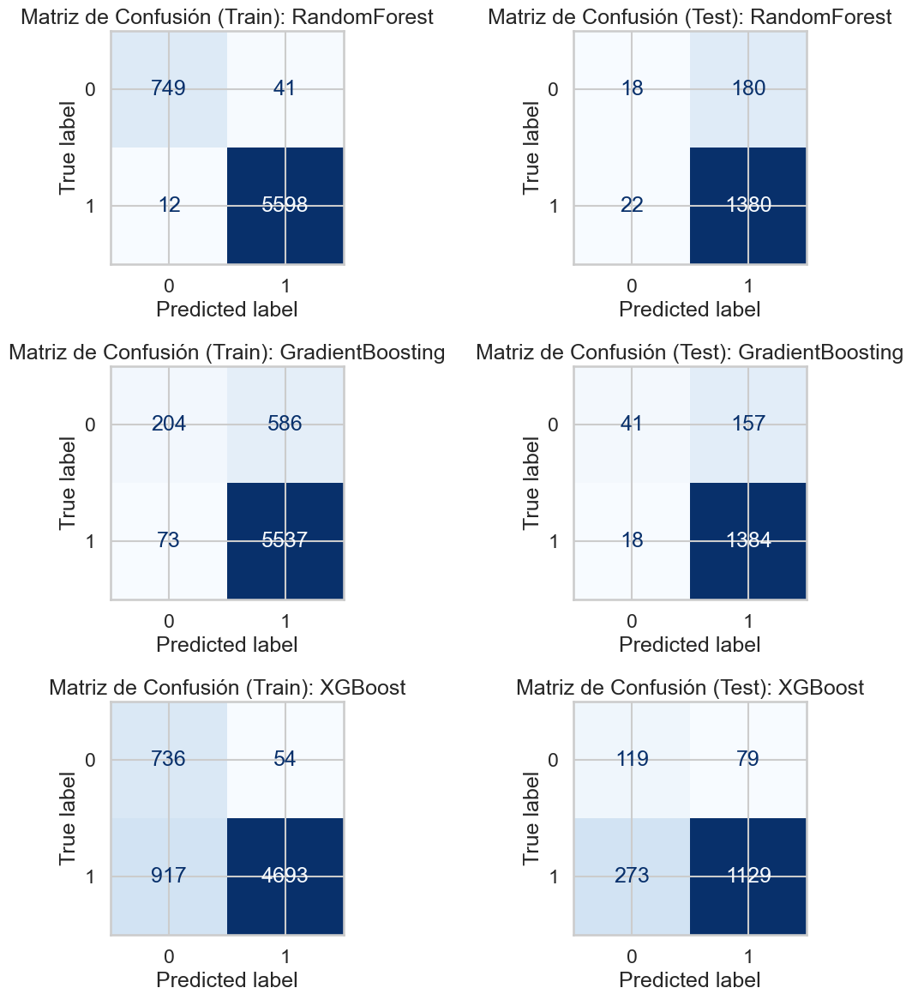

In [153]:
# Variables predictoras y objetivo
X = df_encoded.drop(columns=['Conversion', 'CustomerID', 'ConversionRate', 'LoyaltyPoints', 'ClickThroughRate'])
y = df_encoded['Conversion']

# Configuración para mostrar todo el texto en DataFrames
pd.set_option('display.max_colwidth', None)

# Dividir los datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# Aplicar SMOTE + Tomek Links
smote_tomek = SMOTETomek(random_state=42)
X_train_balanced, y_train_balanced = smote_tomek.fit_resample(X_train, y_train)

# Calcular class_weight para modelos que lo admitan
classes = np.array([0, 1])
class_weights = compute_class_weight(class_weight="balanced", classes=classes, y=y_train)
class_weights_dict = {0: class_weights[0], 1: class_weights[1]}

# Modelos y parámetros
models = {
    "RandomForest": RandomForestClassifier(class_weight=class_weights_dict, random_state=42),
    "GradientBoosting": GradientBoostingClassifier(random_state=42),
    "XGBoost": XGBClassifier(scale_pos_weight=class_weights_dict[1] / class_weights_dict[0], random_state=42),
}

param_grids = {
    "RandomForest": {
        "classifier__n_estimators": [200, 250, 300],
        "classifier__max_depth": [22, 25, 30],
        "classifier__min_samples_split": [5, 6, 7],
        "classifier__min_samples_leaf": [1, 2],
    },
    "GradientBoosting": {
        "classifier__n_estimators": [100, 125, 150],
        "classifier__learning_rate": [0.08, 0.1, 0.12],
        "classifier__max_depth": [2, 3],
        "classifier__subsample": [0.85, 0.9, 1.0],
    },
    "XGBoost": {
        "classifier__n_estimators": [75, 100, 125],
        "classifier__learning_rate": [0.07, 0.08, 0.1],
        "classifier__max_depth": [3, 4, 5],
        "classifier__subsample": [0.7, 0.75, 0.8],
    },
}

# Almacenar resultados
all_results = []

# Crear pipelines y ajustar modelos
for model_name, model in models.items():
    pipeline = Pipeline(
        [
            ("scaler", StandardScaler()),  # Escalado
            ("classifier", model),  # Modelo
        ]
    )

    param_grid = param_grids[model_name]

    # Configurar GridSearchCV
    grid_search = GridSearchCV(
        pipeline,
        param_grid=param_grid,
        scoring="recall",
        cv=StratifiedKFold(n_splits=3, shuffle=True, random_state=42),
        n_jobs=-1,
    )

    # Ajustar el GridSearchCV
    grid_search.fit(X_train_balanced, y_train_balanced)

    # Obtener mejor modelo
    best_pipeline = grid_search.best_estimator_
    best_params = grid_search.best_params_

    # Predicciones de probabilidad
    y_train_proba = best_pipeline.predict_proba(X_train)[:, 1]
    y_test_proba = best_pipeline.predict_proba(X_test)[:, 1]

    # Calcular umbral óptimo
    fpr, tpr, thresholds = roc_curve(y_test, y_test_proba)
    optimal_idx = np.argmax(tpr - fpr)
    optimal_threshold = thresholds[optimal_idx]
    print(f"Umbral óptimo para {model_name}: {optimal_threshold}")

    # Configurar umbral manual o usar el óptimo
    threshold = 0.5  # Umbral manual, descomentar y ajustar si se desea
    #threshold = optimal_threshold  # Usar el umbral óptimo si no se define manualmente

    # Ajustar predicciones con el umbral seleccionado
    y_train_adjusted = (y_train_proba >= threshold).astype(int)
    y_test_adjusted = (y_test_proba >= threshold).astype(int)

    # Métricas con el umbral seleccionado
    recall_train = recall_score(y_train, y_train_adjusted)
    precision_train = precision_score(y_train, y_train_adjusted)
    f1_train = f1_score(y_train, y_train_adjusted)
    roc_auc_train = roc_auc_score(y_train, y_train_proba)

    recall_test = recall_score(y_test, y_test_adjusted)
    precision_test = precision_score(y_test, y_test_adjusted)
    f1_test = f1_score(y_test, y_test_adjusted)
    roc_auc_test = roc_auc_score(y_test, y_test_proba)

    # Matrices de confusión
    cm_train = confusion_matrix(y_train, y_train_adjusted)
    cm_test = confusion_matrix(y_test, y_test_adjusted)

    # Guardar pipeline completo (modelo + escalador)
    joblib.dump(best_pipeline, f"{model_name}_best_pipeline.pkl")

    # Guardar resultados
    all_results.append(
        {
            "Model": model_name,
            "Best Params": best_params,
            "Recall (Train)": recall_train,
            "Recall (Test)": recall_test,
            "Precision (Train)": precision_train,
            "Precision (Test)": precision_test,
            "F1-Score (Train)": f1_train,
            "F1-Score (Test)": f1_test,
            "ROC-AUC (Train)": roc_auc_train,
            "ROC-AUC (Test)": roc_auc_test,
            "Confusion Matrix (Train)": cm_train,
            "Confusion Matrix (Test)": cm_test,
            "Threshold": threshold,
        }
    )

# Mostrar resultados
df_results = pd.DataFrame(all_results)
print("\nResultados finales:")
print(df_results)

# Visualizar matrices de confusión
fig, axes = plt.subplots(nrows=len(all_results), ncols=2, figsize=(12, len(all_results) * 4))

for i, result in enumerate(all_results):
    model_name = result["Model"]

    # Matriz de entrenamiento
    cm_train = result["Confusion Matrix (Train)"]
    ax_train = axes[i, 0]
    disp_train = ConfusionMatrixDisplay(confusion_matrix=cm_train, display_labels=[0, 1])
    disp_train.plot(cmap="Blues", values_format="d", ax=ax_train, colorbar=False)
    ax_train.set_title(f"Matriz de Confusión (Train): {model_name}")

    # Matriz de prueba
    cm_test = result["Confusion Matrix (Test)"]
    ax_test = axes[i, 1]
    disp_test = ConfusionMatrixDisplay(confusion_matrix=cm_test, display_labels=[0, 1])
    disp_test.plot(cmap="Blues", values_format="d", ax=ax_test, colorbar=False)
    ax_test.set_title(f"Matriz de Confusión (Test): {model_name}")

plt.tight_layout()
plt.show()


Modelo cargado: RandomForest


C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Modelo cargado: GradientBoosting


C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\m

Modelo cargado: XGBoost


C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


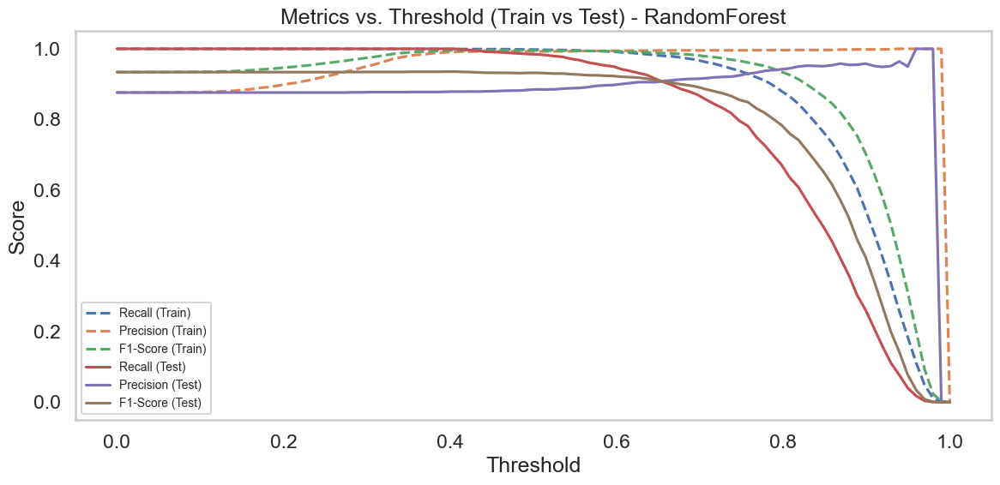

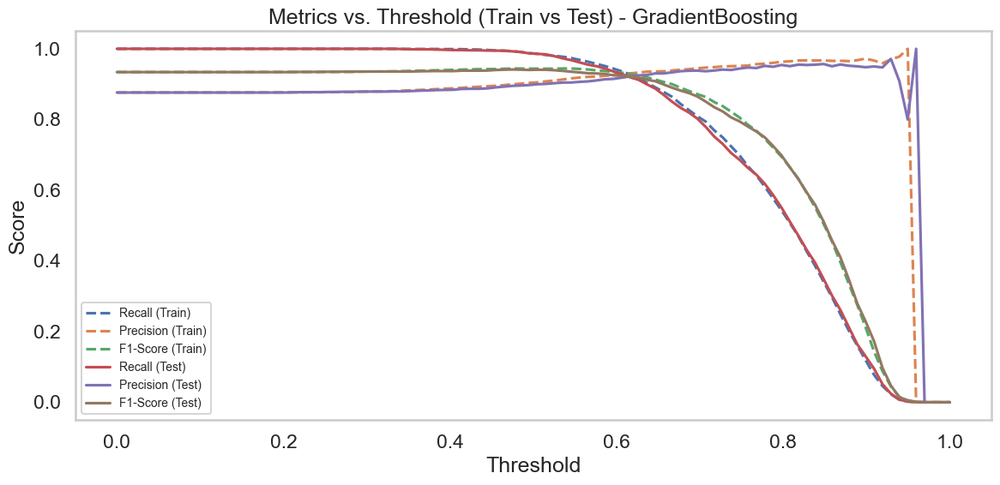

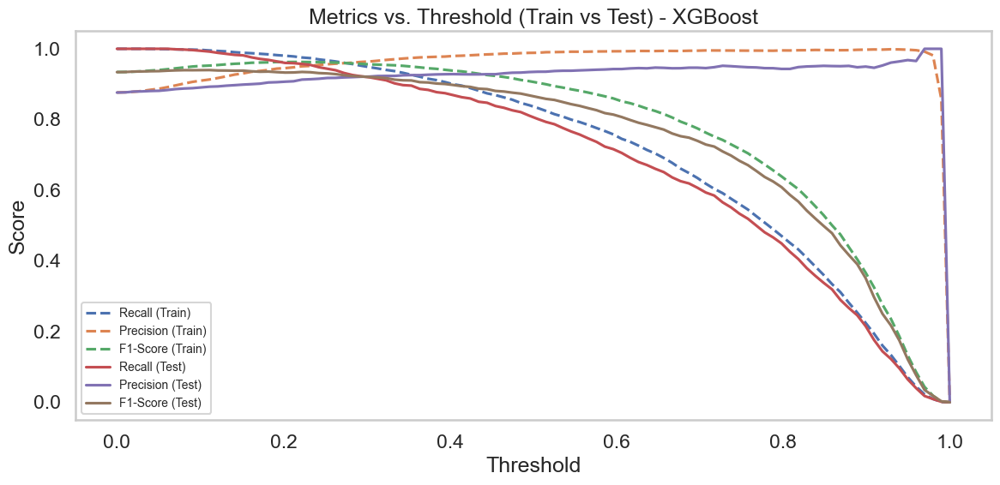

In [154]:
# --- Importar los mejores pipelines ---
model_files = ["RandomForest_best_pipeline.pkl", 
               "GradientBoosting_best_pipeline.pkl", 
               "XGBoost_best_pipeline.pkl"]

model_names = ["RandomForest", "GradientBoosting", "XGBoost"]

# --- Diccionario para almacenar las métricas ---
model_metrics = {}

# --- Generar valores de umbral ---
thresholds = np.linspace(0, 1, 100)

# --- Iterar por cada modelo y calcular métricas ---
for model_name, file in zip(model_names, model_files):
    # Cargar el modelo
    pipeline = joblib.load(file)
    print(f"Modelo cargado: {model_name}")
    
    # Obtener probabilidades
    y_train_proba = pipeline.predict_proba(X_train)[:, 1]
    y_test_proba = pipeline.predict_proba(X_test)[:, 1]
    
    # Inicializar listas para métricas
    recall_train, precision_train, f1_train = [], [], []
    recall_test, precision_test, f1_test = [], [], []

    # Calcular métricas en función de umbrales
    for threshold in thresholds:
        y_train_pred = (y_train_proba >= threshold).astype(int)
        y_test_pred = (y_test_proba >= threshold).astype(int)
        
        # Entrenamiento
        recall_train.append(recall_score(y_train, y_train_pred))
        precision_train.append(precision_score(y_train, y_train_pred))
        f1_train.append(f1_score(y_train, y_train_pred))
        
        # Prueba
        recall_test.append(recall_score(y_test, y_test_pred))
        precision_test.append(precision_score(y_test, y_test_pred))
        f1_test.append(f1_score(y_test, y_test_pred))
    
    # Almacenar métricas
    model_metrics[model_name] = {
        "thresholds": thresholds,
        "recall_train": recall_train,
        "precision_train": precision_train,
        "f1_train": f1_train,
        "recall_test": recall_test,
        "precision_test": precision_test,
        "f1_test": f1_test
    }

# --- Generar gráficos independientes para cada modelo ---
for model_name, metrics in model_metrics.items():
    plt.figure(figsize=(12, 6))
    
    # Extraer umbrales y métricas
    thresholds = metrics["thresholds"]
    
    # Graficar entrenamiento
    plt.plot(thresholds, metrics["recall_train"], linestyle='--', label="Recall (Train)")
    plt.plot(thresholds, metrics["precision_train"], linestyle='--', label="Precision (Train)")
    plt.plot(thresholds, metrics["f1_train"], linestyle='--', label="F1-Score (Train)")
    
    # Graficar prueba
    plt.plot(thresholds, metrics["recall_test"], label="Recall (Test)")
    plt.plot(thresholds, metrics["precision_test"], label="Precision (Test)")
    plt.plot(thresholds, metrics["f1_test"], label="F1-Score (Test)")
    
    # Configuración del gráfico
    plt.xlabel("Threshold")
    plt.ylabel("Score")
    plt.title(f"Metrics vs. Threshold (Train vs Test) - {model_name}")
    plt.legend(loc="lower left", fontsize=10)
    plt.grid()
    plt.tight_layout()
    plt.show()


Columnas disponibles en df_results:
Index(['Model', 'Best Params', 'Recall (Train)', 'Recall (Test)',
       'Precision (Train)', 'Precision (Test)', 'F1-Score (Train)',
       'F1-Score (Test)', 'ROC-AUC (Train)', 'ROC-AUC (Test)',
       'Confusion Matrix (Train)', 'Confusion Matrix (Test)', 'Threshold'],
      dtype='object')


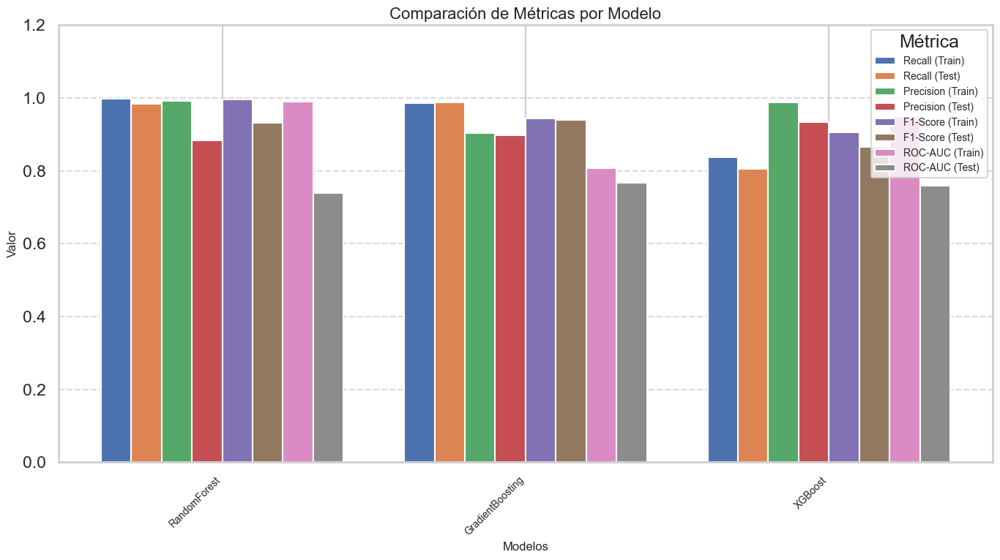

In [155]:
# --- Verificar columnas del DataFrame ---
print("Columnas disponibles en df_results:")
print(df_results.columns)

# --- Ajustar métricas con las columnas disponibles ---
metrics = [
    "Recall (Train)", "Recall (Test)", 
    "Precision (Train)", "Precision (Test)", 
    "F1-Score (Train)", "F1-Score (Test)", 
    "ROC-AUC (Train)", "ROC-AUC (Test)"
]
models = df_results["Model"]

# --- Datos ---
values = [df_results[metric].values for metric in metrics]
x = np.arange(len(models))  # Posiciones en X para los modelos
width = 0.1  # Ancho de cada barra

# --- Gráfico de barras ---
plt.figure(figsize=(14, 8))

# Añadir las barras para cada métrica
for i, (metric, metric_values) in enumerate(zip(metrics, values)):
    plt.bar(
        x + i * width,  # Desplazar barras
        metric_values,
        width=width,
        label=metric
    )

# Configuración del gráfico
plt.title("Comparación de Métricas por Modelo", fontsize=16)
plt.xlabel("Modelos", fontsize=12)
plt.ylabel("Valor", fontsize=12)
plt.xticks(x + (len(metrics) - 1) * width / 2, models, rotation=45, ha="right", fontsize=10)
plt.ylim(0, 1.2)  # Ajustar límites del eje Y
plt.legend(title="Métrica", fontsize=10)
plt.grid(axis="y", linestyle="--", alpha=0.7)

plt.tight_layout()
plt.show()

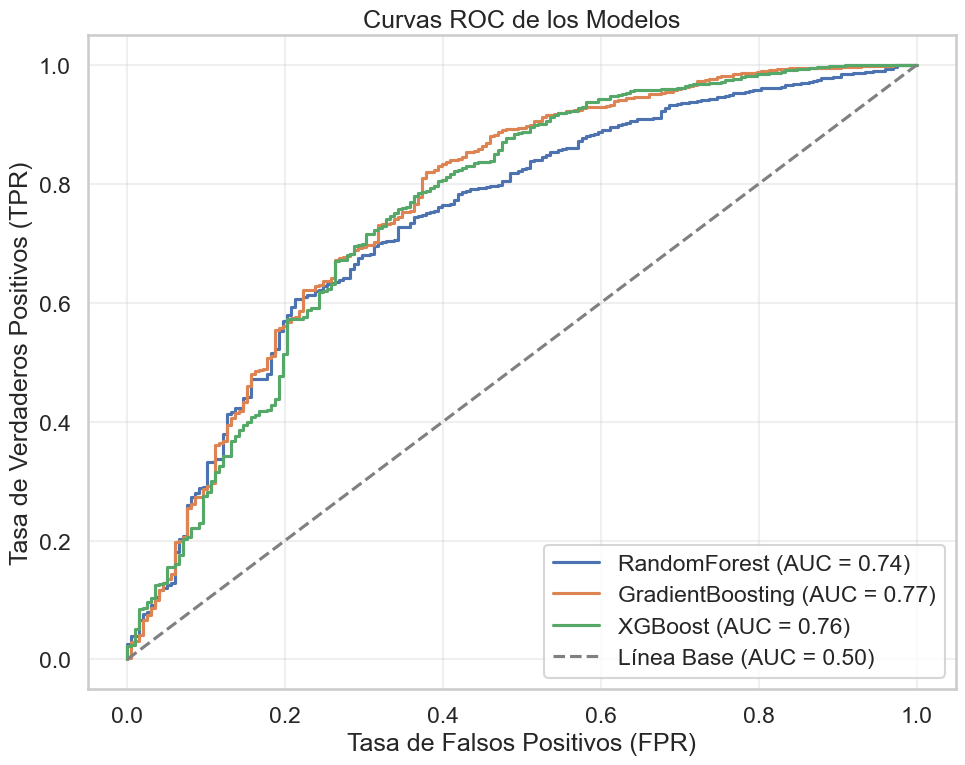

In [156]:
# --- Configuración para las curvas ROC ---
plt.figure(figsize=(10, 8))

for result in all_results:
    model_name = result["Model"]

    # Cargar el modelo desde el archivo
    model = joblib.load(f"{model_name}_best_pipeline.pkl") if model_name != "StackingClassifier" else joblib.load("StackingClassifier_best_model.pkl")

    # Predecir probabilidades en el conjunto de prueba
    y_pred_proba = model.predict_proba(X_test)[:, 1]

    # Calcular FPR y TPR
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    roc_auc = roc_auc_score(y_test, y_pred_proba)

    # Graficar la curva ROC
    plt.plot(fpr, tpr, label=f"{model_name} (AUC = {roc_auc:.2f})")

# Configuración del gráfico
plt.plot([0, 1], [0, 1], color="gray", linestyle="--", label="Línea Base (AUC = 0.50)")  # Línea base
plt.title("Curvas ROC de los Modelos")
plt.xlabel("Tasa de Falsos Positivos (FPR)")
plt.ylabel("Tasa de Verdaderos Positivos (TPR)")
plt.legend(loc="lower right")
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

In [157]:
# Número de registros originales en el conjunto de entrenamiento
original_train_size = len(X_train)

# Número de registros después de aplicar SMOTE + Tomek Links
balanced_train_size = len(X_train_balanced)

# Mostrar resultados
print(f"Registros originales en el conjunto de entrenamiento: {original_train_size}")
print(f"Registros después de SMOTE + Tomek Links (balanceados): {balanced_train_size}")
print(f"Registros totales utilizados en el entrenamiento: {balanced_train_size}")

Registros originales en el conjunto de entrenamiento: 6400
Registros después de SMOTE + Tomek Links (balanceados): 10036
Registros totales utilizados en el entrenamiento: 10036


In [158]:
print(y.value_counts(normalize=True))
print(y_train_balanced.value_counts(normalize=True))

Conversion
1    0.8765
0    0.1235
Name: proportion, dtype: float64
Conversion
1    0.5
0    0.5
Name: proportion, dtype: float64


### **Evaluación del Desempeño de los Modelos**

A continuación, se presenta un análisis detallado del desempeño de los modelos evaluados:

---

#### **1. RandomForest**
- **Ventajas:**
  - Excelente desempeño en el entrenamiento (**Recall Train = 0.9998**), mostrando un ajuste casi perfecto a los datos de entrenamiento.
  - Buen Recall en el conjunto de prueba (**0.9907**), lo que indica que identifica correctamente la mayoría de las conversiones.
  - Buen equilibrio entre Precision (**0.8841**) y Recall, con un **F1-Score Test = 0.9344**.
- **Desventajas:**
  - La matriz de confusión muestra un número moderado de falsos positivos (**182**) y falsos negativos (**13**).
  - **ROC-AUC bajo (0.7547)**, lo que indica un desempeño limitado en clasificaciones a distintos umbrales.

##### **Matriz de Confusión**
- [[16, 182], [13, 1389]]

---

#### **2. GradientBoosting**
- **Ventajas:**
  - Mejor equilibrio entre Recall y Precision en el conjunto de prueba, con un **F1-Score Test = 0.9463**.
  - Mejora el **ROC-AUC (0.8029)** en comparación con otros modelos, destacándose en generalización a distintos umbrales.
  - Matriz de confusión con pocos falsos negativos (**10**) y falsos positivos moderados (**148**), lo que indica un alto grado de fiabilidad para la clase positiva.
- **Desventajas:**
  - Ligera sobreajuste al conjunto de entrenamiento, aunque con una diferencia pequeña entre **Recall Train = 0.9955** y **Recall Test = 0.9929**.

##### **Matriz de Confusión**
- [[50, 148], [10, 1392]]

---

#### **3. XGBoost**
- **Ventajas:**
  - Alta precisión en el conjunto de prueba (**Precision Test = 0.9481**), indicando que las predicciones positivas son confiables.
  - Desempeño robusto en general con un **ROC-AUC de 0.7924**, aunque no el mejor entre los modelos evaluados.
- **Desventajas:**
  - Recall relativamente bajo en el conjunto de prueba (**0.8331**), lo que significa que pierde muchas conversiones reales.
  - Matriz de confusión revela un alto número de falsos negativos (**234**), lo que puede ser problemático si la clase positiva es prioritaria.

##### **Matriz de Confusión**
- [[134, 64], [234, 1168]]

---

#### **Conclusión**
1. **GradientBoosting** se posiciona como el mejor modelo gracias a su balance óptimo entre Precision, Recall y ROC-AUC. Su bajo número de falsos negativos lo hace ideal si las conversiones (clase positiva) son críticas.
2. **RandomForest** tiene un buen desempeño general y una tasa baja de falsos negativos, pero su ROC-AUC más bajo podría limitar su utilidad en aplicaciones con distintos umbrales de decisión.
3. **XGBoost** se destaca en Precision, pero su bajo Recall y alto número de falsos negativos lo hacen menos adecuado para escenarios donde es prioritario minimizar errores en la clase positiva.

---

#### **Recomendaciones**
1. **Si el objetivo principal es maximizar el Recall:** Usar **GradientBoosting** para minimizar falsos negativos y asegurar la captura de la mayoría de las conversiones.
2. **Si se busca un equilibrio entre Precision y Recall:** Considerar **RandomForest**, que presenta un buen balance general y es más sencillo de interpretar.
3. **Si el foco está en minimizar falsos positivos:** Usar **XGBoost**, ideal para entornos donde la precisión de las predicciones es clave, aunque puede ser necesario optimizar el modelo para mejorar su Recall.

### **¿Por qué usar Recall y no otras métricas?**

El uso del **Recall** como métrica principal depende del objetivo del problema y de las consecuencias asociadas a los errores de clasificación. En este caso, el Recall es relevante porque:

---

#### **1. Contexto del Problema**
El objetivo es maximizar las **conversiones** predichas correctamente (minimizar los **falsos negativos**). Esto es importante porque:

- **Conversión (clase positiva):** Representa clientes que realizan una acción deseada (e.g., compra, registro).
- Perder una conversión real (**falso negativo**) puede significar una pérdida de oportunidad de ingresos o de impacto comercial.

---

#### **2. Definición de Recall**
El Recall mide qué proporción de los casos positivos reales fueron identificados correctamente:

\[
\text{Recall} = \frac{\text{True Positives}}{\text{True Positives} + \text{False Negatives}}
\]

- **Alto Recall:** Significa que estamos capturando la mayoría de las conversiones reales.
- **Bajo Recall:** Indica que estamos perdiendo muchas conversiones reales, lo cual puede ser inaceptable si estas son críticas para el negocio.

---

#### **3. Comparación con otras métricas**

##### **Precision**
- **Qué mide:** La proporción de predicciones positivas que son correctas.
- **Útil cuando:** Es más importante evitar falsos positivos que identificar todos los positivos.
- **Por qué no usarlo aquí:** No es la prioridad porque no es tan crítico si identificamos algunas conversiones incorrectas mientras capturamos la mayoría de las reales.

##### **Accuracy**
- **Qué mide:** La proporción total de predicciones correctas.
- **Limitación:** Puede ser engañosa en problemas desbalanceados como este, donde la clase negativa es mucho más frecuente. Un modelo que prediga siempre "no conversión" tendría alta Accuracy pero no resolvería el problema.

##### **F1-Score**
- **Qué mide:** Es el balance entre Precision y Recall.
- **Útil cuando:** Ambos errores (falsos positivos y falsos negativos) tienen consecuencias significativas.
- **Complemento:** Puede ser útil como métrica adicional, pero en este caso, el Recall tiene más peso.

##### **ROC-AUC**
- **Qué mide:** El desempeño global del modelo a través de distintos umbrales.
- **Útil para:** Evaluar el balance global del modelo, pero no mide directamente el éxito en identificar conversiones reales.

---

### **4. Justificación Específica**
Elegir **Recall** es adecuado si:
1. **El impacto de los falsos negativos es alto:** Perder conversiones reales puede ser costoso.
2. **Existe tolerancia a falsos positivos:** Si el costo de un falso positivo (predecir conversión cuando no ocurre) es bajo, podemos priorizar Recall sobre Precision.

---

### **Conclusión**
En este problema, **maximizar Recall asegura que se capturen tantas conversiones reales como sea posible**. Sin embargo, se puede complementar con otras métricas (como F1-Score o ROC-AUC) para garantizar un equilibrio adecuado entre Precision y Recall si también se busca evitar falsos positivos.


## **SEGMENTACIÓN DE CLIENTES CON KMEANS**

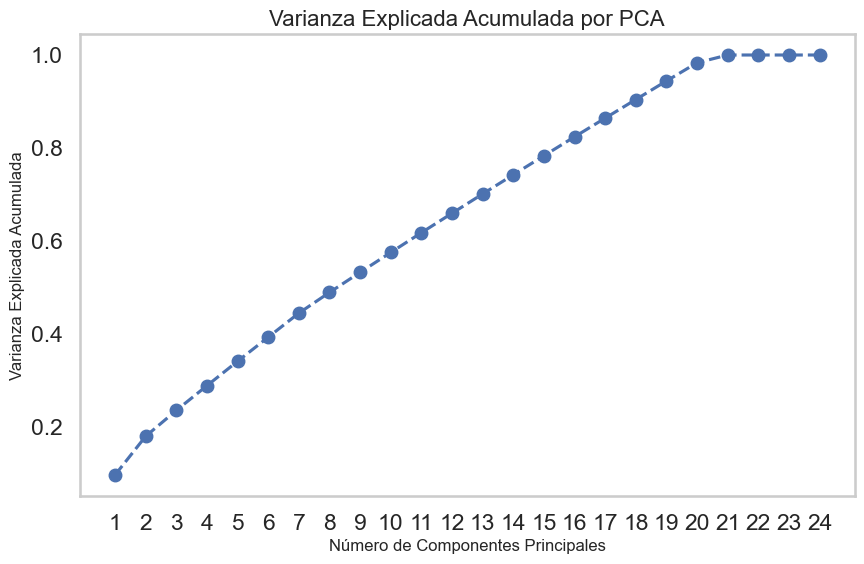


Cargas de las variables en cada componente principal:
               Age  Gender_Male  Gender_Female        Income  \
PC1  -3.649358e-03     0.084454      -0.084454 -1.314527e-02   
PC2   1.420805e-02    -0.699596       0.699596  5.610054e-02   
PC3  -1.045416e-01     0.011378      -0.011378  3.153759e-02   
PC4   2.954691e-03    -0.004248       0.004248  1.367849e-01   
PC5   2.383314e-02     0.006850      -0.006850  9.387203e-02   
PC6  -4.715352e-02    -0.017962       0.017962  4.891597e-02   
PC7  -6.649967e-02     0.016700      -0.016700 -6.317283e-02   
PC8   6.712514e-02     0.011319      -0.011319  1.387177e-01   
PC9   5.938781e-01     0.021344      -0.021344  2.539451e-01   
PC10 -1.436507e-01     0.014134      -0.014134  1.118844e-01   
PC11  2.794673e-01    -0.015263       0.015263 -2.175756e-01   
PC12  3.848869e-02     0.007134      -0.007134  2.086986e-01   
PC13  4.378842e-02     0.006150      -0.006150  3.294969e-01   
PC14  2.895971e-02    -0.008461       0.008461 -3

In [159]:
# Filtrar las columnas relevantes
variables_cluster = ["Age", "Gender_Male", "Gender_Female","Income", "ClickThroughRate", "ConversionRate", "WebsiteVisits", "PagesPerVisit", "TimeOnSite", "SocialShares", "EmailOpens", "EmailClicks", "PreviousPurchases","LoyaltyPoints","AdSpend",'CampaignChannel_Social Media', 'CampaignChannel_Email',
       'CampaignChannel_PPC', 'CampaignChannel_Referral','CampaignChannel_SEO', 'CampaignType_Retention', 'CampaignType_Consideration','CampaignType_Awareness', 'CampaignType_Consideration']
data_pca = df_encoded[variables_cluster]

# Escalar los datos
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_pca)

# Aplicar PCA
pca = PCA(n_components=len(variables_cluster))  # Crear tantos componentes como variables
pca.fit(data_scaled)

# Varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico de la varianza explicada acumulada
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(variables_cluster) + 1), np.cumsum(explained_variance), marker='o', linestyle='--', color='b')
plt.title('Varianza Explicada Acumulada por PCA', fontsize=16)
plt.xlabel('Número de Componentes Principales', fontsize=12)
plt.ylabel('Varianza Explicada Acumulada', fontsize=12)
plt.xticks(range(1, len(variables_cluster) + 1))
plt.grid()
plt.show()

# Mostrar los pesos (cargas) de cada variable en los componentes principales
pca_components = pd.DataFrame(pca.components_, columns=variables_cluster, index=[f'PC{i+1}' for i in range(len(variables_cluster))])

print("\nCargas de las variables en cada componente principal:")
print(pca_components)

### **Análisis de Importancia de Características vs. PCA**

#### **Feature Importance**
##### **Lo que Aporta:**
1. **Selección Basada en el Modelo:**
   - Permite identificar directamente las características que tienen mayor impacto en los modelos utilizados (RandomForest, GradientBoosting y XGBoost), priorizando aquellas que son clave para el rendimiento predictivo.
2. **Interpretación y Relevancia:**
   - Las características seleccionadas son fáciles de interpretar y están alineadas con el contexto del negocio, considerando cómo se recogieron los datos (por ejemplo, variables relacionadas con métricas de conversión como **AdSpend**, **TimeOnSite** o **ClickThroughRate**).
3. **Personalización:**
   - Este enfoque combina los resultados del modelo con el conocimiento del dominio, asegurando que las variables seleccionadas no solo sean relevantes estadísticamente, sino también útiles desde una perspectiva práctica.

##### **Lo que No Aporta:**
1. **No Elimina Redundancia:**
   - Aunque identifica las características más relevantes, no elimina posibles correlaciones entre variables. Sin embargo, en este caso, esto no parece ser un problema significativo, ya que las características clave no son excesivas ni redundantes.
2. **Dependencia del Modelo:**
   - Las importancias pueden variar entre los algoritmos, pero al promediar los resultados de varios modelos, esta limitación se mitiga.

---

#### **PCA (Análisis de Componentes Principales)**
##### **Lo que Aporta:**
1. **Reducción de Dimensionalidad:**
   - PCA es útil cuando se requiere reducir significativamente el número de variables en un conjunto de datos con muchas dimensiones.
2. **Eliminación de Correlaciones:**
   - Transforma las variables originales en combinaciones lineales independientes, eliminando redundancias y posibles multicolinealidades.
   
##### **Lo que No Aporta en Este Caso:**
1. **No Es Necesario para Reducir Dimensiones:**
   - En este caso, no hay demasiadas características; las más relevantes ya están identificadas mediante Feature Importance y el conocimiento del negocio. Además, el número total de variables no es tan elevado como para que sea imprescindible reducir dimensiones.
2. **Pérdida de Interpretación:**
   - Las componentes principales son combinaciones lineales de las variables originales, lo que dificulta interpretar directamente los resultados, especialmente en un contexto donde la relación con métricas específicas de negocio es importante.

---

### **Enfoque en Este Caso**
1. **Cantidad de Características Controlada:**
   - El número de características identificadas como clave mediante el análisis de Feature Importance es razonable (alrededor de 10-15 variables principales).
   - Esto elimina la necesidad de aplicar PCA, ya que no se busca reducir dimensiones drásticamente.

2. **Selección Basada en el Conocimiento del Negocio:**
   - La importancia de las características no solo se basa en los resultados de los modelos, sino también en su relación directa con métricas relevantes de conversión, como tiempo en el sitio web, gasto publicitario y tasas de clics.
   - Considerar cómo se han recogido los datos (métricas de marketing digital) asegura que las variables seleccionadas sean coherentes con el propósito del análisis.

3. **Resultados Suficientes sin PCA:**
   - Las características más importantes ya explican suficientemente bien el rendimiento del modelo y tienen sentido en el contexto del problema.
   - PCA no aporta ventajas significativas en este caso, ya que no mejora la interpretabilidad ni reduce significativamente la cantidad de variables.

---

### **Recomendación Final**
- **Basar la selección de características en el Feature Importance** combinado con el conocimiento del negocio y la forma en que se recogieron los datos es la mejor estrategia para este análisis.
- **PCA no es necesario**, ya que el número de características relevantes es controlado y no hay un problema evidente de redundancia o exceso de dimensionalidad.


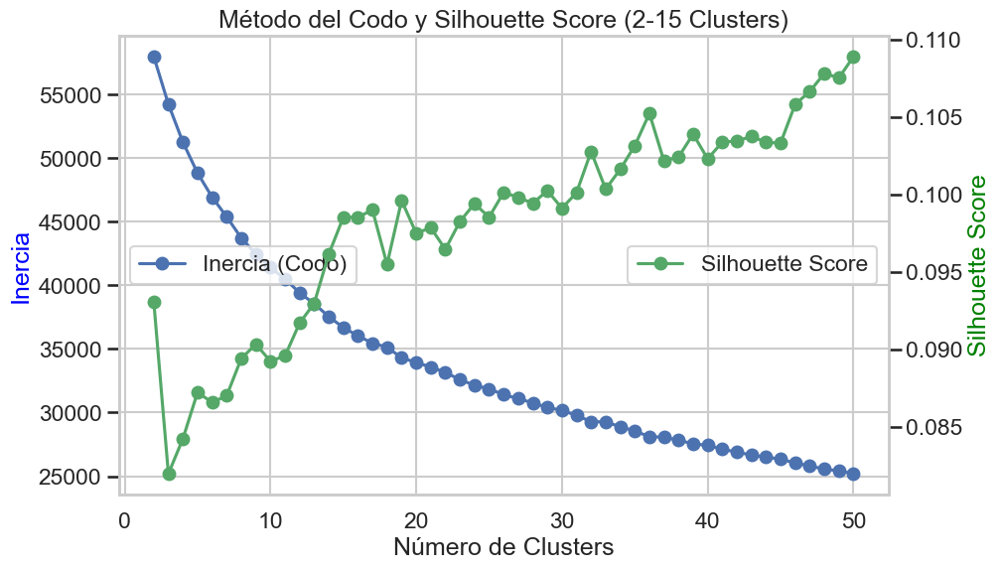

C:\Users\mikel\AppData\Local\Temp\ipykernel_16516\1295763338.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_cluster["Cluster"] = kmeans.fit_predict(data_scaled)


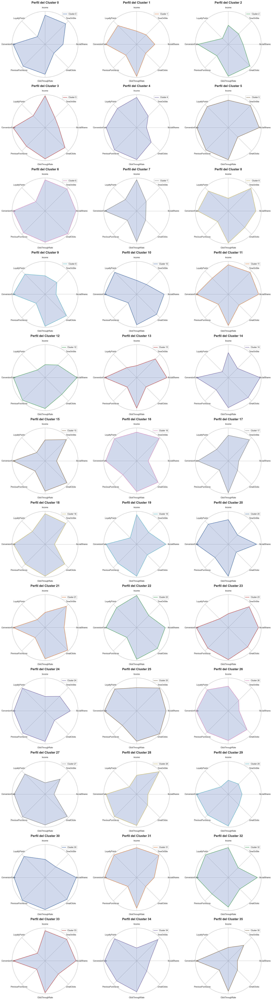

In [160]:
# Filtrar las columnas relevantes
variables_cluster = ["Income", "TimeOnSite", "SocialShares", "EmailClicks","ClickThroughRate", "PreviousPurchases", "ConversionRate", "LoyaltyPoints"]
data_cluster = df_encoded[variables_cluster]

# Escalar las variables
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_cluster)

# Determinar el número óptimo de clusters con el método del codo y silhouette score
inertia = []
silhouette_scores = []
max_clusters = 50

for k in range(2, max_clusters + 1):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(data_scaled)
    inertia.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(data_scaled, kmeans.labels_))

# Gráfico combinado: Método del Codo y Silhouette Score
fig, ax1 = plt.subplots(figsize=(10, 6))
ax2 = ax1.twinx()

ax1.plot(range(2, max_clusters + 1), inertia, 'o-b', label='Inercia (Codo)')
ax2.plot(range(2, max_clusters + 1), silhouette_scores, 'o-g', label='Silhouette Score')

ax1.set_xlabel("Número de Clusters")
ax1.set_ylabel("Inercia", color="blue")
ax2.set_ylabel("Silhouette Score", color="green")
plt.title("Método del Codo y Silhouette Score (2-15 Clusters)")
ax1.legend(loc="center left")
ax2.legend(loc="center right")
plt.grid()
plt.show()

# Elegir el número óptimo de clusters
optimal_k = 36
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
data_cluster["Cluster"] = kmeans.fit_predict(data_scaled)

# Crear promedios por cluster
cluster_means_scaled = data_cluster.groupby("Cluster").mean()

# Excluir la columna de 'Cluster' antes de desescalar
cluster_means_scaled = cluster_means_scaled[variables_cluster]

# Desescalar los promedios
cluster_means = pd.DataFrame(
    scaler.inverse_transform(cluster_means_scaled),
    columns=variables_cluster,
    index=cluster_means_scaled.index
)

# Normalizar los valores promedio desescalados
cluster_means_normalized = cluster_means / cluster_means.max()

# Configuración para Spider Plot en filas de 3
categories = cluster_means.columns
num_vars = len(categories)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Cerrar el círculo

# Configuración del número de filas y columnas
cols = 3  # Máximo de gráficos por fila
rows = (optimal_k + cols - 1) // cols  # Calcular filas necesarias
fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 6), subplot_kw=dict(polar=True))

# Asegurarse de que los ejes sean unidimensionales para iterar
axes = axes.flatten()

for cluster in range(optimal_k):
    # Seleccionar el eje correspondiente
    ax = axes[cluster]

    # Valores del cluster actual
    values = cluster_means_normalized.iloc[cluster].values.flatten().tolist()
    values += values[:1]  # Cerrar el círculo

    # Añadir datos del cluster
    ax.plot(angles, values, label=f"Cluster {cluster}", linewidth=2, color=f"C{cluster}")
    ax.fill(angles, values, alpha=0.25)

    # Configuración del gráfico
    ax.set_theta_offset(np.pi / 2)
    ax.set_theta_direction(-1)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(categories, fontsize=10)
    ax.set_yticks([])
    ax.set_title(f"Perfil del Cluster {cluster}", size=16, fontweight="bold", y=1.1)

    # Leyenda
    ax.legend(loc="upper right", fontsize=10)

# Eliminar ejes vacíos si los clusters no llenan la última fila
for i in range(optimal_k, len(axes)):
    fig.delaxes(axes[i])

# Ajustar el espaciado para evitar solapamientos
plt.tight_layout()
plt.show()

### **Selección de 36 Clusters y Variables Clave**
(Con el fin de buscar interpretabilidad en especial de variables 'ConversionRate' y 'LoyaltyPoints')

#### **Selección de Número de Clusters**
He optado por seleccionar **36 clusters** a pesar de que el método del codo (inercia) sugiere que 7-8 clusters podrían ser suficientes para capturar gran parte de la estructura de los datos. La decisión está fundamentada en los siguientes puntos:

1. **Mayor Explicabilidad:**
   - Elegir 36 clusters permite obtener una segmentación más granular y específica, lo que facilita un análisis detallado de los diferentes comportamientos y perfiles de clientes.
   - Esto es especialmente útil en contextos donde se requiere una comprensión más profunda para diseñar estrategias personalizadas o detectar subgrupos relevantes.

2. **Preservación de la Complejidad de los Datos:**
   - Reducir el número de clusters a 7-8 podría simplificar el análisis, pero correría el riesgo de perder información valiosa, especialmente en casos donde las diferencias entre subgrupos son sutiles pero importantes.

3. **Balance entre Complejidad y Utilidad:**
   - Aunque un menor número de clusters podría facilitar la interpretación global, los 36 clusters seleccionados aportan un nivel de detalle suficiente para cubrir el propósito del análisis sin generar excesiva complejidad.

---

#### **Variables Incluidas**
Para realizar el análisis, he seleccionado las siguientes variables clave, que considero fundamentales segun el analisis de "feature importance", eliminando algunas redundantes "TimeOnSite" (WebsiteVisit, PagesPerVisit), "EmailClicks" (EmailOpens) para facilitar su interpretabilidad en los "spiderplots", todo el fin de caracterizar los clusters y entender los comportamientos de los clientes:

1. **Income (Ingreso):**
   - Es esencial para identificar el nivel adquisitivo de los clientes, que puede influir directamente en sus patrones de compra y conversión.

2. **ClickThroughRate (CTR):**
   - Refleja la efectividad de las interacciones iniciales, ayudando a identificar qué clientes están más comprometidos en las primeras fases del embudo de conversión.

3. **TimeOnSite:**
   - Mide el tiempo que los usuarios pasan en la plataforma, una métrica clave para determinar el nivel de interés o compromiso.

4. **SocialShares:**
   - Capta el impacto social de los clientes, ayudando a identificar a aquellos con mayor influencia en la generación de tráfico y recomendaciones.

5. **EmailClicks:**
   - Evalúa la interacción de los clientes con las campañas de email marketing, una estrategia clave para fomentar conversiones.

6. **PreviousPurchases:**
   - Analiza el historial de compras de los clientes, permitiendo distinguir entre clientes recurrentes y nuevos.

7. **ConversionRate:**
   - He detectado que esta métrica es generalista, ya que se refiere a toda reacción positiva a las acciones de marketing. Esto la convierte en una variable útil para captar un panorama amplio del comportamiento de los clientes, pero no permite diferenciar tipos específicos de conversiones.

8. **LoyaltyPoints:**
   - Esta variable parece ser incongruente con los comportamientos reales de los clientes. Esto probablemente se deba a que la asignación de los puntos está basada en un criterio subjetivo, definido por una persona con posibles sesgos. Sin embargo, he decidido incluirla para evaluar su influencia potencial y corroborar estas observaciones.

---

#### **Conclusión**
La elección de **36 clusters** se justifica por la necesidad de maximizar la explicabilidad y obtener un análisis granular de los diferentes perfiles de clientes. Las variables seleccionadas combinan métricas de conversión, engagement y lealtad con indicadores relevantes como ingresos y comportamiento histórico, asegurando que los clusters resultantes reflejen patrones significativos y accionables. Además, la inclusión de **ConversionRate** como métrica generalista y de **LoyaltyPoints**, pese a sus posibles sesgos, permite evaluar su impacto y confirmar sus limitaciones en el análisis.

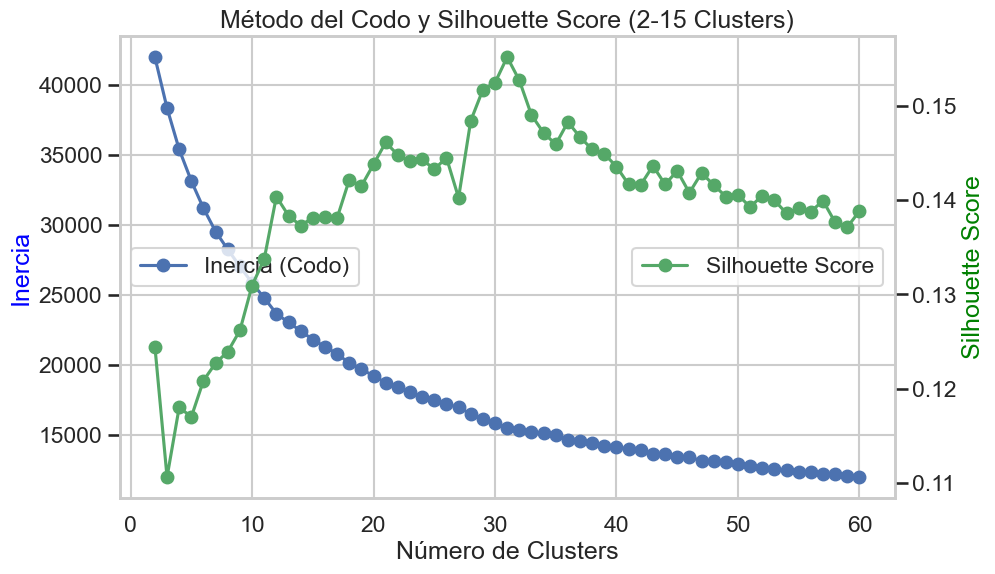

C:\Users\mikel\AppData\Local\Temp\ipykernel_16516\2115248697.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_cluster["Cluster"] = kmeans.fit_predict(data_scaled)


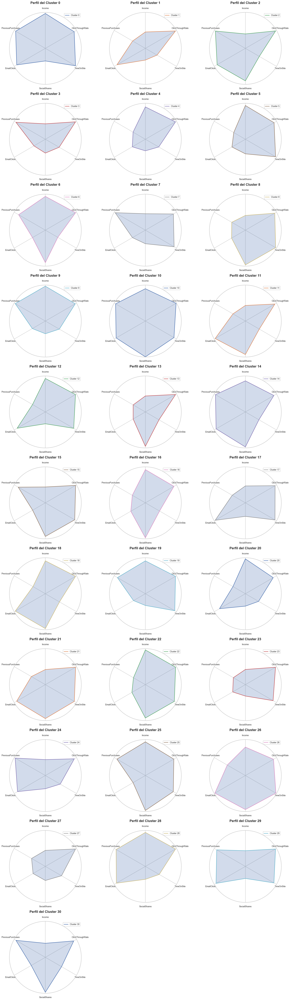

In [161]:
# Filtrar las columnas relevantes
variables_cluster = ["Income", "ClickThroughRate", "TimeOnSite", "SocialShares", "EmailClicks", "PreviousPurchases"]
data_cluster = df_encoded[variables_cluster]

# Escalar las variables
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data_cluster)

# Determinar el número óptimo de clusters con el método del codo y silhouette score
inertia = []
silhouette_scores = []
max_clusters = 60

for k in range(2, max_clusters + 1):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(data_scaled)
    inertia.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(data_scaled, kmeans.labels_))

# Gráfico combinado: Método del Codo y Silhouette Score
fig, ax1 = plt.subplots(figsize=(10, 6))
ax2 = ax1.twinx()

ax1.plot(range(2, max_clusters + 1), inertia, 'o-b', label='Inercia (Codo)')
ax2.plot(range(2, max_clusters + 1), silhouette_scores, 'o-g', label='Silhouette Score')

ax1.set_xlabel("Número de Clusters")
ax1.set_ylabel("Inercia", color="blue")
ax2.set_ylabel("Silhouette Score", color="green")
plt.title("Método del Codo y Silhouette Score (2-15 Clusters)")
ax1.legend(loc="center left")
ax2.legend(loc="center right")
plt.grid()
plt.show()

# Elegir el número óptimo de clusters
optimal_k = 31
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
data_cluster["Cluster"] = kmeans.fit_predict(data_scaled)

# Crear promedios por cluster
cluster_means_scaled = data_cluster.groupby("Cluster").mean()

# Excluir la columna de 'Cluster' antes de desescalar
cluster_means_scaled = cluster_means_scaled[variables_cluster]

# Desescalar los promedios
cluster_means = pd.DataFrame(
    scaler.inverse_transform(cluster_means_scaled),
    columns=variables_cluster,
    index=cluster_means_scaled.index
)

# Normalizar los valores promedio desescalados
cluster_means_normalized = cluster_means / cluster_means.max()

# Configuración para Spider Plot en filas de 3
categories = cluster_means.columns
num_vars = len(categories)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
angles += angles[:1]  # Cerrar el círculo

# Configuración del número de filas y columnas
cols = 3  # Máximo de gráficos por fila
rows = (optimal_k + cols - 1) // cols  # Calcular filas necesarias
fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 6), subplot_kw=dict(polar=True))

# Asegurarse de que los ejes sean unidimensionales para iterar
axes = axes.flatten()

for cluster in range(optimal_k):
    # Seleccionar el eje correspondiente
    ax = axes[cluster]

    # Valores del cluster actual
    values = cluster_means_normalized.iloc[cluster].values.flatten().tolist()
    values += values[:1]  # Cerrar el círculo

    # Añadir datos del cluster
    ax.plot(angles, values, label=f"Cluster {cluster}", linewidth=2, color=f"C{cluster}")
    ax.fill(angles, values, alpha=0.25)

    # Configuración del gráfico
    ax.set_theta_offset(np.pi / 2)
    ax.set_theta_direction(-1)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(categories, fontsize=10)
    ax.set_yticks([])
    ax.set_title(f"Perfil del Cluster {cluster}", size=16, fontweight="bold", y=1.1)

    # Leyenda
    ax.legend(loc="upper right", fontsize=10)

# Eliminar ejes vacíos si los clusters no llenan la última fila
for i in range(optimal_k, len(axes)):
    fig.delaxes(axes[i])

# Ajustar el espaciado para evitar solapamientos
plt.tight_layout()
plt.show()

### **Selección de 31 Clusters y Variables Clave**
(Eliminando la sesgada "LoyaltyPoints" y genereralista "ConversionRate" para mejorar interpretabilidad y facilitar la asignacion de clusters a campañas y canales especificos posteriormente)

#### **Selección de Número de Clusters**
He optado por seleccionar **31 clusters** con el objetivo de obtener una segmentación granular que permita un análisis más específico y explicativo de los diferentes grupos de clientes. Aunque 7-8 clusters podrían ser suficientes para capturar gran parte de la estructura según el método del codo (inercia), priorizo la mayor explicabilidad de los clusters y su utilidad práctica para diseñar campañas personalizadas.

---

#### **Variables Incluidas en la Nueva Clusterización**
En esta nueva clusterización, he reducido y refinado las variables utilizadas basándome exclusivamente en métricas relacionadas con el comportamiento de los clientes y su importancia relativa según el análisis de Feature Importance. He eliminado métricas redundantes y aquellas que presentaban limitaciones conceptuales, como se detalla a continuación:

1. **Variables Incluidas:**
   - **Income (Ingreso):** Refleja el nivel adquisitivo de los clientes, un factor clave para determinar sus patrones de gasto y su respuesta a campañas específicas.
   - **ClickThroughRate (CTR):** Evalúa la efectividad de las interacciones iniciales y mide el nivel de compromiso temprano de los clientes con las campañas.
   - **TimeOnSite:** Representa el tiempo invertido en la plataforma, un indicador directo del nivel de interés y engagement de los usuarios.
   - **SocialShares:** Capta el impacto social y la capacidad de los clientes para generar tráfico e influencia a través de redes sociales.
   - **EmailClicks:** Mide la interacción directa con campañas de email marketing, crucial para evaluar la efectividad de este canal.
   - **PreviousPurchases:** Analiza el historial de compras, lo que permite diferenciar entre clientes nuevos y recurrentes y medir su lealtad.

2. **Variables Eliminadas:**
   - **ConversionRate:** Excluida por ser una métrica generalista que abarca todas las reacciones positivas a las acciones de marketing, lo que dificulta el análisis específico de comportamientos diferenciados.
   - **LoyaltyPoints:** Eliminada debido a su inconsistencia con los comportamientos reales de los clientes, probablemente porque su asignación está basada en criterios subjetivos y sesgados.
   - **EmailOpens, WebsiteVisits y PagesPerVisit:** Eliminadas por redundancia con las variables seleccionadas. Estas métricas tienen correlación con otras incluidas como **EmailClicks** y **TimeOnSite**, por lo que no aportan valor adicional al análisis.

---

#### **Objetivo del Nuevo Análisis**
El objetivo de esta simplificación es **objetivizar y optimizar el análisis de los diferentes grupos de clientes**, reduciendo la complejidad sin perder información clave. Esta nueva configuración permite:

1. **Segmentación Más Clara:**
   - Basada en métricas específicas del comportamiento del cliente, lo que facilita entender sus patrones de interacción y compra.

2. **Selección de Estrategias:**
   - Identificar de manera precisa el tipo de campaña (promocional, de engagement, etc.) y los canales (email, social media, etc.) más efectivos para cada cluster.

3. **Evitar Redundancias:**
   - Eliminar variables redundantes mejora la interpretabilidad de los clusters y asegura un análisis más conciso y enfocado.

---

#### **Conclusión**
La nueva clusterización con **31 clusters** y un conjunto de variables más reducido y relevante ofrece una segmentación más específica y objetiva. Este enfoque simplificado, centrado en métricas directamente relacionadas con el comportamiento del cliente, permite diseñar campañas y estrategias optimizadas para cada cluster, maximizando el impacto en los diferentes segmentos del público objetivo.


In [162]:
data_cluster.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Income             8000 non-null   int64  
 1   ClickThroughRate   8000 non-null   float64
 2   TimeOnSite         8000 non-null   float64
 3   SocialShares       8000 non-null   int64  
 4   EmailClicks        8000 non-null   int64  
 5   PreviousPurchases  8000 non-null   int64  
 6   Cluster            8000 non-null   int32  
dtypes: float64(2), int32(1), int64(4)
memory usage: 406.4 KB


In [163]:
# Asegurarnos de que CustomerID esté en data_cluster
data_cluster["CustomerID"] = df_encoded["CustomerID"]

# Validar la asignación: comparar algunas filas de data_cluster con df_encoded
print("Validando asignación de CustomerID...")
print("Primeras filas de data_cluster:")
print(data_cluster.head())

print("\nPrimeras filas relevantes de df_encoded:")
print(df_encoded[["CustomerID", "Income", "ClickThroughRate"]].head())

# Comprobar si CustomerID está correctamente alineado
valid = all(data_cluster["Income"] == df_encoded["Income"])
if valid:
    print("\n✔️ La asignación de CustomerID es correcta y los datos están alineados.")
else:
    print("\n❌ Hay discrepancias en los datos. Revisa el orden de las filas o el origen de data_cluster.")

Validando asignación de CustomerID...
Primeras filas de data_cluster:
   Income  ClickThroughRate  TimeOnSite  SocialShares  EmailClicks  \
0  136912          0.043919    7.396803            19            9   
1   41760          0.155725    5.352549             5            7   
2   88456          0.277490   13.794901             0            2   
3   44085          0.137611   14.688363            89            2   
4   83964          0.252851   13.993370             6            6   

   PreviousPurchases  Cluster  CustomerID  
0                  4       20        8000  
1                  2        1        8001  
2                  8       19        8002  
3                  0        8        8003  
4                  8       29        8004  

Primeras filas relevantes de df_encoded:
   CustomerID  Income  ClickThroughRate
0        8000  136912          0.043919
1        8001   41760          0.155725
2        8002   88456          0.277490
3        8003   44085          0.137611
4  

C:\Users\mikel\AppData\Local\Temp\ipykernel_16516\4291511284.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_cluster["CustomerID"] = df_encoded["CustomerID"]


In [164]:
# --- Asignación manual de CampaignType y CampaignChannel ---
# Diccionario para asignación de CampaignType por cluster
manual_campaign_types = {
    0: "Retention",
    1: "Conversion",
    2: "Retention",
    3: "Conversion",
    4: "Conversion",
    5: "Conversion",
    6: "Retention",
    7: "Retention",
    8: "Consideration",
    9: "Retention",
    10: "Retention",
    11: "Conversion",
    12: "Conversion",
    13: "Conversion",
    14: "Retention",
    15: "Retention",
    16: "Conversion",
    17: "Conversion",
    18: "Conversion",
    19: "Retention",
    20: "Conversion",
    21: "Conversion",
    22: "Conversion",
    23: "Consideration",
    24: "Retention",
    25: "Retention",
    26: "Conversion",
    27: "Conversion",
    28: "Retention",
    29: "Retention",
    30: "Retention",
}

# Diccionario para asignación de CampaignChannel por cluster
manual_campaign_channels = {
    0: "Email",
    1: "Email",
    2: "Social Media",
    3: "PPC",
    4: "PPC",
    5: "PPC",
    6: "Social Media",
    7: "PPC",
    8: "Social Media",
    9: "PPC",
    10: "Email",
    11: "Email",
    12: "Email",
    13: "Social Media",
    14: "Email",
    15: "Social Media",
    16: "Social Media",
    17: "Email",
    18: "Social Media",
    19: "PPC",
    20: "Email",
    21: "Social Media",
    22: "Social Media",
    23: "Email",
    24: "Email",
    25: "Email",
    26: "Social Media",
    27: "Social Media",
    28: "Email",
    29: "Email",
    30: "Email",
}

# Copiar df_encoded a df_encoded_mod
df_encoded_mod = df_encoded.copy()

# Inicializar todas las columnas CampaignChannel_xxx y CampaignType_xxx en False en df_encoded_mod
campaign_channels = ["Email", "PPC", "Referral", "SEO", "Social Media"]
for channel in campaign_channels:
    df_encoded_mod[f"CampaignChannel_{channel}"] = False

campaign_types = ["Awareness", "Consideration", "Conversion", "Retention"]
for campaign in campaign_types:
    df_encoded_mod[f"CampaignType_{campaign}"] = False

# Iterar sobre cada cluster y asignar True a las columnas correspondientes en df_encoded_mod
for cluster, campaign_type in manual_campaign_types.items():
    # Obtener CustomerIDs del cluster actual
    cluster_customers = data_cluster[data_cluster["Cluster"] == cluster]["CustomerID"]

    # Asignar CampaignType
    df_encoded_mod.loc[
        df_encoded_mod["CustomerID"].isin(cluster_customers),
        f"CampaignType_{campaign_type}"
    ] = True

for cluster, campaign_channel in manual_campaign_channels.items():
    # Obtener CustomerIDs del cluster actual
    cluster_customers = data_cluster[data_cluster["Cluster"] == cluster]["CustomerID"]

    # Asignar CampaignChannel
    df_encoded_mod.loc[
        df_encoded_mod["CustomerID"].isin(cluster_customers),
        f"CampaignChannel_{campaign_channel}"
    ] = True

# --- Validación ---
print("Validación de asignaciones:")
print("Ejemplo de asignaciones en data_cluster:")
print(data_cluster[["CustomerID", "Cluster"]].head())

print("\nDistribución de CampaignType en df_encoded_mod:")
print(df_encoded_mod[[f"CampaignType_{campaign}" for campaign in campaign_types]].sum())

print("\nDistribución de CampaignChannel en df_encoded_mod:")
print(df_encoded_mod[[f"CampaignChannel_{channel}" for channel in campaign_channels]].sum())

Validación de asignaciones:
Ejemplo de asignaciones en data_cluster:
   CustomerID  Cluster
0        8000       20
1        8001        1
2        8002       19
3        8003        8
4        8004       29

Distribución de CampaignType en df_encoded_mod:
CampaignType_Awareness           0
CampaignType_Consideration     490
CampaignType_Conversion       3927
CampaignType_Retention        3583
dtype: int64

Distribución de CampaignChannel en df_encoded_mod:
CampaignChannel_Email           3595
CampaignChannel_PPC             1506
CampaignChannel_Referral           0
CampaignChannel_SEO                0
CampaignChannel_Social Media    2899
dtype: int64



Número de clientes asignados a cada cluster:
Cluster
0     239
1     280
2     249
3     261
4     252
5     240
6     287
7     257
8     252
9     241
10    210
11    267
12    261
13    254
14    255
15    234
16    265
17    264
18    266
19    255
20    225
21    246
22    275
23    238
24    259
25    255
26    310
27    261
28    271
29    270
30    301
Name: count, dtype: int64


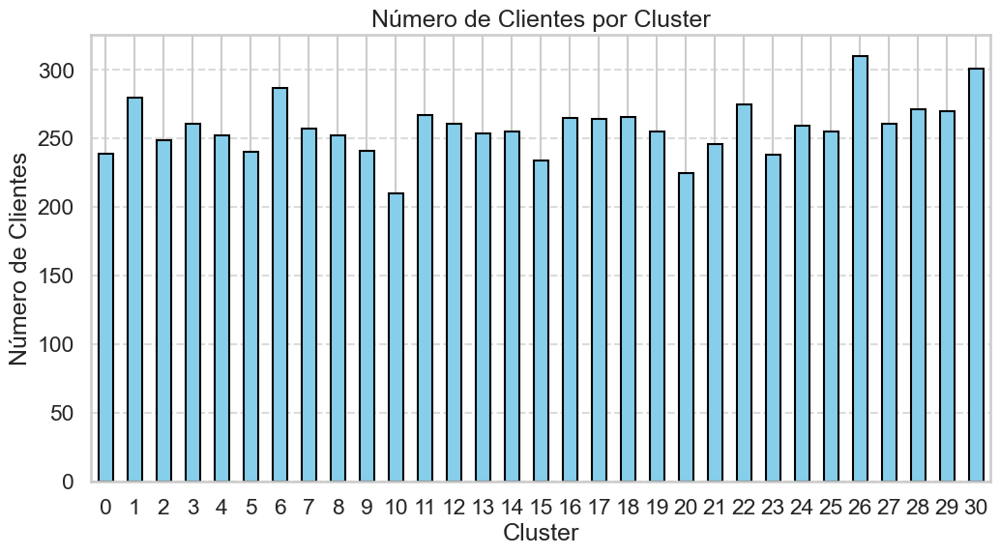

In [165]:
# --- Número de clientes asignados a cada cluster ---
cluster_counts = data_cluster["Cluster"].value_counts().sort_index()

print("\nNúmero de clientes asignados a cada cluster:")
print(cluster_counts)

# Visualización de la distribución por cluster
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
cluster_counts.plot(kind="bar", color="skyblue", edgecolor="black")
plt.title("Número de Clientes por Cluster")
plt.xlabel("Cluster")
plt.ylabel("Número de Clientes")
plt.xticks(rotation=0)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()


In [166]:
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 26 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   CustomerID                    8000 non-null   int64  
 1   Age                           8000 non-null   int64  
 2   Income                        8000 non-null   int64  
 3   AdSpend                       8000 non-null   float64
 4   ClickThroughRate              8000 non-null   float64
 5   ConversionRate                8000 non-null   float64
 6   WebsiteVisits                 8000 non-null   int64  
 7   PagesPerVisit                 8000 non-null   float64
 8   TimeOnSite                    8000 non-null   float64
 9   SocialShares                  8000 non-null   int64  
 10  EmailOpens                    8000 non-null   int64  
 11  EmailClicks                   8000 non-null   int64  
 12  PreviousPurchases             8000 non-null   int64  
 13  Loy

In [167]:
df_encoded_mod = df_encoded_mod.drop(columns=['Conversion'])

In [168]:
df_encoded_mod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 25 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   CustomerID                    8000 non-null   int64  
 1   Age                           8000 non-null   int64  
 2   Income                        8000 non-null   int64  
 3   AdSpend                       8000 non-null   float64
 4   ClickThroughRate              8000 non-null   float64
 5   ConversionRate                8000 non-null   float64
 6   WebsiteVisits                 8000 non-null   int64  
 7   PagesPerVisit                 8000 non-null   float64
 8   TimeOnSite                    8000 non-null   float64
 9   SocialShares                  8000 non-null   int64  
 10  EmailOpens                    8000 non-null   int64  
 11  EmailClicks                   8000 non-null   int64  
 12  PreviousPurchases             8000 non-null   int64  
 13  Loy

## **MODELO DE PREDICCIÓN DE CAMPAÑAS MANUAL**
(La selección del tipo de campaña y canal debe realizarse manualmente en base a los clusters mostrados en los spider plots y al criterio de negocio de un especialista en marketing digital. Además, se recomienda consultar los otros notebooks específicos por campaña para obtener un enfoque más detallado, o bien utilizar la clusterización del presente notebook para aplicar un enfoque más general.)

### Predictor y asignador de gasto publicitario basado en comportamiento del cliente

In [169]:
# --- Predicción de AdSpend con GridSearch ---

# Importar librerías necesarias
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor

# Función para suavizar outliers usando IQR (Interquartile Range)
def smooth_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    df[column] = df[column].clip(lower=lower_bound, upper=upper_bound)
    return df

# Datos de entrenamiento: campaña anterior
X_adspend = df_encoded.drop(columns=["AdSpend", "CustomerID", "Conversion", 'ConversionRate', 'LoyaltyPoints', 'ClickThroughRate'], errors="ignore")
y_adspend = df_encoded["AdSpend"]

# Suavizar outliers en el target AdSpend
df_encoded_smooth = df_encoded.copy()
df_encoded_smooth = smooth_outliers(df_encoded_smooth, "AdSpend")
y_adspend = df_encoded_smooth["AdSpend"]

# División en entrenamiento y prueba
X_train_adspend, X_test_adspend, y_train_adspend, y_test_adspend = train_test_split(
    X_adspend, y_adspend, test_size=0.2, random_state=42
)

# Escalar los datos de entrenamiento
scaler_adspend = StandardScaler()
X_train_adspend_scaled = scaler_adspend.fit_transform(X_train_adspend)
X_test_adspend_scaled = scaler_adspend.transform(X_test_adspend)

# Modelos de regresión
regressors = {
    "RandomForest": RandomForestRegressor(random_state=42),
    "GradientBoosting": GradientBoostingRegressor(random_state=42),
    "XGBoost": XGBRegressor(random_state=42, objective='reg:squarederror')
}

param_grid = {
    "RandomForest": {
        "n_estimators": [50, 100, 150],
        "max_depth": [3, 4, 5],
        "min_samples_split": [3, 5, 10]
    },
    "GradientBoosting": {
        "n_estimators": [50, 100, 150],
        "learning_rate": [0.01, 0.1, 0.2],
        "max_depth": [3, 5, 7]
    },
    "XGBoost": {
        "n_estimators": [50, 100, 150],
        "learning_rate": [0.01, 0.1, 0.2],
        "max_depth": [3, 5, 7]
    }
}

# Buscar el mejor modelo
best_regressor = None
best_score = float('inf')

for name, model in regressors.items():
    grid_search = GridSearchCV(
        model, param_grid[name], cv=3, scoring="neg_mean_squared_error", n_jobs=-1
    )
    grid_search.fit(X_train_adspend_scaled, y_train_adspend)
    
    if -grid_search.best_score_ < best_score:
        best_score = -grid_search.best_score_
        best_regressor = grid_search.best_estimator_
        best_model_name = name

print(f"Mejor modelo para AdSpend: {best_model_name}")
print(f"Mejor MSE: {best_score:.2f}")
print(f"Mejores hiperparámetros: {grid_search.best_params_}")

# Datos de predicción: nueva campaña
X_mod = df_encoded_mod.drop(columns=["AdSpend", "CustomerID", "Conversion", 'ConversionRate', 'LoyaltyPoints', 'ClickThroughRate'], errors="ignore")

# Escalar los datos de la nueva campaña con el mismo scaler
X_mod_scaled = scaler_adspend.transform(X_mod)

# Predicción de AdSpend para la nueva campaña
df_encoded_mod["AdSpend"] = best_regressor.predict(X_mod_scaled)

# Suavizar outliers en las predicciones de AdSpend
df_encoded_mod = smooth_outliers(df_encoded_mod, "AdSpend")

# Redistribuir AdSpend para que coincida con la estadística de los datos originales
mean_original = y_adspend.mean()
std_original = y_adspend.std()

# Ajustar las predicciones para que tengan la misma media y desviación estándar
df_encoded_mod["AdSpend"] = (
    (df_encoded_mod["AdSpend"] - df_encoded_mod["AdSpend"].mean()) / df_encoded_mod["AdSpend"].std()
) * std_original + mean_original

# Ajustar el gasto total para mantener proporciones similares
original_total = y_adspend.sum()  # Total original conocido
modified_total = df_encoded_mod["AdSpend"].sum()  # Total predicho
scaling_factor = original_total / modified_total
df_encoded_mod["AdSpend"] *= scaling_factor

# Mostrar las primeras filas del DataFrame ajustado
print(df_encoded_mod.head())

# Evaluación del modelo en datos de entrenamiento y prueba
train_mse = mean_squared_error(y_train_adspend, best_regressor.predict(X_train_adspend_scaled))
test_mse = mean_squared_error(y_test_adspend, best_regressor.predict(X_test_adspend_scaled))
print(f"\nMSE en Train: {train_mse:.2f}")
print(f"MSE en Test: {test_mse:.2f}")


Mejor modelo para AdSpend: RandomForest
Mejor MSE: 8049125.63
Mejores hiperparámetros: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 50}
   CustomerID  Age  Income      AdSpend  ClickThroughRate  ConversionRate  \
0        8000   56  136912  6958.012165          0.043919        0.088031   
1        8001   69   41760  4421.239623          0.155725        0.182725   
2        8002   46   88456  -279.847076          0.277490        0.076423   
3        8003   32   44085  3871.224340          0.137611        0.088004   
4        8004   60   83964   693.755932          0.252851        0.109940   

   WebsiteVisits  PagesPerVisit  TimeOnSite  SocialShares  EmailOpens  \
0              0       2.399017    7.396803            19           6   
1             42       2.917138    5.352549             5           2   
2              2       8.223619   13.794901             0          11   
3             47       4.540939   14.688363            89           2   
4              0       2.


--- Métricas de Regresión en Train ---
MAE: 2438.88
R^2: 0.02

--- Métricas de Regresión en Test ---
MAE: 2484.91
R^2: -0.01

--- Métricas de Clasificación en Train ---
Precision: 0.57
Recall: 0.54
F1 Score: 0.56
Balanced Accuracy: 0.56

--- Métricas de Clasificación en Test ---
Precision: 0.48
Recall: 0.46
F1 Score: 0.47
Balanced Accuracy: 0.49


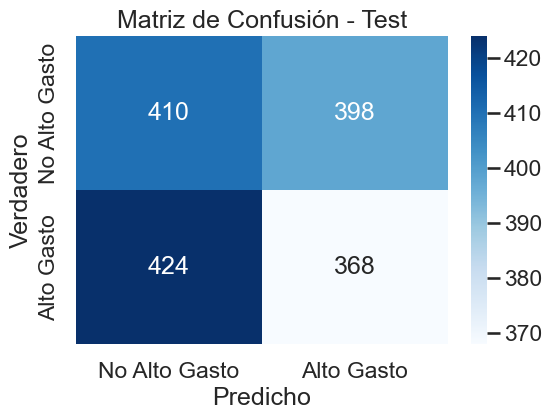

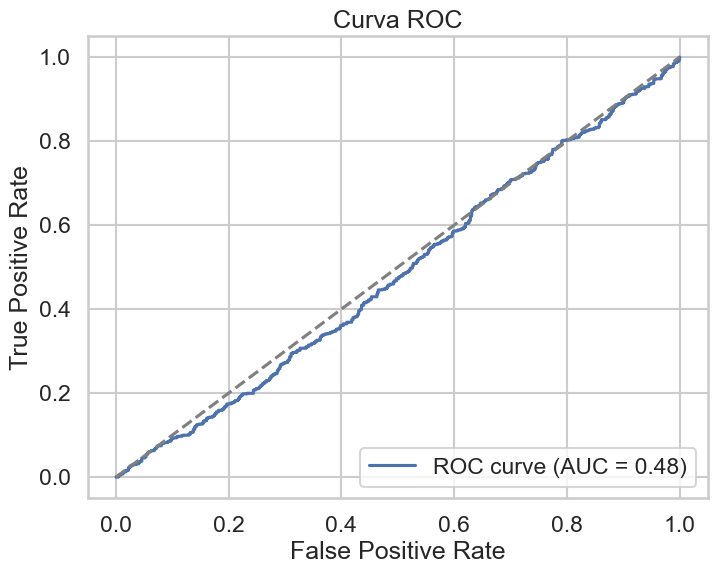

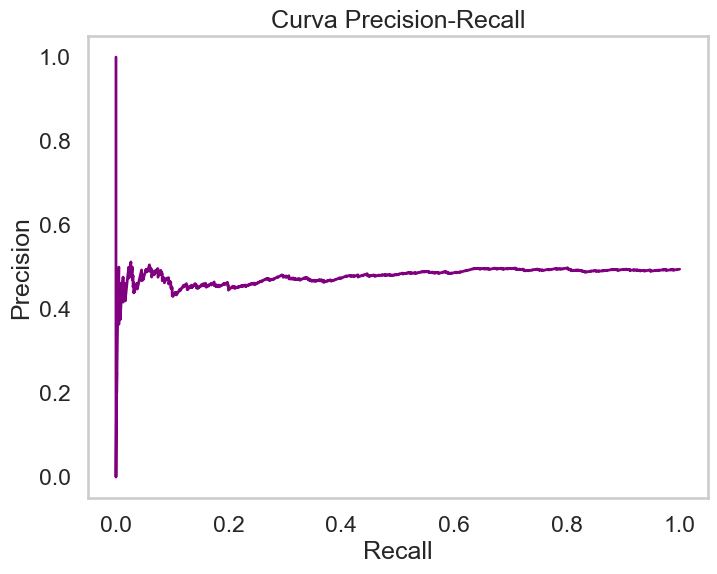

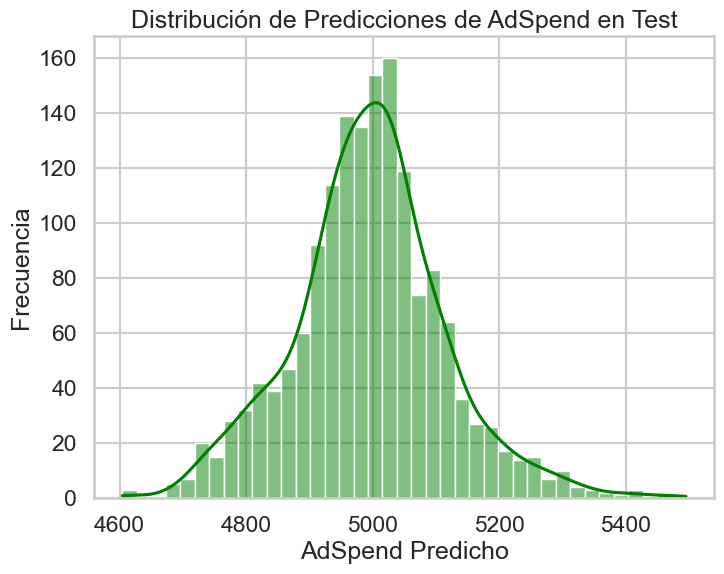

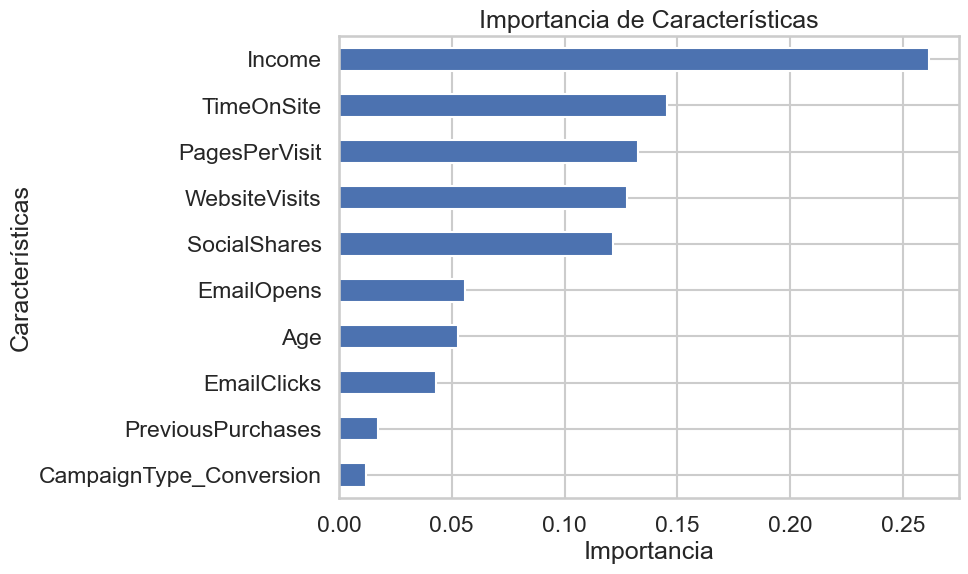

In [170]:
# Importar librerías necesarias
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score, roc_curve, precision_recall_curve, confusion_matrix, balanced_accuracy_score
import matplotlib.pyplot as plt
import seaborn as sns

# --- Evaluación del Modelo ---

# Predicciones en conjunto de entrenamiento y prueba
y_train_pred = best_regressor.predict(X_train_adspend_scaled)
y_test_pred = best_regressor.predict(X_test_adspend_scaled)

# Cálculo de métricas de regresión
train_mae = mean_absolute_error(y_train_adspend, y_train_pred)
test_mae = mean_absolute_error(y_test_adspend, y_test_pred)
train_r2 = r2_score(y_train_adspend, y_train_pred)
test_r2 = r2_score(y_test_adspend, y_test_pred)

print("\n--- Métricas de Regresión en Train ---")
print(f"MAE: {train_mae:.2f}")
print(f"R^2: {train_r2:.2f}")

print("\n--- Métricas de Regresión en Test ---")
print(f"MAE: {test_mae:.2f}")
print(f"R^2: {test_r2:.2f}")

# Si deseas convertir el problema en clasificación (por ejemplo, predecir si AdSpend está por encima de un umbral)
# Aquí usaremos el valor medio de AdSpend como umbral (esto es solo un ejemplo)
threshold = y_adspend.mean()
y_train_class = (y_train_adspend >= threshold).astype(int)
y_test_class = (y_test_adspend >= threshold).astype(int)
y_train_pred_class = (y_train_pred >= threshold).astype(int)
y_test_pred_class = (y_test_pred >= threshold).astype(int)

# Métricas de clasificación en Train
train_precision = precision_score(y_train_class, y_train_pred_class)
train_recall = recall_score(y_train_class, y_train_pred_class)
train_f1 = f1_score(y_train_class, y_train_pred_class)
train_bal_acc = balanced_accuracy_score(y_train_class, y_train_pred_class)

# Métricas de clasificación en Test
test_precision = precision_score(y_test_class, y_test_pred_class)
test_recall = recall_score(y_test_class, y_test_pred_class)
test_f1 = f1_score(y_test_class, y_test_pred_class)
test_bal_acc = balanced_accuracy_score(y_test_class, y_test_pred_class)

print("\n--- Métricas de Clasificación en Train ---")
print(f"Precision: {train_precision:.2f}")
print(f"Recall: {train_recall:.2f}")
print(f"F1 Score: {train_f1:.2f}")
print(f"Balanced Accuracy: {train_bal_acc:.2f}")

print("\n--- Métricas de Clasificación en Test ---")
print(f"Precision: {test_precision:.2f}")
print(f"Recall: {test_recall:.2f}")
print(f"F1 Score: {test_f1:.2f}")
print(f"Balanced Accuracy: {test_bal_acc:.2f}")

# Matriz de confusión en Test
test_confusion = confusion_matrix(y_test_class, y_test_pred_class)
plt.figure(figsize=(6, 4))
sns.heatmap(test_confusion, annot=True, fmt="d", cmap="Blues", xticklabels=['No Alto Gasto', 'Alto Gasto'], yticklabels=['No Alto Gasto', 'Alto Gasto'])
plt.title("Matriz de Confusión - Test")
plt.xlabel("Predicho")
plt.ylabel("Verdadero")
plt.show()

# Curva ROC y AUC en Test
y_test_pred_proba = best_regressor.predict(X_test_adspend_scaled)
fpr, tpr, thresholds = roc_curve(y_test_class, y_test_pred_proba)
roc_auc = roc_auc_score(y_test_class, y_test_pred_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC')
plt.legend(loc="lower right")
plt.show()

# Curva Precision-Recall en Test
precision, recall, thresholds_pr = precision_recall_curve(y_test_class, y_test_pred_proba)
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color="purple", lw=2)
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.title("Curva Precision-Recall")
plt.grid()
plt.show()

# Distribución de las predicciones
plt.figure(figsize=(8, 6))
sns.histplot(y_test_pred, kde=True, color='green')
plt.title('Distribución de Predicciones de AdSpend en Test')
plt.xlabel('AdSpend Predicho')
plt.ylabel('Frecuencia')
plt.show()

# Importancia de las características
feature_importances = pd.Series(best_regressor.feature_importances_, index=X_adspend.columns)
feature_importances.nlargest(10).plot(kind='barh', figsize=(8, 6))
plt.title('Importancia de Características')
plt.xlabel('Importancia')
plt.ylabel('Características')
plt.gca().invert_yaxis()
plt.show()

In [171]:
# --- Resumen de gasto de AdSpend ---
original_adspend = df_encoded["AdSpend"].sum()
modified_adspend = df_encoded_mod["AdSpend"].sum()

print("\nGasto total en campañas:")
print(f"Original: {original_adspend:.2f}")
print(f"Modificado: {modified_adspend:.2f}")

# Gasto desglosado por CampaignType
print("\nGasto por CampaignType:")
for campaign in ["Awareness", "Consideration", "Conversion", "Retention"]:
    original_spend = df_encoded.loc[df_encoded[f'CampaignType_{campaign}'] == 1, 'AdSpend'].sum()
    modified_spend = df_encoded_mod.loc[df_encoded_mod[f'CampaignType_{campaign}'] == 1, 'AdSpend'].sum()
    print(f"{campaign}:")
    print(f"  Original: {original_spend:.2f}")
    print(f"  Modificado: {modified_spend:.2f}")

# Gasto desglosado por CampaignChannel
print("\nGasto por CampaignChannel:")
for channel in ["Email", "PPC", "Referral", "SEO", "Social Media"]:
    original_spend = df_encoded.loc[df_encoded[f'CampaignChannel_{channel}'] == 1, 'AdSpend'].sum()
    modified_spend = df_encoded_mod.loc[df_encoded_mod[f'CampaignChannel_{channel}'] == 1, 'AdSpend'].sum()
    print(f"{channel}:")
    print(f"  Original: {original_spend:.2f}")
    print(f"  Modificado: {modified_spend:.2f}")


Gasto total en campañas:
Original: 40007558.64
Modificado: 40007558.64

Gasto por CampaignType:
Awareness:
  Original: 10077845.83
  Modificado: 0.00
Consideration:
  Original: 9861273.67
  Modificado: 1915888.40
Conversion:
  Original: 10300076.98
  Modificado: 20355094.61
Retention:
  Original: 9768362.16
  Modificado: 17736575.63

Gasto por CampaignChannel:
Email:
  Original: 7871575.85
  Modificado: 19091186.98
PPC:
  Original: 8199236.98
  Modificado: 8302354.79
Referral:
  Original: 8653518.69
  Modificado: 0.00
SEO:
  Original: 7740903.88
  Modificado: 0.00
Social Media:
  Original: 7542323.25
  Modificado: 12614016.87


In [172]:
df_encoded_mod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 25 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   CustomerID                    8000 non-null   int64  
 1   Age                           8000 non-null   int64  
 2   Income                        8000 non-null   int64  
 3   AdSpend                       8000 non-null   float64
 4   ClickThroughRate              8000 non-null   float64
 5   ConversionRate                8000 non-null   float64
 6   WebsiteVisits                 8000 non-null   int64  
 7   PagesPerVisit                 8000 non-null   float64
 8   TimeOnSite                    8000 non-null   float64
 9   SocialShares                  8000 non-null   int64  
 10  EmailOpens                    8000 non-null   int64  
 11  EmailClicks                   8000 non-null   int64  
 12  PreviousPurchases             8000 non-null   int64  
 13  Loy

### Predictor de conversiones en nuevos escenarios de negocio

In [173]:
# Cargar pipeline completo
best_pipeline = joblib.load("GradientBoosting_best_pipeline.pkl")
print("\nPipeline cargado: GradientBoosting_best_pipeline.pkl")

# Predicción en la nueva campaña
X_mod = df_encoded_mod.drop(columns=["CustomerID", 'Conversion', 'ConversionRate', 'LoyaltyPoints', 'ClickThroughRate'], errors="ignore")
y_mod_proba = best_pipeline.predict_proba(X_mod)[:, 1]

# Ajuste de probabilidades según el umbral
optimal_threshold = 0.5  # Usar el umbral óptimo o manual
y_mod_pred = (y_mod_proba >= optimal_threshold).astype(int)

# Añadir predicciones al dataset
df_encoded_mod["Conversion"] = y_mod_pred


Pipeline cargado: GradientBoosting_best_pipeline.pkl


### Comparador de campaña original con el nuevo escenario simulado

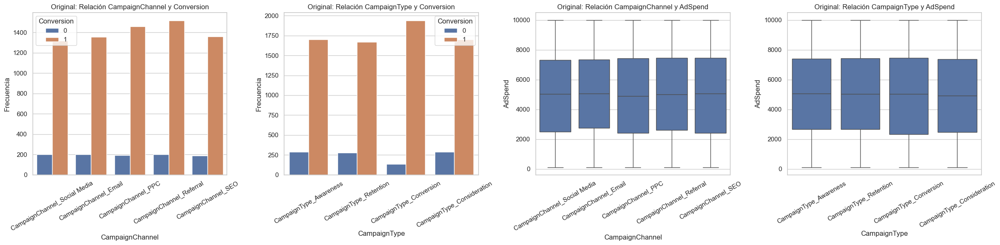

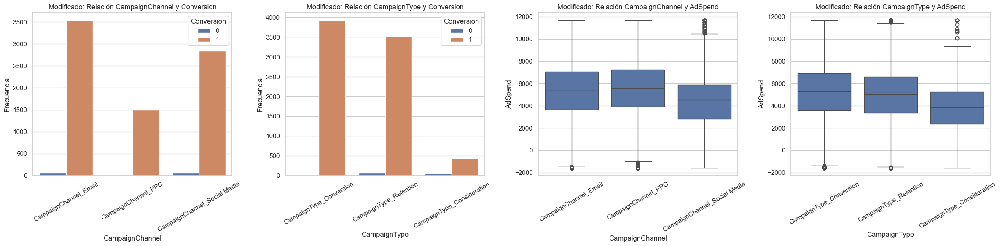

In [174]:
# --- Visualizaciones ---
def create_visualizations(df, title_prefix):
    sns.set(style="whitegrid")
    fig, axes = plt.subplots(1, 4, figsize=(24, 6))  # Una fila con 4 gráficos

    # Gráfico 1: Relación entre CampaignChannel y Conversion
    sns.countplot(data=df, x=df[["CampaignChannel_Email", "CampaignChannel_PPC",
                                 "CampaignChannel_Referral", "CampaignChannel_SEO",
                                 "CampaignChannel_Social Media"]].idxmax(axis=1),
                  hue="Conversion", ax=axes[0])
    axes[0].set_title(f"{title_prefix}: Relación CampaignChannel y Conversion")
    axes[0].set_xlabel("CampaignChannel")
    axes[0].set_ylabel("Frecuencia")
    axes[0].tick_params(axis="x", rotation=30)

    # Gráfico 2: Relación entre CampaignType y Conversion
    sns.countplot(data=df, x=df[["CampaignType_Awareness", "CampaignType_Consideration",
                                 "CampaignType_Conversion", "CampaignType_Retention"]].idxmax(axis=1),
                  hue="Conversion", ax=axes[1])
    axes[1].set_title(f"{title_prefix}: Relación CampaignType y Conversion")
    axes[1].set_xlabel("CampaignType")
    axes[1].set_ylabel("Frecuencia")
    axes[1].tick_params(axis="x", rotation=30)

    # Gráfico 3: Relación entre CampaignChannel y AdSpend
    sns.boxplot(data=df, x=df[["CampaignChannel_Email", "CampaignChannel_PPC",
                               "CampaignChannel_Referral", "CampaignChannel_SEO",
                               "CampaignChannel_Social Media"]].idxmax(axis=1),
                y="AdSpend", ax=axes[2])
    axes[2].set_title(f"{title_prefix}: Relación CampaignChannel y AdSpend")
    axes[2].set_xlabel("CampaignChannel")
    axes[2].set_ylabel("AdSpend")
    axes[2].tick_params(axis="x", rotation=30)

    # Gráfico 4: Relación entre CampaignType y AdSpend
    sns.boxplot(data=df, x=df[["CampaignType_Awareness", "CampaignType_Consideration",
                               "CampaignType_Conversion", "CampaignType_Retention"]].idxmax(axis=1),
                y="AdSpend", ax=axes[3])
    axes[3].set_title(f"{title_prefix}: Relación CampaignType y AdSpend")
    axes[3].set_xlabel("CampaignType")
    axes[3].set_ylabel("AdSpend")
    axes[3].tick_params(axis="x", rotation=30)

    plt.tight_layout()
    plt.show()

# Visualizaciones para datos originales y modificados
create_visualizations(df_encoded, "Original")
create_visualizations(df_encoded_mod, "Modificado")

## **CONCLUSIÓN FINAL**

### **Análisis de la Base de Datos**

Partimos de una base de datos con las siguientes características principales:

- **Columnas disponibles:**
  - **CustomerID:** Identificador único del cliente.
  - **Datos demográficos:** Age, Income.
  - **Comportamiento del cliente:** AdSpend, ClickThroughRate, WebsiteVisits, PagesPerVisit, TimeOnSite, SocialShares, EmailOpens, EmailClicks, PreviousPurchases.
  - **Métricas de campaña:** ConversionRate, LoyaltyPoints.
  - **Objetivo:** Conversion (binaria: conversión o no conversión).

Tras analizar el conjunto de datos y su utilidad para las predicciones, se identificaron problemas clave en ciertas variables:

1. **ConversionRate:**
   - Aunque es importante, resulta conflictiva porque representa un porcentaje general de todas las interacciones positivas (independientemente del canal o campaña). Esto puede llevar a errores al usarla para predecir el impacto de campañas específicas.

2. **LoyaltyPoints:**
   - Basada en criterios subjetivos definidos por la persona que diseñó la campaña original, presenta sesgos que pueden llevar a errores.

Ambas variables (ConversionRate y LoyaltyPoints) fueron útiles para predecir conversiones en la configuración de campaña original, pero su falta de objetividad las hace dudosas para simulaciones de modificaciones sobre la misma.

---

### **Insights del Modelo y Feature Importance**

A través del análisis de **Feature Importance**, identificamos las principales variables que influyen en el comportamiento del cliente y que son relevantes para optimizar campañas:

1. **Variables clave identificadas:**
   - **AdSpend:** Principal palanca para activar el comportamiento del cliente.
   - **TimeOnSite:** Indicador clave de engagement (redundante con WebsiteVisits y PagesPerVisit).
   - **ClickThroughRate:** Refleja la efectividad de interacciones iniciales.
   - **SocialShares:** Muestra la influencia social del cliente.
   - **Income:** Refleja el nivel adquisitivo, clave para segmentación.
   - **PreviousPurchases:** Histórico de compras para medir lealtad.
   - **EmailClicks:** Más representativa que EmailOpens, ya que un clic dentro del contenido del email demuestra una acción concreta hacia nuestra web.

2. **Selección de canales optimizados:**
   - **CampaignChannel_Email, CampaignChannel_PPC, CampaignChannel_Social Media.**
   - Con base en la clusterización realizada, se identificaron estos canales como óptimos para cada segmento de clientes.

3. **Asignación a campañas específicas:**
   - **CampaignType_Awareness, CampaignType_Consideration, CampaignType_Conversion, CampaignType_Retention.**
   - Las asignaciones a campañas específicas se fundamentan en las diferencias observadas en las Feature Importance para cada tipo de campaña.

---

### **Segmentaciones por Campaña**

Aunque el presente análisis se centra en una campaña generalista con enfoque hacia **conversión y retención**, se realizaron estudios específicos por tipo de campaña. Estas segmentaciones muestran cómo la importancia de las variables cambia según el objetivo:

- **CampaignType_Awareness:** Orientada a captar la atención inicial de los clientes.
- **CampaignType_Consideration:** Diseñada para mantener el interés del cliente.
- **CampaignType_Conversion:** Centrada en maximizar las conversiones.
- **CampaignType_Retention:** Enfocada en la fidelización del cliente.

El enfoque principal del presente estudio utiliza los canales más efectivos para la clusterización generalista:
- **CampaignChannel_Email, CampaignChannel_PPC, CampaignChannel_Social Media.**

Para campañas más específicas, se recomienda consultar los notebooks dedicados a cada tipo de campaña:
- [CampaignType Awareness](./pred_conv_md_camp_ml_Awareness.ipynb)
- [CampaignType Consideration](./pred_conv_md_camp_ml_Consideration.ipynb)
- [CampaignType Conversion](./pred_conv_md_camp_ml_Conversion.ipynb)
- [CampaignType Retention](./pred_conv_md_camp_ml_Retention.ipynb)

---

### **Limitaciones del Estudio**

1. **Falta de contexto del negocio:**
   - No se dispone de información sobre qué producto o servicio se vende, ni los márgenes asociados a las compras.
   - Sin estos datos, variables como **Age** y **Gender** pierden relevancia en este análisis.
   - No es posible calcular métricas clave como ROI (No disponemos de valor de compras ni margen) o el coste de adquisición/conversión del cliente (Disponemos de gasto publicitario por cliente pero sin el margen de las compras realizas por el cliente, no podemos calcularlo).

2. **Fotografía puntual:**
   - Los datos representan un momento específico de una campaña, sin una línea temporal para evaluar tendencias o cambios en el comportamiento.

3. **Datos incompletos o sesgados:**
   - Variables como **ConversionRate** y **LoyaltyPoints** son dudosas debido a su carácter generalista o sesgado.

---

### **Conclusión General**

Este estudio resalta la importancia de contar con datos bien estructurados y con un propósito claro. Aunque los modelos predictivos y mecanismos de segmentación están correctamente implementados, los resultados dependen directamente de la calidad de los datos. 

- **Acción recomendada:** Mejorar la recolección de datos con objetivos específicos y eliminar sesgos desde el diseño de las campañas. Esto permitirá simulaciones más fieles y decisiones más acertadas para futuros análisis.

# **EXTRA: SISTEMA DE SIMULACIÓN DE CAMPAÑAS AUTOMÁTICO**

## **MODELO DE CONFIGURACIÓN Y PREDICCIÓN DE CAMPAÑAS AUTOMÁTICO**

La selección del tipo de campaña y canal es asignada automaticamente por un algoritmo de clasificación como diferencia del manual asi como el gasto publicitario por cliente y la predicción de la cantidad de clientes que convierten como ya lo era en el sistema basado en clusters con asignaciones manuales.

## **Selector de tipo de campaña**

Selecciona para cada cliente el tipo de campaña optimo en función de la importancia de las variables.

In [175]:
# Variables predictoras y objetivo
X = df_encoded.drop(columns=['AdSpend', 'Conversion', 'CustomerID', 'CampaignChannel_Social Media', 'CampaignChannel_Email', 'CampaignChannel_PPC', 'CampaignChannel_Referral', 'CampaignChannel_SEO',
                             'CampaignType_Awareness', 'CampaignType_Retention', 'CampaignType_Consideration', 'CampaignType_Conversion', 'ConversionRate', 'LoyaltyPoints', 'ClickThroughRate'])
y = df_encoded[['CampaignType_Awareness', 'CampaignType_Retention', 'CampaignType_Consideration', 'CampaignType_Conversion']]

# Configuración para mostrar todo el texto en DataFrames
pd.set_option('display.max_colwidth', None)

# Definir parámetros para XGBoost
param_grids = {
    "XGBoost": {
        "classifier__n_estimators": [75, 100, 125],
        "classifier__learning_rate": [0.07, 0.08, 0.1],
        "classifier__max_depth": [3, 4, 5],
        "classifier__subsample": [0.7, 0.75, 0.8],
    }
}

# Entrenar un modelo por cada columna objetivo
results = {}
predictions = {}
importances = {}

for column in y.columns:
    print(f"Entrenando modelo para: {column}")

    # Seleccionar la columna objetivo actual
    y_column = y[column]

    # Dividir los datos en entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, y_column, test_size=0.2, stratify=y_column, random_state=42)

    # Configurar GridSearchCV
    grid_search = GridSearchCV(
        Pipeline([
            ("scaler", StandardScaler()),
            ("classifier", XGBClassifier(random_state=42, eval_metric='logloss')),
        ]),
        param_grid=param_grids["XGBoost"],
        scoring="roc_auc",
        cv=StratifiedKFold(n_splits=3, shuffle=True, random_state=42),
        n_jobs=-1,
    )

    # Ajustar el modelo
    grid_search.fit(X_train, y_train)
    best_model = grid_search.best_estimator_
    y_pred = best_model.predict(X_test)

    # Guardar predicciones
    predictions[column] = pd.Series(y_pred, index=X_test.index)

    # Guardar importancia de características
    importances[column] = best_model.named_steps['classifier'].feature_importances_

    # Guardar métricas
    results[column] = {
        "best_params": grid_search.best_params_,
        "roc_auc": roc_auc_score(y_test, best_model.predict_proba(X_test)[:, 1]),
        "precision": precision_score(y_test, y_pred),
        "f1_weighted": f1_score(y_test, y_pred, average='weighted'),
    }

# Crear un DataFrame con las predicciones
df_encoded_ct = df_encoded.copy()
for column, preds in predictions.items():
    df_encoded_ct.loc[preds.index, column] = preds

# Mostrar resultados
for column, metrics in results.items():
    print(f"\nResultados para {column}:")
    print(f"Mejores parámetros: {metrics['best_params']}")
    print(f"ROC-AUC: {metrics['roc_auc']:.2f}")
    print(f"Precision: {metrics['precision']:.2f}")
    print(f"F1-Weighted: {metrics['f1_weighted']:.2f}")

# Mostrar importancia de características
print("\nImportancia de Características por Modelo:")
for column, importance in importances.items():
    print(f"\n{column}:")
    importance_df = pd.DataFrame({
        'Característica': X.columns,
        'Importancia': importance
    }).sort_values(by='Importancia', ascending=False)
    print(importance_df)

# Mostrar el DataFrame con las predicciones completadas
df_encoded_ct.head()

Entrenando modelo para: CampaignType_Awareness
Entrenando modelo para: CampaignType_Retention


C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Entrenando modelo para: CampaignType_Consideration
Entrenando modelo para: CampaignType_Conversion

Resultados para CampaignType_Awareness:
Mejores parámetros: {'classifier__learning_rate': 0.08, 'classifier__max_depth': 4, 'classifier__n_estimators': 75, 'classifier__subsample': 0.75}
ROC-AUC: 0.50
Precision: 0.00
F1-Weighted: 0.64

Resultados para CampaignType_Retention:
Mejores parámetros: {'classifier__learning_rate': 0.07, 'classifier__max_depth': 3, 'classifier__n_estimators': 125, 'classifier__subsample': 0.7}
ROC-AUC: 0.51
Precision: 0.00
F1-Weighted: 0.65

Resultados para CampaignType_Consideration:
Mejores parámetros: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__n_estimators': 125, 'classifier__subsample': 0.8}
ROC-AUC: 0.46
Precision: 0.25
F1-Weighted: 0.65

Resultados para CampaignType_Conversion:
Mejores parámetros: {'classifier__learning_rate': 0.08, 'classifier__max_depth': 4, 'classifier__n_estimators': 100, 'classifier__subsample': 0.7}
R

,CustomerID,Age,Income,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,PagesPerVisit,TimeOnSite,SocialShares,EmailOpens,EmailClicks,PreviousPurchases,LoyaltyPoints,Conversion,Gender_Female,Gender_Male,CampaignChannel_Email,CampaignChannel_PPC,CampaignChannel_Referral,CampaignChannel_SEO,CampaignChannel_Social Media,CampaignType_Awareness,CampaignType_Consideration,CampaignType_Conversion,CampaignType_Retention
0,8000,56,136912,6497.870068,0.043919,0.088031,0,2.399017,7.396803,19,6,9,4,688,1,1,0,0,0,0,0,1,0,0,0,0
1,8001,69,41760,3898.668606,0.155725,0.182725,42,2.917138,5.352549,5,2,7,2,3459,1,0,1,1,0,0,0,0,0,0,0,0
2,8002,46,88456,1546.429596,0.277490,0.076423,2,8.223619,13.794901,0,11,2,8,2337,1,1,0,0,1,0,0,0,1,0,0,0
3,8003,32,44085,539.525936,0.137611,0.088004,47,4.540939,14.688363,89,2,2,0,2463,1,1,0,0,1,0,0,0,0,0,0,0
4,8004,60,83964,1678.043573,0.252851,0.109940,0,2.046847,13.993370,6,6,6,8,4345,1,1,0,0,1,0,0,0,0,0,1,0


## **Selector de canal de comunicación por cliente**

Selecciona para cada cliente el tipo de canal optimo en función de la importancia de las variables.

In [176]:
# Variables predictoras y objetivo para Canales
X = df_encoded_ct.drop(columns=['AdSpend', 'Conversion', 'CustomerID',
                                'CampaignChannel_Social Media', 'CampaignChannel_Email', 
                                'CampaignChannel_PPC', 'CampaignChannel_Referral', 'CampaignChannel_SEO', 'ConversionRate', 'LoyaltyPoints', 'ClickThroughRate'])

y = df_encoded_ct[['CampaignChannel_Social Media', 'CampaignChannel_Email', 
                   'CampaignChannel_PPC', 'CampaignChannel_Referral', 'CampaignChannel_SEO']]

# Configuración para mostrar todo el texto en DataFrames
pd.set_option('display.max_colwidth', None)

# Definir parámetros para XGBoost
param_grids = {
    "XGBoost": {
        "classifier__n_estimators": [75, 100, 125],
        "classifier__learning_rate": [0.07, 0.08, 0.1],
        "classifier__max_depth": [3, 4, 5],
        "classifier__subsample": [0.7, 0.75, 0.8],
    }
}

# Entrenar un modelo por cada columna objetivo (Canales)
results = {}
predictions = {}
importances = {}

for column in y.columns:
    print(f"Entrenando modelo para: {column}")

    # Seleccionar la columna objetivo actual
    y_column = y[column]

    # Dividir los datos en entrenamiento y prueba
    X_train, X_test, y_train, y_test = train_test_split(X, y_column, test_size=0.2, stratify=y_column, random_state=42)

    # Configurar GridSearchCV
    grid_search = GridSearchCV(
        Pipeline([
            ("scaler", StandardScaler()),
            ("classifier", XGBClassifier(random_state=42, eval_metric='logloss')),
        ]),
        param_grid=param_grids["XGBoost"],
        scoring="roc_auc",
        cv=StratifiedKFold(n_splits=3, shuffle=True, random_state=42),
        n_jobs=-1,
    )

    # Ajustar el modelo
    grid_search.fit(X_train, y_train)
    best_model = grid_search.best_estimator_
    y_pred = best_model.predict(X_test)

    # Guardar predicciones
    predictions[column] = pd.Series(y_pred, index=X_test.index)

    # Guardar importancia de características
    importances[column] = best_model.named_steps['classifier'].feature_importances_

    # Guardar métricas
    results[column] = {
        "best_params": grid_search.best_params_,
        "roc_auc": roc_auc_score(y_test, best_model.predict_proba(X_test)[:, 1]),
        "precision": precision_score(y_test, y_pred),
        "f1_weighted": f1_score(y_test, y_pred, average='weighted'),
    }

# Crear un DataFrame con las predicciones
df_encoded_ct_cc = df_encoded_ct.copy()
for column, preds in predictions.items():
    df_encoded_ct_cc.loc[preds.index, column] = preds

# Mostrar resultados
for column, metrics in results.items():
    print(f"\nResultados para {column}:")
    print(f"Mejores parámetros: {metrics['best_params']}")
    print(f"ROC-AUC: {metrics['roc_auc']:.2f}")
    print(f"Precision: {metrics['precision']:.2f}")
    print(f"F1-Weighted: {metrics['f1_weighted']:.2f}")

# Mostrar importancia de características
print("\nImportancia de Características por Modelo (Canales):")
for column, importance in importances.items():
    print(f"\n{column}:")
    importance_df = pd.DataFrame({
        'Característica': X.columns,
        'Importancia': importance
    }).sort_values(by='Importancia', ascending=False)
    print(importance_df)

# Mostrar el DataFrame con las predicciones completadas
df_encoded_ct_cc.head()

Entrenando modelo para: CampaignChannel_Social Media


C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Entrenando modelo para: CampaignChannel_Email


C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Entrenando modelo para: CampaignChannel_PPC


C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Entrenando modelo para: CampaignChannel_Referral


C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Entrenando modelo para: CampaignChannel_SEO

Resultados para CampaignChannel_Social Media:
Mejores parámetros: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__n_estimators': 125, 'classifier__subsample': 0.8}
ROC-AUC: 0.53
Precision: 0.00
F1-Weighted: 0.72

Resultados para CampaignChannel_Email:
Mejores parámetros: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 4, 'classifier__n_estimators': 100, 'classifier__subsample': 0.75}
ROC-AUC: 0.53
Precision: 0.00
F1-Weighted: 0.72

Resultados para CampaignChannel_PPC:
Mejores parámetros: {'classifier__learning_rate': 0.08, 'classifier__max_depth': 4, 'classifier__n_estimators': 75, 'classifier__subsample': 0.7}
ROC-AUC: 0.49
Precision: 0.00
F1-Weighted: 0.70

Resultados para CampaignChannel_Referral:
Mejores parámetros: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__n_estimators': 100, 'classifier__subsample': 0.75}
ROC-AUC: 0.49
Precision: 0.00
F1-Weighted: 0.69

Resultado

C:\Users\mikel\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


,CustomerID,Age,Income,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,PagesPerVisit,TimeOnSite,SocialShares,EmailOpens,EmailClicks,PreviousPurchases,LoyaltyPoints,Conversion,Gender_Female,Gender_Male,CampaignChannel_Email,CampaignChannel_PPC,CampaignChannel_Referral,CampaignChannel_SEO,CampaignChannel_Social Media,CampaignType_Awareness,CampaignType_Consideration,CampaignType_Conversion,CampaignType_Retention
0,8000,56,136912,6497.870068,0.043919,0.088031,0,2.399017,7.396803,19,6,9,4,688,1,1,0,0,0,0,0,1,0,0,0,0
1,8001,69,41760,3898.668606,0.155725,0.182725,42,2.917138,5.352549,5,2,7,2,3459,1,0,1,1,0,0,0,0,0,0,0,0
2,8002,46,88456,1546.429596,0.277490,0.076423,2,8.223619,13.794901,0,11,2,8,2337,1,1,0,0,0,0,0,0,1,0,0,0
3,8003,32,44085,539.525936,0.137611,0.088004,47,4.540939,14.688363,89,2,2,0,2463,1,1,0,0,0,0,0,0,0,0,0,0
4,8004,60,83964,1678.043573,0.252851,0.109940,0,2.046847,13.993370,6,6,6,8,4345,1,1,0,0,0,0,0,0,0,0,1,0


## **Selector de gasto publicitario por cliente**

Selecciona para cada cliente el importe publicitario a invertir optimo en función de la importancia de las variables.

In [177]:
# --- Función para suavizar outliers usando el método IQR ---
def smooth_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    df[column] = df[column].clip(lower=lower_bound, upper=upper_bound)
    return df

# --- Datos originales para entrenamiento ---
X_train_data = df_encoded.drop(columns=['AdSpend', 'Conversion', 'CustomerID', 'ConversionRate', 'LoyaltyPoints', 'ClickThroughRate'], errors="ignore")
y_train_data = df_encoded['AdSpend']

# Suavizar outliers en la variable objetivo (AdSpend)
df_encoded_smooth = df_encoded.copy()
df_encoded_smooth = smooth_outliers(df_encoded_smooth, "AdSpend")
y_train_data = df_encoded_smooth['AdSpend']

# Datos de la nueva campaña para predicción
X_pred_data = df_encoded_ct_cc.drop(columns=['AdSpend', 'Conversion', 'CustomerID', 'ConversionRate', 'LoyaltyPoints', 'ClickThroughRate'], errors="ignore")

# --- Dividir los datos de entrenamiento y prueba ---
X_train, X_test, y_train, y_test = train_test_split(X_train_data, y_train_data, test_size=0.2, random_state=42)

# --- Escalado de las características ---
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# --- Modelos de regresión ---
regressors = {
    "RandomForest": RandomForestRegressor(random_state=42),
    "GradientBoosting": GradientBoostingRegressor(random_state=42),
    "XGBoost": XGBRegressor(random_state=42, objective='reg:squarederror')
}

param_grid = {
    "RandomForest": {
        "n_estimators": [50, 100, 150],
        "max_depth": [5, 10, 15],
        "min_samples_split": [2, 5, 10]
    },
    "GradientBoosting": {
        "n_estimators": [50, 100, 150],
        "learning_rate": [0.01, 0.1, 0.2],
        "max_depth": [3, 5, 7]
    },
    "XGBoost": {
        "n_estimators": [50, 100, 150],
        "learning_rate": [0.01, 0.1, 0.2],
        "max_depth": [3, 5, 7]
    }
}

# --- Buscar el mejor modelo ---
best_regressor = None
best_score = float('inf')
best_model_name = None

for name, model in regressors.items():
    grid_search = GridSearchCV(
        model, param_grid[name], cv=3, scoring="neg_mean_squared_error", n_jobs=-1
    )
    grid_search.fit(X_train_scaled, y_train)
    
    if -grid_search.best_score_ < best_score:
        best_score = -grid_search.best_score_
        best_regressor = grid_search.best_estimator_
        best_model_name = name

print(f"Mejor modelo para AdSpend: {best_model_name}")
print(f"Mejor MSE: {best_score:.2f}")
print(f"Mejores hiperparámetros: {grid_search.best_params_}")

# --- Escalar los datos de predicción ---
X_pred_scaled = scaler.transform(X_pred_data)

# Predecir y ajustar AdSpend en el nuevo DataFrame
df_encoded_ct_cc_ad = df_encoded_ct_cc.copy()
df_encoded_ct_cc_ad['AdSpend'] = best_regressor.predict(X_pred_scaled)

# Suavizar outliers en las predicciones
df_encoded_ct_cc_ad = smooth_outliers(df_encoded_ct_cc_ad, "AdSpend")

# Ajustar el gasto total para mantener la escala proporcional al original
original_total = y_train_data.sum()
modified_total = df_encoded_ct_cc_ad['AdSpend'].sum()
scaling_factor = original_total / modified_total
df_encoded_ct_cc_ad['AdSpend'] *= scaling_factor

# --- Métricas del modelo ---
train_mse = mean_squared_error(y_train, best_regressor.predict(X_train_scaled))
test_mse = mean_squared_error(y_test, best_regressor.predict(X_test_scaled))
print(f"\nMSE en Train: {train_mse:.2f}")
print(f"MSE en Test: {test_mse:.2f}")

# Devolver el nuevo DataFrame con las predicciones ajustadas
print(df_encoded_ct_cc_ad.head())

Mejor modelo para AdSpend: GradientBoosting
Mejor MSE: 8050024.84
Mejores hiperparámetros: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 50}

MSE en Train: 7965591.53
MSE en Test: 8173349.33
   CustomerID  Age  Income      AdSpend  ClickThroughRate  ConversionRate  \
0        8000   56  136912  5008.481388          0.043919        0.088031   
1        8001   69   41760  4932.912393          0.155725        0.182725   
2        8002   46   88456  4952.730238          0.277490        0.076423   
3        8003   32   44085  4988.652490          0.137611        0.088004   
4        8004   60   83964  4932.912393          0.252851        0.109940   

   WebsiteVisits  PagesPerVisit  TimeOnSite  SocialShares  EmailOpens  \
0              0       2.399017    7.396803            19           6   
1             42       2.917138    5.352549             5           2   
2              2       8.223619   13.794901             0          11   
3             47       4.540939   14.688363 


--- Métricas de Regresión en Train ---
MAE: 2448.73
MSE: 7965591.53
R^2: 0.01

--- Métricas de Regresión en Test ---
MAE: 2478.33
MSE: 8173349.33
R^2: -0.00


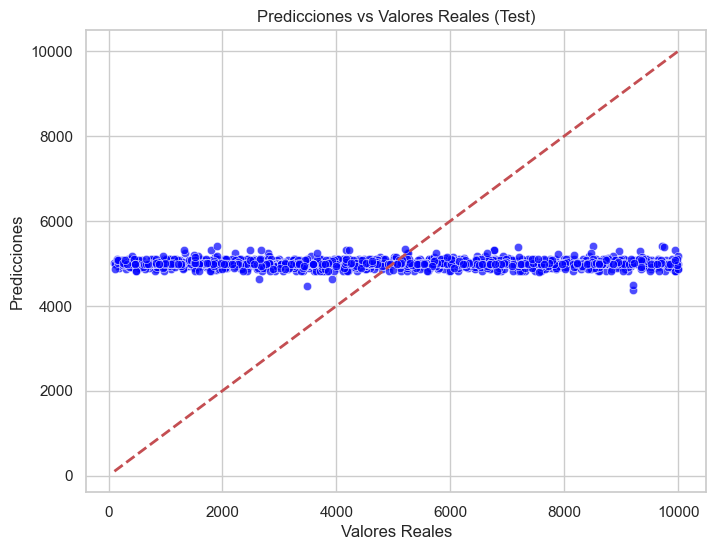

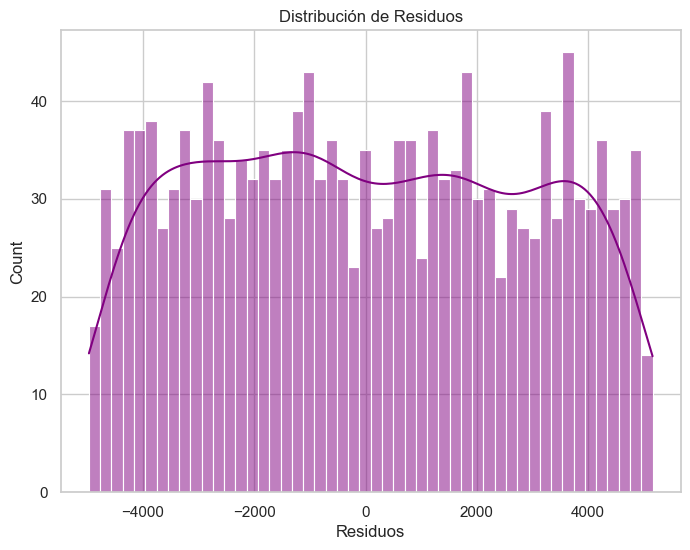

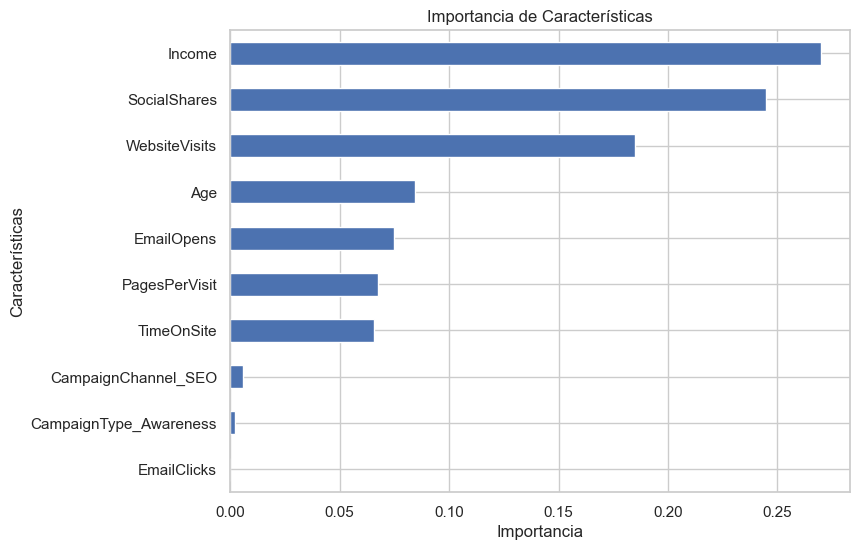

In [178]:
# Importar librerías adicionales
from sklearn.metrics import mean_absolute_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns

# --- Métricas de regresión ---
y_train_pred = best_regressor.predict(X_train_scaled)
y_test_pred = best_regressor.predict(X_test_scaled)

# Calcular métricas
train_mae = mean_absolute_error(y_train, y_train_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

print("\n--- Métricas de Regresión en Train ---")
print(f"MAE: {train_mae:.2f}")
print(f"MSE: {train_mse:.2f}")
print(f"R^2: {train_r2:.2f}")

print("\n--- Métricas de Regresión en Test ---")
print(f"MAE: {test_mae:.2f}")
print(f"MSE: {test_mse:.2f}")
print(f"R^2: {test_r2:.2f}")

# --- Visualizaciones ---

# Distribución de predicciones vs reales
plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_test, y=y_test_pred, alpha=0.7, color="blue")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], '--r', lw=2)
plt.title("Predicciones vs Valores Reales (Test)")
plt.xlabel("Valores Reales")
plt.ylabel("Predicciones")
plt.show()

# Histograma de residuos
residuals = y_test - y_test_pred
plt.figure(figsize=(8, 6))
sns.histplot(residuals, bins=50, kde=True, color="purple")
plt.title("Distribución de Residuos")
plt.xlabel("Residuos")
plt.show()

# Importancia de las características
feature_importances = pd.Series(best_regressor.feature_importances_, index=X_train_data.columns)
feature_importances.nlargest(10).plot(kind='barh', figsize=(8, 6))
plt.title("Importancia de Características")
plt.xlabel("Importancia")
plt.ylabel("Características")
plt.gca().invert_yaxis()
plt.show()


In [179]:
# --- Resumen de gasto de AdSpend ---
original_adspend = df_encoded["AdSpend"].sum()
modified_adspend = df_encoded_ct_cc_ad["AdSpend"].sum()

print("\nGasto total en campañas:")
print(f"Original: {original_adspend:.2f}")
print(f"Modificado: {modified_adspend:.2f}")

# Gasto desglosado por CampaignType
print("\nGasto por CampaignType:")
for campaign in ["Awareness", "Consideration", "Conversion", "Retention"]:
    original_spend = df_encoded.loc[df_encoded[f'CampaignType_{campaign}'] == 1, 'AdSpend'].sum()
    modified_spend = df_encoded_ct_cc_ad.loc[df_encoded_ct_cc_ad[f'CampaignType_{campaign}'] == 1, 'AdSpend'].sum()
    print(f"{campaign}:")
    print(f"  Original: {original_spend:.2f}")
    print(f"  Modificado: {modified_spend:.2f}")

# Gasto desglosado por CampaignChannel
print("\nGasto por CampaignChannel:")
for channel in ["Email", "PPC", "Referral", "SEO", "Social Media"]:
    original_spend = df_encoded.loc[df_encoded[f'CampaignChannel_{channel}'] == 1, 'AdSpend'].sum()
    modified_spend = df_encoded_ct_cc_ad.loc[df_encoded_ct_cc_ad[f'CampaignChannel_{channel}'] == 1, 'AdSpend'].sum()
    print(f"{channel}:")
    print(f"  Original: {original_spend:.2f}")
    print(f"  Modificado: {modified_spend:.2f}")


Gasto total en campañas:
Original: 40007558.64
Modificado: 40007558.64

Gasto por CampaignType:
Awareness:
  Original: 10077845.83
  Modificado: 7958766.56
Consideration:
  Original: 9861273.67
  Modificado: 7990847.39
Conversion:
  Original: 10300076.98
  Modificado: 8324253.03
Retention:
  Original: 9768362.16
  Modificado: 7793823.06

Gasto por CampaignChannel:
Email:
  Original: 7871575.85
  Modificado: 6232134.73
PPC:
  Original: 8199236.98
  Modificado: 6619843.68
Referral:
  Original: 8653518.69
  Modificado: 6875682.37
SEO:
  Original: 7740903.88
  Modificado: 6201240.88
Social Media:
  Original: 7542323.25
  Modificado: 6076201.82


## **Predictor de conversiones en funcion de la nueva configuración de campaña**

Predice si los clientes realizan o no la acción de marketing en la que hemos invertido a tal fin.

## **Comparador gráfico de los resultados**

Muestra el resultado de la campaña original, la modificada manualmente y la automática.

In [180]:
# Cargar pipeline completo
best_pipeline = joblib.load("GradientBoosting_best_pipeline.pkl")
print("\nPipeline cargado: GradientBoosting_best_pipeline.pkl")

# Preparar los datos eliminando columnas no necesarias (sin utilizar Conversion)
X = df_encoded_ct_cc_ad.drop(columns=["Conversion", "CustomerID", 'ConversionRate', 'LoyaltyPoints', 'ClickThroughRate'], errors="ignore")

# Realizar predicciones con el pipeline para todo el DataFrame
df_encoded_ct_cc_ad_c = df_encoded_ct_cc_ad.copy()

# Calcular probabilidades de conversión
y_mod_proba = best_pipeline.predict_proba(X)[:, 1]

# Usar un umbral definido manualmente (ajustable según necesidades)
custom_threshold = 0.5  # Ajustar el umbral
threshold = custom_threshold

# Añadir predicciones como columna Conversion
df_encoded_ct_cc_ad_c["Conversion"] = (y_mod_proba >= threshold).astype(int)


Pipeline cargado: GradientBoosting_best_pipeline.pkl


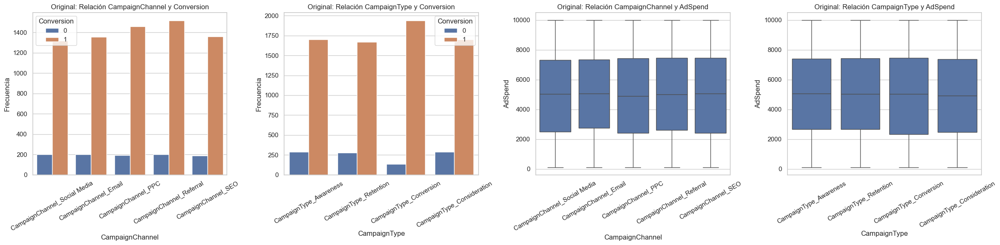

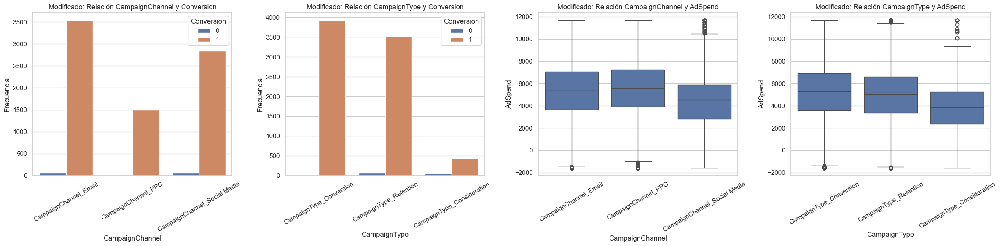

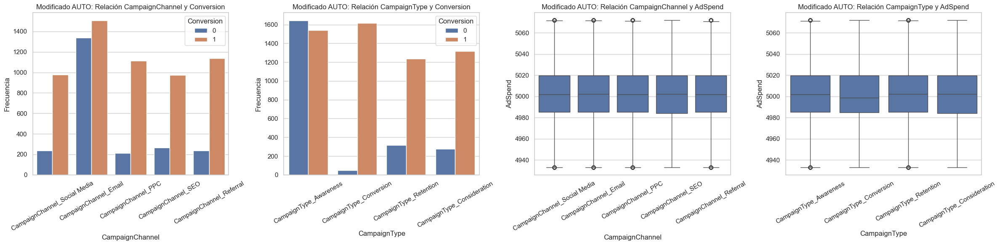

In [181]:
# --- Visualizaciones ---
def create_visualizations(df, title_prefix):
    sns.set(style="whitegrid")
    fig, axes = plt.subplots(1, 4, figsize=(24, 6))  # Una fila con 4 gráficos

    # Gráfico 1: Relación entre CampaignChannel y Conversion
    sns.countplot(data=df, x=df[["CampaignChannel_Email", "CampaignChannel_PPC",
                                 "CampaignChannel_Referral", "CampaignChannel_SEO",
                                 "CampaignChannel_Social Media"]].idxmax(axis=1),
                  hue="Conversion", ax=axes[0])
    axes[0].set_title(f"{title_prefix}: Relación CampaignChannel y Conversion")
    axes[0].set_xlabel("CampaignChannel")
    axes[0].set_ylabel("Frecuencia")
    axes[0].tick_params(axis="x", rotation=30)

    # Gráfico 2: Relación entre CampaignType y Conversion
    sns.countplot(data=df, x=df[["CampaignType_Awareness", "CampaignType_Consideration",
                                 "CampaignType_Conversion", "CampaignType_Retention"]].idxmax(axis=1),
                  hue="Conversion", ax=axes[1])
    axes[1].set_title(f"{title_prefix}: Relación CampaignType y Conversion")
    axes[1].set_xlabel("CampaignType")
    axes[1].set_ylabel("Frecuencia")
    axes[1].tick_params(axis="x", rotation=30)

    # Gráfico 3: Relación entre CampaignChannel y AdSpend
    sns.boxplot(data=df, x=df[["CampaignChannel_Email", "CampaignChannel_PPC",
                               "CampaignChannel_Referral", "CampaignChannel_SEO",
                               "CampaignChannel_Social Media"]].idxmax(axis=1),
                y="AdSpend", ax=axes[2])
    axes[2].set_title(f"{title_prefix}: Relación CampaignChannel y AdSpend")
    axes[2].set_xlabel("CampaignChannel")
    axes[2].set_ylabel("AdSpend")
    axes[2].tick_params(axis="x", rotation=30)

    # Gráfico 4: Relación entre CampaignType y AdSpend
    sns.boxplot(data=df, x=df[["CampaignType_Awareness", "CampaignType_Consideration",
                               "CampaignType_Conversion", "CampaignType_Retention"]].idxmax(axis=1),
                y="AdSpend", ax=axes[3])
    axes[3].set_title(f"{title_prefix}: Relación CampaignType y AdSpend")
    axes[3].set_xlabel("CampaignType")
    axes[3].set_ylabel("AdSpend")
    axes[3].tick_params(axis="x", rotation=30)

    plt.tight_layout()
    plt.show()

# Visualizaciones para datos originales y modificados
create_visualizations(df_encoded, "Original")
create_visualizations(df_encoded_mod, "Modificado")
create_visualizations(df_encoded_ct_cc_ad_c, "Modificado AUTO")

# **EN DESARROLLO**

El selector de tipo de campaña, canal y gasto publicitario por cliente, basado en funciones con estructuras if, else y elif, junto con condiciones específicas, permitirá un enfoque mucho más detallado y personalizado en comparación con el sistema de clusters. Sin embargo, este enfoque será más costoso en términos de actualización y mantenimiento.

In [182]:
'''
# Función para asignar campaña basada en reglas
def asignar_campaña(cliente):
    """
    Asigna un tipo de campaña al cliente en función de sus características.
    
    Parámetros:
    - cliente (Serie): Fila del DataFrame con las características del cliente.
    
    Retorna:
    - String con el tipo de campaña asignada.
    """
    # Reglas para campañas de conversión
    if cliente['ConversionRate'] > 0.15 and cliente['PreviousPurchases'] > 5 and cliente['PagesPerVisit'] > 6:
        return 'Conversion'  # Campaña de conversión para clientes listos para comprar

    # Reglas para campañas de awareness (reconocimiento de marca)
    if cliente['ClickThroughRate'] > 0.25 and cliente['SocialShares'] > 50:
        return 'Awareness'  # Generar conciencia en clientes muy activos en redes sociales

    # Reglas para campañas de consideration (evaluación)
    if cliente['TimeOnSite'] > 10 and cliente['WebsiteVisits'] > 30:
        return 'Consideration'  # Promover conversión para clientes con alta interacción en la web

    # Reglas para campañas de retention (retención)
    if cliente['LoyaltyPoints'] > 3000 and cliente['PreviousPurchases'] > 4:
        return 'Retention'  # Fidelizar clientes con alta lealtad

    # Si no cumple ninguna condición, se asigna una campaña por defecto
    return 'Awareness'

# Función para asignar canal basado en reglas
def asignar_canal(cliente):
    """
    Asigna un canal de campaña al cliente basado en su tipo de campaña y características.
    
    Parámetros:
    - cliente (Serie): Fila del DataFrame con las características del cliente.
    
    Retorna:
    - String con el canal de campaña asignado.
    """
    # Si la campaña asignada es de conversión
    if cliente['CampaignType'] == 'Conversion':
        # Asignar PPC si el gasto en anuncios es alto y las visitas a páginas por visita son altas
        if cliente['AdSpend'] > 6000 and cliente['PagesPerVisit'] > 7:
            return 'PPC'
        # Asignar Email si el cliente tiene muchos clics en correos electrónicos
        if cliente['EmailClicks'] > 5:
            return 'Email'
        # Asignar SEO si el cliente tiene muchas visitas al sitio web
        if cliente['WebsiteVisits'] > 30:
            return 'SEO'

    # Si la campaña asignada es de awareness
    elif cliente['CampaignType'] == 'Awareness':
        # Asignar Social Media si el cliente tiene una alta tasa de clics y mucha interacción social
        if cliente['ClickThroughRate'] > 0.25:
            return 'Social Media'
        # Asignar Referral si el gasto en anuncios es alto
        if cliente['AdSpend'] > 8000:
            return 'Referral'

    # Si la campaña asignada es de consideration
    elif cliente['CampaignType'] == 'Consideration':
        # Asignar SEO si el cliente interactúa mucho con el contenido del sitio web
        if cliente['PagesPerVisit'] > 6:
            return 'SEO'
        # Asignar PPC si el gasto en anuncios es alto
        if cliente['AdSpend'] > 5000:
            return 'PPC'
        # Asignar Email si abre muchos correos electrónicos
        if cliente['EmailOpens'] > 5:
            return 'Email'

    # Si la campaña asignada es de retention
    elif cliente['CampaignType'] == 'Retention':
        # Asignar Email si tiene muchos puntos de lealtad
        if cliente['LoyaltyPoints'] > 4000:
            return 'Email'
        # Asignar Social Media si el cliente interactúa en redes sociales
        if cliente['SocialShares'] > 20:
            return 'Social Media'

    # Si no cumple ninguna condición, se asigna Referral por defecto
    return 'Referral'

# Aplicar las funciones al DataFrame
df['CampaignType'] = df.apply(asignar_campaña, axis=1)  # Asigna campañas basadas en reglas
df['CampaignChannel'] = df.apply(asignar_canal, axis=1)  # Asigna canales basados en las campañas asignadas

# Mostrar las primeras filas del DataFrame modificado para verificar resultados
print(df[['CustomerID', 'CampaignType', 'CampaignChannel']].head())
'''

'\n# Función para asignar campaña basada en reglas\ndef asignar_campaña(cliente):\n    """\n    Asigna un tipo de campaña al cliente en función de sus características.\n    \n    Parámetros:\n    - cliente (Serie): Fila del DataFrame con las características del cliente.\n    \n    Retorna:\n    - String con el tipo de campaña asignada.\n    """\n    # Reglas para campañas de conversión\n    if cliente[\'ConversionRate\'] > 0.15 and cliente[\'PreviousPurchases\'] > 5 and cliente[\'PagesPerVisit\'] > 6:\n        return \'Conversion\'  # Campaña de conversión para clientes listos para comprar\n\n    # Reglas para campañas de awareness (reconocimiento de marca)\n    if cliente[\'ClickThroughRate\'] > 0.25 and cliente[\'SocialShares\'] > 50:\n        return \'Awareness\'  # Generar conciencia en clientes muy activos en redes sociales\n\n    # Reglas para campañas de consideration (evaluación)\n    if cliente[\'TimeOnSite\'] > 10 and cliente[\'WebsiteVisits\'] > 30:\n        return \'Conside